## Process validation data

The script performs validation of the EO-derived time series using in-situ measurements time series for a selected reservoirs (N=~800) from Spain, South Africa, India, USA

In [129]:
%matplotlib inline
import glob
import pathlib
import base64
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import json
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
import datetime
import seaborn as sns
import scipy
import statsmodels.api as sm
import fiona
import os
from tqdm.notebook import tqdm
from sklearn import preprocessing    
import matplotlib.gridspec as gridspec
 

In [70]:
dir_eo = '../data/reservoir-time-series-2021-Q3/time_series_area_raw/'

In [71]:
def read_insitu_india(path):
    df_insitu = pd.read_csv(path, skiprows=2)
    df_insitu.index = pd.to_datetime(df_insitu.Dates)

    df_insitu['t'] = df_insitu.index
    
    return df_insitu

In [72]:
def read_insitu_south_africa(path):
    df_insitu = pd.read_csv(path)
    df_insitu.index = pd.to_datetime(df_insitu.t)

    df_insitu['Dates'] = df_insitu.t
    df_insitu = df_insitu[['Dates', 'storage']]
    
#     df_insitu['t'] = df_insitu.index
    
    return df_insitu

In [73]:
def read_insitu_spain(path):
    df_insitu = pd.read_csv(path)
    df_insitu.index = pd.to_datetime(df_insitu.date)

    df_insitu['Dates'] = df_insitu.date
#     df_insitu = df_insitu[['Dates', 'storage']]
    
    df_insitu['t'] = df_insitu.index
        
    return df_insitu

In [74]:
def read_insitu_usa(path):
    df_insitu = pd.read_csv(path)
    df_insitu.index = pd.to_datetime(df_insitu.date)

    df_insitu['Dates'] = df_insitu.date
#     df_insitu = df_insitu[['Dates', 'storage']]
    
    df_insitu['t'] = df_insitu.index
        
    return df_insitu

In [75]:
def get_settings_india():
    dir_insitu='../data/insitu-data/timeseries/timeseries_India/'
    features = json.loads(open('../data/insitu-data/shp/India/Shapefiles/IndianReservoirs_joined_with_fid.geojson').read())['features']
    features = list(filter(lambda f: os.path.exists(dir_insitu + f['properties']['Reservoir'] + '_insitu.csv'), features))

    return {
        'site': 'India',
#         'insitu_resample': 'M',
        'insitu_resample': 'D',        
#         'shift': 2,
#         'shift': 30,
        'shift': -1, # M
        'dir_insitu': dir_insitu,
        'insitu_var': 'Current Year Level',
        'insitu_var_label': 'Level, $ m $',
        'features': features,
        'reservoir_name_property': 'Reservoir',
        'reservoir_names': [f['properties']['Reservoir'].replace('/', '') for f in features],
        'reservoir_filename_property': 'Reservoir',
        'read_insitu': read_insitu_india
    }

In [76]:
def get_settings_south_africa():
    dir_insitu='../data/insitu-data/timeseries/timeseries_SouthAfrica/'
    
    validation_points = json.loads(open('../data/insitu-data/shp/SouthAfrica/reservoir_centers_with_fid.geojson').read())
    features = validation_points['features']

    features_new = []
    for f in features:
        if not f['properties']['STATION']:
            continue
            
        f['properties']['STATION'] = f['properties']['STATION'][:6]
        features_new.append(f)
        
    features = list(filter(lambda f: os.path.exists(dir_insitu + str(f['properties']['STATION']) + '.csv'), features_new))

    return {
        'site': 'SouthAfrica',
        'insitu_resample': None,
#         'insitu_resample': 'D',
        'shift': 0,
        'dir_insitu': dir_insitu,
        'insitu_var': 'storage',
        'insitu_var_label': 'Storage, $ m^3 $',
        'features': features,
        'reservoir_name_property': 'STATION',
        'reservoir_names': [f['properties']['STATION'].replace('/', '')[:6] for f in features],
        'reservoir_filename_property': 'STATION',
        'read_insitu': read_insitu_south_africa
    }

In [77]:
def get_settings_spain():
    dir_insitu='../data/insitu-data/timeseries/timeseries_Spain/'
    validation_points = json.loads(open('../data/insitu-data/shp/Spain/reservoir_centers_with_fid.geojson').read())
    features = validation_points['features']
    
    features = list(filter(lambda f: os.path.exists(dir_insitu + str(f['properties']['id_2']) + '.csv'), features))
    
#     features = [f for f in features if f['properties']['notes'] not in ['missing', 'insitu-missing', 'insitu-noise']]
    

    return {
        'site': 'Spain',
        'insitu_resample': None,
#         'insitu_resample': 'D',
        'shift': 0,
        'dir_insitu': dir_insitu,
        'insitu_var': 'storage',
        'insitu_var_label': 'Storage, $ m^3 $',
        'features': features,
        'reservoir_name_property': 'name_2',
        'reservoir_names': [f['properties']['name_2'] for f in features],
        'reservoir_filename_property': 'id_2',
        'read_insitu': read_insitu_spain
    }

In [78]:
def get_settings_usa():
    dir_insitu='../data/insitu-data/timeseries/timeseries_USA/'
    validation_points = json.loads(open('../data/insitu-data/shp/USA/reservoir_centers_with_fid.geojson').read())
    features = validation_points['features']
    
    features = list(filter(lambda f: os.path.exists(dir_insitu + str(f['properties']['code_nwis']) + '.csv'), features))    

    return {
        'site': 'USA',
        'insitu_resample': None,
#         'insitu_resample': 'M',
        'shift': 0,
        'dir_insitu': dir_insitu,
        'insitu_var': 'value',
        'insitu_var_label': 'water level or storage',
        'features': features,
        'reservoir_name_property': 'name_nwis',
        'reservoir_names': [f['properties']['name_nwis'] for f in features],
        'reservoir_filename_property': 'code_nwis',
        'read_insitu': read_insitu_usa
    }

In [79]:
def get_outliers(x, y):
#     x = preprocessing.scale(x)
#     y = preprocessing.scale(y)

    xmin = x.min()
    xmax = x.max()
    ymin = y.min()
    ymax = y.max()

    mx = 0.1 * (xmax - xmin)
    my = 0.1 * (ymax - ymin)
    xmin = xmin - mx
    ymin = ymin - my
    xmax = xmax + mx
    ymax = ymax + my

    # Perform a kernel density estimate on the data:

    X, Y = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    positions = np.vstack([X.ravel(), Y.ravel()])
    values = np.vstack([x, y])
    
    kernel = stats.gaussian_kde(values)

    density = kernel([x, y])
    
    # filter on Mahalanobis distance
    th = np.percentile(density, 30)
    
    return  density <= th  
    

In [80]:
# remove large gradients
def remove_large_gradients(df, th):
    df['water_area_filled_grad'] = df.area.diff()    
    df = df[pd.notnull(df.water_area_filled_grad)]
    grad_th = np.percentile(np.abs(df.water_area_filled_grad.to_numpy()), th)
    df = df[np.abs(df.water_area_filled_grad) < grad_th]

    return df


In [81]:
from sklearn import gaussian_process
from sklearn.gaussian_process.kernels import Matern, WhiteKernel, ConstantKernel, ExpSineSquared

def get_interpolated_gp(x, y):
    x_min = np.min(x)
    y_min = np.min(y)
    x_range = np.max(x) - x_min
    y_range = np.max(y) - y_min
    x = (x - x_min) / x_range
    y = (y - y_min) / y_range
    
#     x_mean = np.median(x)
#     y_mean = np.median(y)
#     x_std = np.std(x)
#     y_std = np.std(y)
#     x = (x - x_mean) / x_std
#     y = (y - y_mean) / y_std
    
    
    ms_in_year = 365 * 24 * 60 * 60 * 1000
    
#     periodicity = ms_in_year / x_std
    periodicity = ms_in_year / x_range
    
#     kernel = ConstantKernel() + Matern(length_scale=1, nu=3/2) + WhiteKernel(noise_level=0.1)
    kernel = ExpSineSquared(length_scale=2, periodicity=periodicity, 
                            length_scale_bounds=(1e-15, 100), periodicity_bounds=(1e-15, 100)) \
        + Matern(length_scale=2, nu=1.5) \
        + WhiteKernel(noise_level=0.25) 
    
#     kernel = Matern(length_scale=0.01, nu=1) + WhiteKernel(noise_level=0.001)
    
    gp = gaussian_process.GaussianProcessRegressor(kernel=kernel, alpha=0.0001)
         
#     gp = gaussian_process.GaussianProcessRegressor(alpha=1e-10, copy_X_train=True, kernel=kernel, 
#                                                    n_restarts_optimizer=0, normalize_y=False, 
#                                                    optimizer='fmin_l_bfgs_b', random_state=None)
    
    gp = gp.fit(np.array(x).reshape(-1, 1), y)
    
    x_pred = np.linspace(x.min(), x.max()).reshape(-1,1)
    y_pred, sigma = gp.predict(x_pred, return_std=True)
    
#     return [x_pred * x_std + x_mean, y_pred * y_std + y_mean, sigma * y_std]
    return [x_pred * x_range + x_min, y_pred * y_range + y_min, sigma * y_range]


In [82]:
def fit_gp(df):
    df = remove_large_gradients(df, 80)
    df = remove_large_gradients(df, 99)

    # take top 90% (eliminate underfilling due to lower trust in water occurrence)
    df = df.resample('M').max() # .apply(lambda x: x.quantile(0.9))
    
    df = df.dropna()
    
    count = 50
    count_gap = 10

    
    
    x_all = df.time_ms.to_numpy()
    y_all = df.area.to_numpy()

    counts = list(range(int(len(x_all) / count) + 1))
    
    df_new = None

    for c in counts:
        c1 = (c + 1) * count
        c2 = c * count - count_gap

        c_max = len(x_all)

        if(c1 > c_max):
            c1 = c_max
            c2 = c_max - count - count_gap

        if c == 0:
            x = x_all[-c1:]
            y = y_all[-c1:]
        else:
            x = x_all[-c1:-c2]
            y = y_all[-c1:-c2]

        x_pred, y_pred, sigma = get_interpolated_gp(x, y)
        x_pred = np.transpose(x_pred)[0]

        df_pred = pd.DataFrame(list(zip(x_pred, y_pred)), columns=['x', 'y'])

        if c == counts[0]:
            df_new = df_pred
        else:
            df_new = pd.concat([df_new, df_pred])

    df_new = df_new.groupby('x').mean()

    df_new['time'] = pd.to_datetime(df_new.index, unit='ms')

    df_new = df_new.set_index('time')
    df_new = df_new.resample('M').max().interpolate('akima')

    df = df.shift(-1)
    
    df_new['area'] = df_new.y
    
    return df_new


In [83]:
from scipy import stats
def r2(x, y):
    return stats.pearsonr(x, y)[0] ** 2

In [85]:
def remove_outliers_moving_window(df, column, window=20, th_std=3):
    '''Filter outliers, adapted from https://stackoverflow.com/questions/46964363/filtering-out-outliers-in-pandas-dataframe-with-rolling-median'''
    df['median']= df[column].rolling(window).median()
    df['std'] = df[column].rolling(window).std()

    #filter setup
    df = df[(df[column] <= df['median'] + th_std * df['std']) & (df[column] >= df['median'] - th_std * df['std'])]
    
    return df


In [86]:
def clean_data(df_eo, step='M', skip_missings=True, min_missings_step=12):
    d = df_eo
#     d['area'] = d.water_area_filled
#     d = d[['area']]

    d = d[d.water_area_filled_fraction < 0.2].copy()

    d = remove_outliers_moving_window(d, 'quality_score', 10, th_std=2).copy()

    # round to days
    d.index = d.index.round('D')

#     d = remove_large_gradients(d, 90)
    d = remove_large_gradients(d, 99)

    # take top 90% (eliminate underfilling due to lower trust in water occurrence)
    d = d.resample(step).apply(lambda x: x.quantile(0.90))

    # create mask
    if skip_missings:
        mask = d.copy()
        grp = ((mask.notnull() != mask.shift().notnull()).cumsum())
        grp['ones'] = 1
        mask['area'] = (grp.groupby('area')['ones'].transform('count') < min_missings_step) | d['area'].notnull()

    # smoothen
    d = d.interpolate(method='pchip')
    
    if settings['insitu_resample'] != None:
         d = d.shift(settings['shift'])
#         d = d.shift(-1)

    # apply missing values mask (>6 months)
    if skip_missings:
        d[mask.area == False] = None

    return d

In [87]:
def fit2(df):
    return clean_data(df)

In [88]:
def get_feature_data(feature):
    reservoir_name = str(feature['properties'][settings['reservoir_filename_property']]).replace('/', '')
    
    path_eo = dir_eo + str(feature['properties']['fid']).zfill(7) + '.csv'
    path_insitu = settings['dir_insitu'] + reservoir_name + '.csv'
    
    df_eo_ = pd.read_csv(path_eo)
    
    # print(df_eo.info())
    
    df_eo = pd.DataFrame({ 'time': df_eo_['water_area_time'].values, 
                        'area': df_eo_['water_area_filled'].values,
                         'quality_score': df_eo_['quality_score'].values,
                          'scale': df_eo_['scale'].values,
                        'water_area_filled_fraction': df_eo_['water_area_filled_fraction'].values})
    
    df_insitu = settings['read_insitu'](path_insitu)
    
    
#     df_eo = pd.read_csv('D:/1.csv')
#     df_eo.time = pd.to_datetime(df_eo.time, format='%Y-%m-%d')
    
    df_eo['time_ms'] = df_eo.time

    df_eo.time = pd.to_datetime(df_eo.time, unit='ms')

    df_eo.area = df_eo.area / 1000000

    date_start = '1985-01-01'
#     date_start = '2000-01-01'
    date_stop = '2018-08-01'
    

    df_insitu_original = df_insitu
    
    df_insitu = df_insitu[(df_insitu.index >= date_start) & (df_insitu.index < date_stop)]
    
    if settings['insitu_resample'] != None:
        df_insitu = df_insitu.resample(settings['insitu_resample']).interpolate('linear')

#     if settings['shift']:
#         df_insitu = df_insitu.shift(settings['shift'])
    
    df_eo.index = df_eo.time
    
    df_eo_original = df_eo
    
    # round to days
    df_eo.index = df_eo.index.round('D')

#     # remove large gradients
#     df_eo['water_area_filled_grad'] = df_eo.area.diff()    
#     df_eo = df_eo[pd.notnull(df_eo.water_area_filled_grad)]
#     grad_th = np.percentile(np.abs(df_eo.water_area_filled_grad.to_numpy()), 70)
#     df_eo = df_eo[np.abs(df_eo.water_area_filled_grad) < grad_th]

#     # take top 90% (eliminate underfilling due to lower trust in water occurrence)
#     df_eo = df_eo.resample('M').apply(lambda x: x.quantile(0.9))
    
#     # smoothen using akima
#     df_eo = df_eo.resample('M').max().interpolate(method='akima')
#     df_eo = df_eo.shift(-1)

#     df_eo = remove_large_gradients(df_eo, 75)
#     df_eo = remove_large_gradients(df_eo, 90)

    if settings['insitu_resample'] != None:
        df_eo = fit2(df_eo)
        
#         df_insitu = df_insitu.shift(settings['shift'])
        

    #     df_eo = fit_gp(df_eo)

    if settings['insitu_resample'] != None:
        # generate daily
        df_eo = df_eo.resample('D').interpolate('linear')
    
#     df_eo = df_eo.resample('3W').max().resample('D') \
#         .interpolate('linear')

    
    df_eo = df_eo[(df_eo.index >= date_start) & (df_eo.index < date_stop)].copy()
    df_eo['t'] = df_eo.index

    df_merged = pd.merge(df_eo, df_insitu, how='left', on='t')
    
    df_merged = df_merged[pd.notnull(df_merged.Dates)]
    
    if len(df_merged) == 0:
        return [None, None, None, None, None, None]
    
#     df_merged.to_csv(dir_insitu + reservoir_name +'_merged.csv')
    
    df_merged = df_merged[[settings['insitu_var'], 'area']]
    
    df_merged = df_merged.dropna()
    
    if np.max(df_merged[settings['insitu_var']]) == np.min(df_merged[settings['insitu_var']]) \
        or np.max(df_merged.area.values) == np.min(df_merged.area.values):
        df_merged['outlier'] = 0
            
    else:
        outliers = get_outliers(df_merged[settings['insitu_var']], df_merged.area)
        df_merged['outlier'] = outliers
        
    return [df_merged, df_eo, df_insitu, df_eo_original, df_insitu_original]

In [89]:
class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):
        self.sg.fig.set_size_inches(self.fig.get_size_inches())

In [90]:
year_start = 1985
# year_start = 2010

def plot(reservoir_index, feature, show_plot=True, write_files=True):
    plt.close('all')
    
    df_merged, df_eo, df_insitu, df_eo_original, df_insitu_original = get_feature_data(feature)
    
    reservoir_id = str(feature['properties'][settings['reservoir_filename_property']]).replace('/', '')
    reservoir_name = feature['properties'][settings['reservoir_name_property']]
    country = settings['site']
    
    if not isinstance(df_merged, pd.DataFrame):
        return
    
    plt.ioff()

    df_eo_original = df_eo_original[pd.notnull(df_eo_original.time)]
    
    if len(df_merged[settings['insitu_var']]) == 0:
        return
    
    if show_plot:
        # plot EO
        fig = plt.figure(figsize = (15, 5))
        specs = fig.add_gridspec(ncols=2, nrows=3, width_ratios=[2, 1], height_ratios=[0.05, 1, 1])
        ax_eo = fig.add_subplot(specs[1, 0])
        ax_insitu = fig.add_subplot(specs[2, 0], sharex = ax_eo)
        
        ax_eo.grid(b=True, which='major', color='#666666', linestyle='-', alpha=0.5)
        ax_eo.minorticks_on()
        ax_eo.grid(b=True, which='minor', color='#999999', linestyle='-', alpha=0.1)
        
        plt.suptitle(f"Surface water area (EO) comparison with in-situ data, {country}, {reservoir_name}, id={reservoir_id}")

#         ax_eo.plot(df_eo.t, df_eo.area, color='steelblue', marker='.', markersize=4, lw=0.5, alpha=0.7)
        ax_eo.plot(df_eo_original.time ,df_eo_original.area, color='steelblue', marker='.', markersize=4, lw=0.5, alpha=0.7)
        
        ax_eo.set_xlim([datetime.date(year_start, 1, 1), datetime.date(2019, 1, 1)])
        ax_eo.set_ylabel('Area, $ km^2 $')

      
        # plot in-situ
        df_insitu_original = df_insitu_original[pd.notnull(df_insitu_original.Dates)]

        ax_insitu.grid(b=True, which='major', color='#666666', linestyle='-', alpha=0.5)
        ax_insitu.minorticks_on()
        ax_insitu.grid(b=True, which='minor', color='#999999', linestyle='-', alpha=0.1)
        
        dd = df_insitu[pd.notnull(df_insitu.Dates)]

#         ax_eo.twinx().plot(dd.index ,dd[settings['insitu_var']], color='red', marker='.', markersize=4, alpha=0.3, lw=0.5)
        
        ax_insitu.plot(dd.index ,dd[settings['insitu_var']], color='black', marker='.', markersize=4, alpha=0.7, lw=0.5)
#         ax.plot(df_insitu_original.index ,df_insitu_original[settings['insitu_var']], 'r.', markersize=3, alpha=0.4)
        ax_insitu.set_xlim([datetime.date(year_start, 1, 1), datetime.date(2019, 1, 1)])
        ax_insitu.set_ylabel(settings['insitu_var_label'])
        

        no = df_merged[df_merged.outlier == 0] # no - not outliers

    #     fig, ax = plt.subplots(figsize=(10, 10))

     
        g = sns.jointplot(x=settings['insitu_var'], y='area', data=no, kind="reg", lowess=True, line_kws={ 'lw': 2, 'color': 'black' }, scatter_kws={ 's': 6, 'alpha': 0.7 }) \
            .plot_joint(sns.kdeplot, zorder=0, n_levels=10, shade=True, cmap="Blues", alpha=0.3)

        o = df_merged[df_merged.outlier > 0]
        g.ax_joint.scatter(o[settings['insitu_var']], o.area, color='red', alpha=0.3, s=6)
        g.ax_joint.set_xlabel(settings['insitu_var_label'])
        g.ax_joint.set_ylabel('Area, $ km^2 $')


        # adjust min/max
        xmin = no[settings['insitu_var']].min()
        xmax = no[settings['insitu_var']].max()
        ymin = no.area.min()
        ymax = no.area.max()

        mx = 0.25 * (xmax - xmin)
        my = 0.25 * (ymax - ymin)
        xmin = xmin - mx
        ymin = ymin - my
        xmax = xmax + mx
        ymax = ymax + my

        # plt.ylim(ymin, ymax)
        # plt.xlim(xmin, xmax)

        # plot LOWESS fit metrics
        df = no.sort_values(settings['insitu_var'])
        z = sm.nonparametric.lowess(df.area, df[settings['insitu_var']])
        df['z'] = z[:, 1]
        resid = (df.z - df.area)**2
        ss_resid = np.sum(resid)
        ss_total = np.sum((df.area - np.mean(df.area))**2)
        ss_resid, ss_total
        r2_fit = 1 - (ss_resid / ss_total)
        rmse = np.sqrt(np.mean(resid))

        r2_str = "{:.2f} $\ $".format(stats.pearsonr(df[settings['insitu_var']], df.area)[0] ** 2)
        r2_fit_str = "{:.2f} $\ $".format(r2_fit)
        rmse_str = "{:.2f} $ km^2 $".format(rmse)
        area_str = "{:.2f} $ km^2 $".format(df_eo['area'].mean() / 1000000)
        scale_str = "{:.2f} $ m $".format(df_eo['scale'].mean())

    #     g.ax_joint.text(0.02, 0.98, "$ R^2: $" + r2_str, transform=g.ax_joint.transAxes)
        g.ax_joint.text(0.02, 0.98, "$ R^2= $ " + r2_fit_str, transform=g.ax_joint.transAxes)
        g.ax_joint.text(0.02, 0.93, "$ RMSE= $" + rmse_str, transform=g.ax_joint.transAxes)
    #     g.ax_joint.text(0.02, 0.85, "$ Area= $" + area_str, transform=g.ax_joint.transAxes)
    #     g.ax_joint.text(0.02, 0.85, "$ Scale= $" + scale_str, transform=g.ax_joint.transAxes)
 

        SeabornFig2Grid(g, fig, specs[:, 1])
#         fig.axes[2].set_position([0.6, 0.12, 0.3, 0.75])
    
    plt.tight_layout()

    if write_files:
        plt.savefig(settings['dir_insitu'] + reservoir_id + '_validation.png')
#         plt.savefig(settings['dir_insitu'] + reservoir_id + '_validation.pdf')

        df_eo.to_csv(settings['dir_insitu'] + reservoir_id + '_eo.csv')
        df_insitu.to_csv(settings['dir_insitu'] + reservoir_id + '_insitu.csv')

    plt.show()

### Here we select a dataset

Only a single dataset is supported for now

In [93]:
# settings = get_settings_india()
# settings = get_settings_south_africa()
settings = get_settings_spain()
# settings = get_settings_usa()

### Interactive plot

In [94]:
reservoir_names_sorted = settings['reservoir_names'].copy()
reservoir_names_sorted.sort()

@interact
def show_reservoirs(reservoir_name=reservoir_names_sorted):
#     print(settings['features'][settings['reservoir_names'].index(reservoir_name)])
    reservoir_index = settings['reservoir_names'].index(reservoir_name)
    plot(reservoir_index, settings['features'][reservoir_index], True, True)

interactive(children=(Dropdown(description='reservoir_name', options=('ACE�A', 'AGRIO', 'AGUAS LIMPIAS (SISTEM…

### Derive statistics for all reservoirs

In [96]:
# compute mean(area) ~ R2

def get_reservoir_stat(feature, r2='pearson'):
    try:
        df_merged, df_eo, df_insitu, df_eo_original, df_insitu_original = get_feature_data(feature)
        
        name = str(feature['properties'][settings['reservoir_filename_property']]).replace('/', '')
        
        feature['properties']['filename'] = name
    
        r2 = stats.pearsonr(df_merged[settings['insitu_var']], df_merged.area)[0] ** 2

        no = df_merged[df_merged.outlier == 0] # no outliers

        # plot LOWESS fit metrics
        df = no.sort_values(settings['insitu_var'])
        z = sm.nonparametric.lowess(df.area, df[settings['insitu_var']])
        
        df['z'] = z[:, 1]
        
        x = df['z']
        y = df['area']
        
        if r2 == 'spearman':
            order = np.argsort(x)
            x = np.argsort(order)
            order = np.argsort(y)
            y = np.argsort(order)
            
        resid = (x - y)**2
        ss_resid = np.sum(resid)
        ss_total = np.sum((y - np.mean(y))**2)
        ss_resid, ss_total
        r2_fit = 1 - (ss_resid / ss_total)
        rmse = np.sqrt(np.mean(resid))
        
        count = len(df['z'])

        return [df_eo.area.mean(), r2_fit, r2, count, feature]
    except:
        return [-100, 0, 0, 0, feature]


In [97]:
stat = [get_reservoir_stat(feature) for feature in tqdm(settings['features'])]

 94%|███████████████████████████████████████████████████████████████████████████▏    | 294/313 [00:41<00:02,  7.88it/s]c:\opt\miniconda3\envs\work\lib\site-packages\statsmodels\nonparametric\smoothers_lowess.py:165: RuntimeWarning: invalid value encountered in true_divide
  res = _lowess(y, x, frac=frac, it=it, delta=delta)
100%|████████████████████████████████████████████████████████████████████████████████| 313/313 [00:43<00:00,  7.16it/s]


In [98]:
# Write R2 into GeoJSON (per site)

# TODO: refactor to 1 fn

def write_stat_spain():
    reservoir_centers = json.loads(open(r'..\data\insitu-data\shp\Spain\reservoir_centers_with_fid.geojson').read())

    centers_new = []

    for i, f in enumerate(settings['features']):
        fid = f['properties']['fid']

        f_center = list(filter(lambda c: c['properties']['fid'] == fid, reservoir_centers['features']))[0]
        
        s = stat[i]
        
        if f_center['properties']['id_2'] != s[4]['properties']['id_2']:
            continue

        f_center['properties']['r2_fit'] = s[1]
        f_center['properties']['r2'] = s[2]
        
        f_center['properties']['filename'] = str(f['properties'][settings['reservoir_filename_property']]).replace('/', '')
        f_center['properties']['site'] = settings['site']
        f_center['properties']['insitu_var'] = settings['insitu_var']
        f_center['properties']['insitu_var_label'] = settings['insitu_var_label']

        if stat[i][0] == -100:
            continue

        centers_new.append(f_center)

    reservoir_centers['features'] = centers_new

    with open(r'..\data\insitu-data\shp\Spain\reservoir_centers_with_stats.geojson', 'w') as out:
        out.write(json.dumps(reservoir_centers))

def write_stat_south_africa():
    reservoir_centers = json.loads(open(r'..\data\insitu-data\shp\SouthAfrica\reservoir_centers_with_fid.geojson').read())

    centers_new = []

    for i, f in enumerate(settings['features']):
        fid = f['properties']['fid']

        f_center = list(filter(lambda c: c['properties']['fid'] == fid, reservoir_centers['features']))[0]

        f_center['properties']['r2_fit'] = stat[i][1]
        f_center['properties']['r2'] = stat[i][2]
        
        f_center['properties']['filename'] = str(f['properties'][settings['reservoir_filename_property']]).replace('/', '')
        f_center['properties']['site'] = settings['site']
        f_center['properties']['insitu_var'] = settings['insitu_var']
        f_center['properties']['insitu_var_label'] = settings['insitu_var_label']
        
        if stat[i][0] == -100:
            continue

        centers_new.append(f_center)

    reservoir_centers['features'] = centers_new

    with open(r'..\data\insitu-data\shp\SouthAfrica\reservoir_centers_with_stats.geojson', 'w') as out:
        out.write(json.dumps(reservoir_centers))

def write_stat_india():
    reservoir_centers = json.loads(open(r'..\data\insitu-data\shp\India\Shapefiles\IndianReservoirs_joined_with_fid.geojson').read())

    centers_new = []

    for i, f in enumerate(settings['features']):
        fid = f['properties']['fid']
        
        f_center = list(filter(lambda c: c['properties']['fid'] == fid, reservoir_centers['features']))[0]

        f_center['properties']['r2_fit'] = stat[i][1]
        f_center['properties']['r2'] = stat[i][2]

        f_center['properties']['filename'] = str(f['properties'][settings['reservoir_filename_property']]).replace('/', '')
        f_center['properties']['site'] = settings['site']
        f_center['properties']['insitu_var'] = settings['insitu_var']
        f_center['properties']['insitu_var_label'] = settings['insitu_var_label']

        if stat[i][0] == -100:
            continue

        centers_new.append(f_center)

    reservoir_centers['features'] = centers_new

    with open(r'..\data\insitu-data\shp\India\reservoir_centers_with_stats.geojson', 'w') as out:
        out.write(json.dumps(reservoir_centers))

def write_stat_usa():
    reservoir_centers = json.loads(open(r'..\data\insitu-data\shp\USA\reservoir_centers_with_fid.geojson').read())

    centers_new = []

    for i, f in enumerate(settings['features']):
        fid = f['properties']['fid']
        
        f_center = list(filter(lambda c: c['properties']['fid'] == fid, reservoir_centers['features']))[0]
        
        f_center['properties']['r2_fit'] = stat[i][1]
        f_center['properties']['r2'] = stat[i][2]

        f_center['properties']['filename'] = str(f['properties'][settings['reservoir_filename_property']]).replace('/', '')
        f_center['properties']['site'] = settings['site']
        f_center['properties']['insitu_var'] = settings['insitu_var']
        f_center['properties']['insitu_var_label'] = settings['insitu_var_label']
        
        if stat[i][0] == -100:
            continue

        centers_new.append(f_center)

    reservoir_centers['features'] = centers_new

    with open(r'..\data\insitu-data\shp\USA\reservoir_centers_with_stats.geojson', 'w') as out:
        out.write(json.dumps(reservoir_centers))
        
write_stat = {}
write_stat['India'] = write_stat_india
write_stat['SouthAfrica'] = write_stat_south_africa
write_stat['Spain'] = write_stat_spain
write_stat['USA'] = write_stat_usa

write_stat[settings['site']]()

In [99]:
df = pd.DataFrame(data=stat, columns=['area', 'r2_fit', 'r2', 'count', 'feature'])
df = df[df.area != -100]
df = df.dropna()
df.head()

,area,r2_fit,r2,count,feature
0,23.559186,0.987401,0.927786,676,"{'type': 'Feature', 'properties': {'filename':..."
1,45.011178,0.965435,0.267186,359,"{'type': 'Feature', 'properties': {'filename':..."
2,37.573962,0.223850,0.028122,1398,"{'type': 'Feature', 'properties': {'filename':..."
3,26.819153,0.995779,0.959938,617,"{'type': 'Feature', 'properties': {'filename':..."
4,4.550000,0.991895,0.939065,914,"{'type': 'Feature', 'properties': {'filename':..."


In [100]:
mode, median, mean = (df.r2_fit.mode()[0], df.r2_fit.median(), np.round(df.r2_fit.mean(), 2))
print('mode: ', mode)
print('median: ', median)
print('mean: ', mean)

mode:  -0.09904575619580691
median:  0.9302359701165127
mean:  0.74


c:\opt\miniconda3\envs\work\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
c:\opt\miniconda3\envs\work\lib\site-packages\seaborn\distributions.py:1718: UserWarning: `shade_lowest` is now deprecated in favor of `thresh`. Setting `thresh=0.05`, but please update your code.
  warnings.warn(msg, UserWarning)
c:\opt\miniconda3\envs\work\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


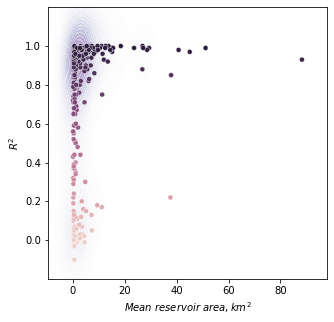

In [101]:
fig, ax = plt.subplots(figsize=(5, 5))

df = df.round(2)

sns.kdeplot(df.area, df.r2_fit, ax=ax, cmap='Purples', shade=True, shade_lowest=False, n_levels=20, cut=3, zorder=1, alpha=0.3, legend='full')

sns.scatterplot(df.area, df.r2_fit, ax=ax, legend=False, hue=df.r2_fit, hue_norm=(0, 1), zorder=2, s=25, alpha=1)

ax.set_ylim(-0.2, 1.2)
ax.set_xlabel('$ Mean\ reservoir\ area, km^2 $')
ax.set_ylabel('$ R^2 $')

if settings['site'] == 'SouthAfrica':
    ax.set_xlim(-5, 50) # skipa large

# if settings['site'] == 'Spain':
#     ax.set_xlim(-1, 10) # skipa large

if settings['site'] == 'USA':
    ax.set_xlim(-10, 200) # skipa large

# ax.set_xscale('log')

ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])

plt.show()

c:\opt\miniconda3\envs\work\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


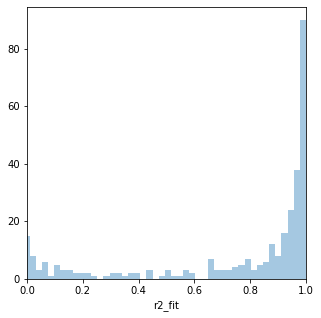

In [102]:
fig, ax = plt.subplots(figsize=(5, 5))

sns.distplot(df.r2_fit, bins=50, kde=False, ax=ax)
plt.xlim(0, 1)

plt.show()

  0%|                                                                                          | 0/313 [00:00<?, ?it/s]

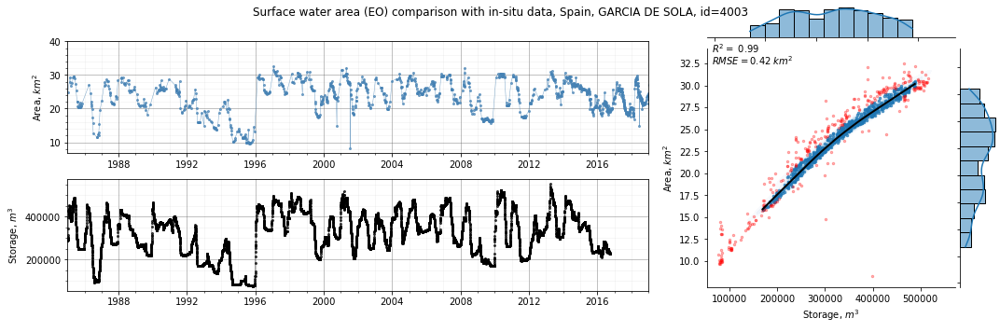

  0%|▎                                                                                 | 1/313 [00:02<14:52,  2.86s/it]

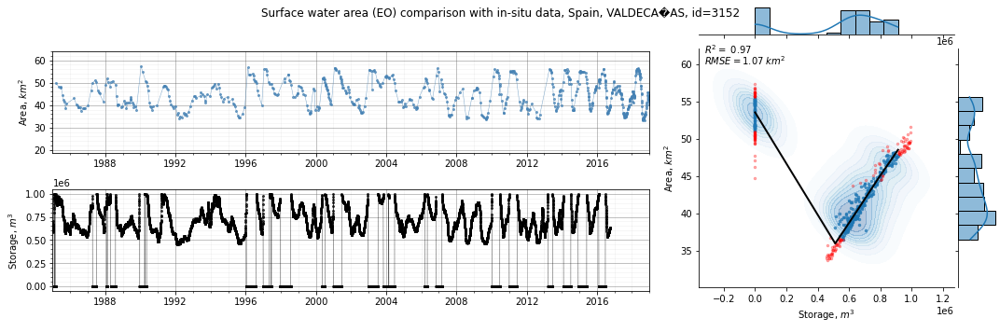

  1%|▌                                                                                 | 2/313 [00:05<13:07,  2.53s/it]

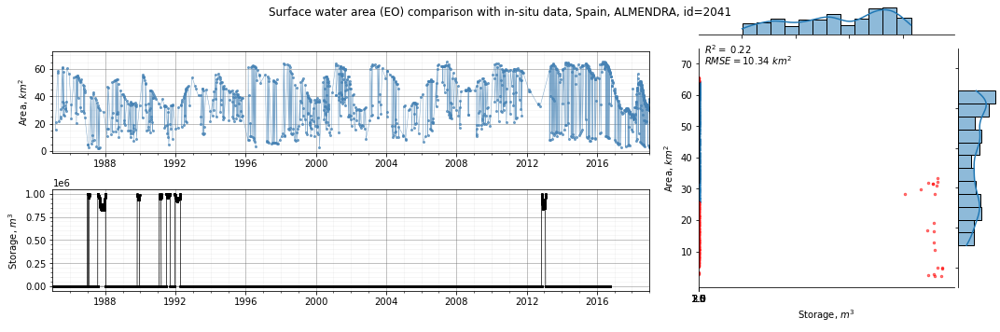

  1%|▊                                                                                 | 3/313 [00:08<15:36,  3.02s/it]

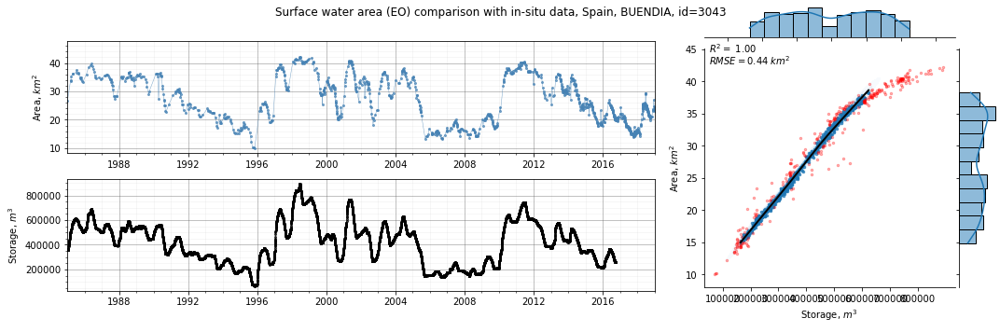

  1%|█                                                                                 | 4/313 [00:12<16:43,  3.25s/it]

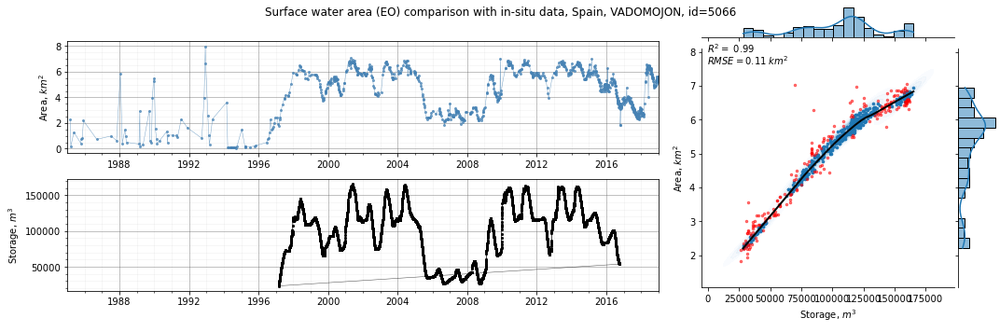

  2%|█▎                                                                                | 5/313 [00:15<17:00,  3.31s/it]

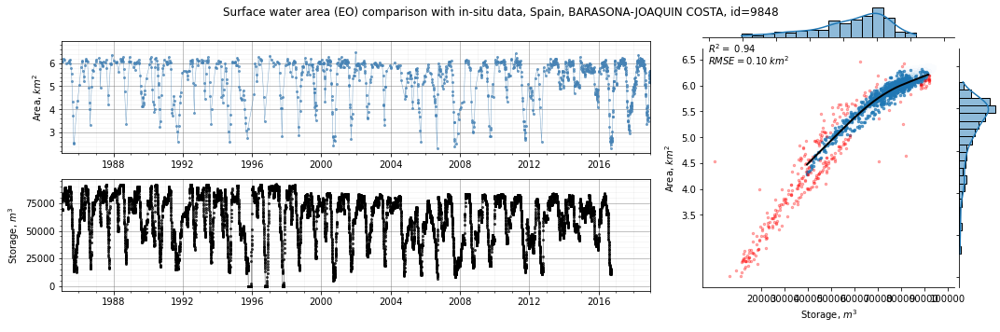

  2%|█▌                                                                                | 6/313 [00:19<16:54,  3.31s/it]

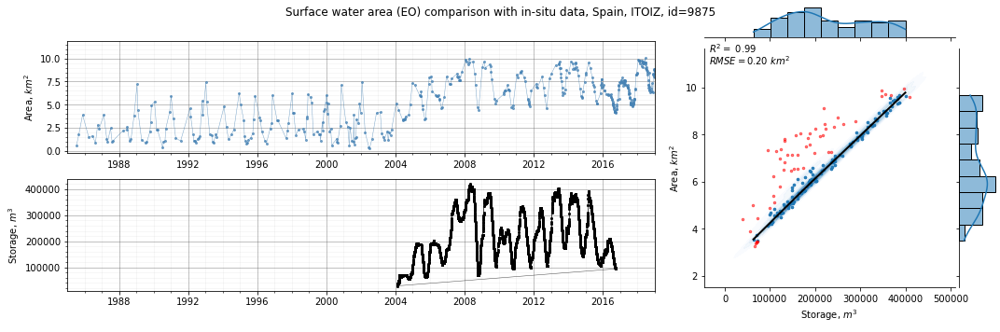

  2%|█▊                                                                                | 7/313 [00:21<15:20,  3.01s/it]

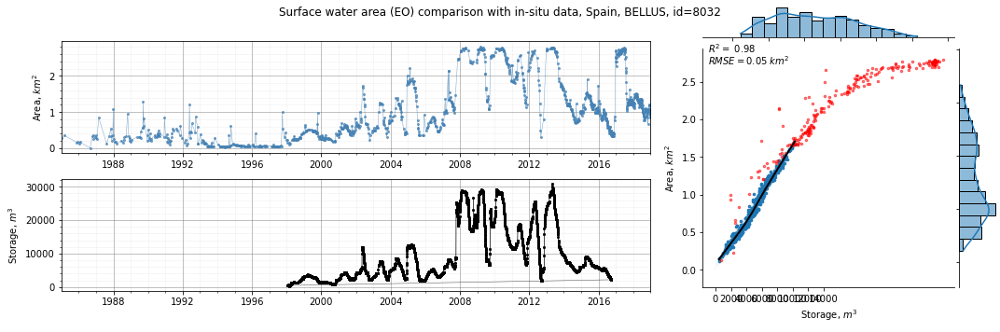

  3%|██                                                                                | 8/313 [00:25<16:35,  3.26s/it]

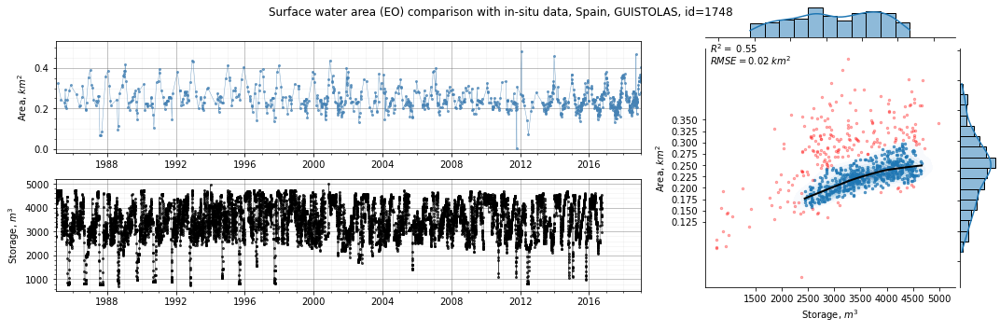

  3%|██▎                                                                               | 9/313 [00:27<15:34,  3.07s/it]

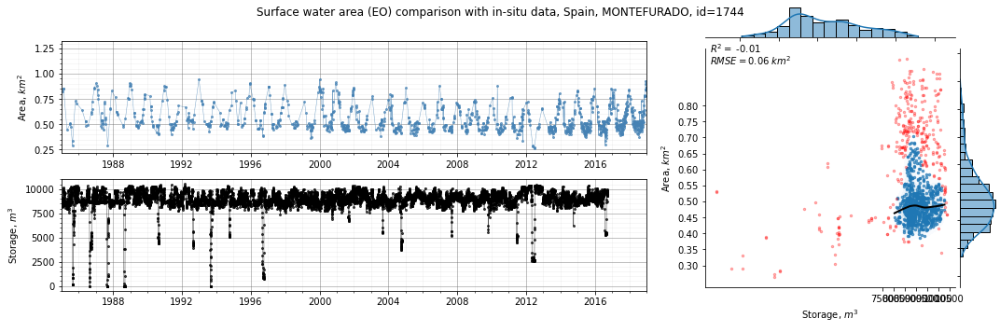

  3%|██▌                                                                              | 10/313 [00:30<15:28,  3.06s/it]

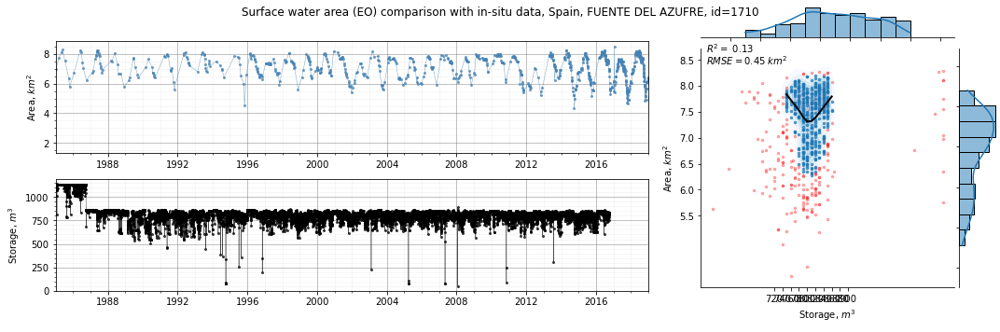

  4%|██▊                                                                              | 11/313 [00:33<14:27,  2.87s/it]

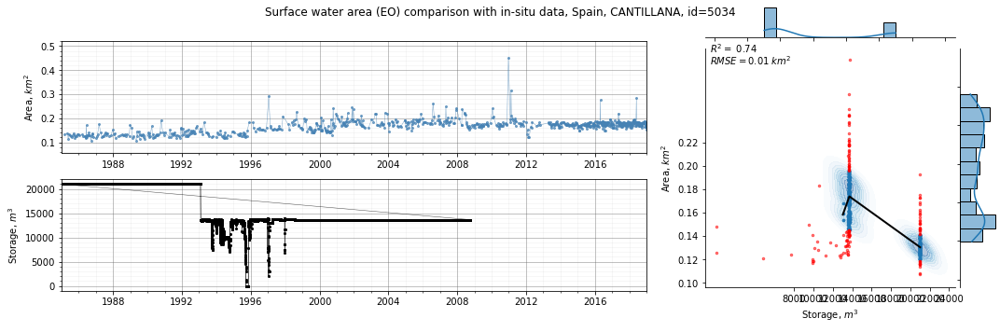

  4%|███                                                                              | 12/313 [00:36<14:06,  2.81s/it]

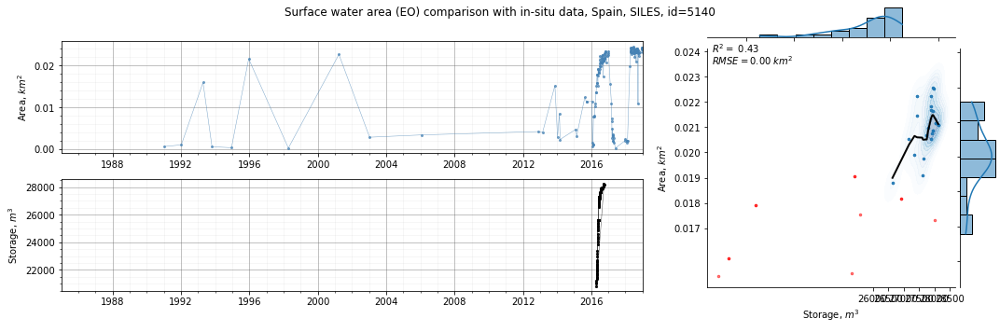

  4%|███▎                                                                             | 13/313 [00:37<12:34,  2.52s/it]

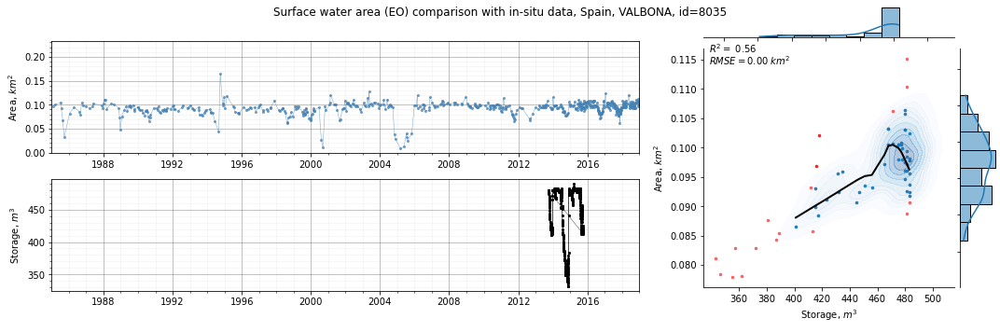

  4%|███▌                                                                             | 14/313 [00:40<12:04,  2.42s/it]

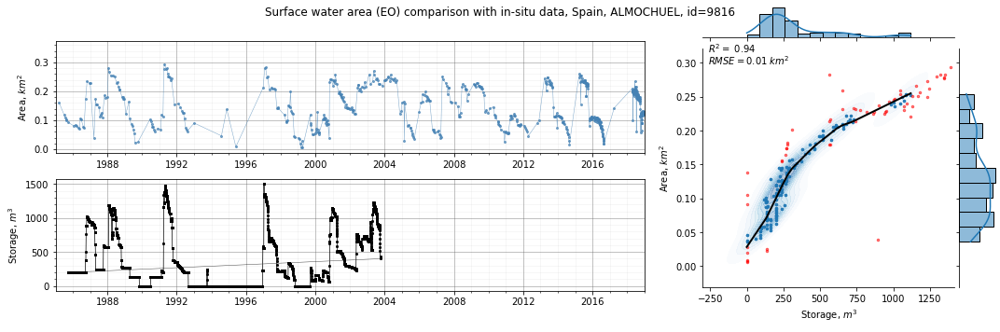

  5%|███▉                                                                             | 15/313 [00:42<12:10,  2.45s/it]

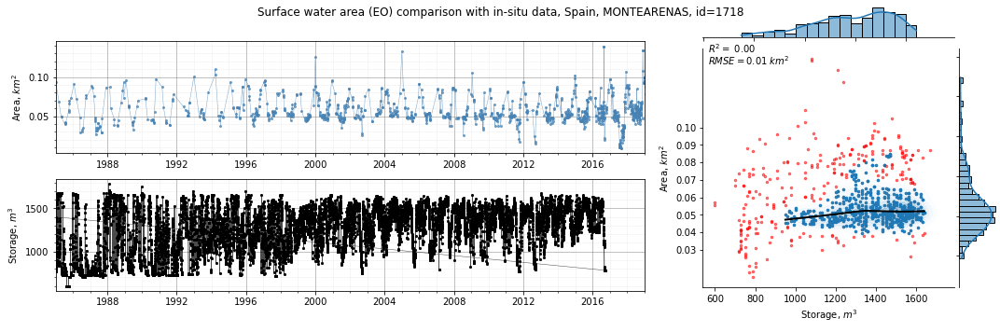

  5%|████▏                                                                            | 16/313 [00:47<14:59,  3.03s/it]

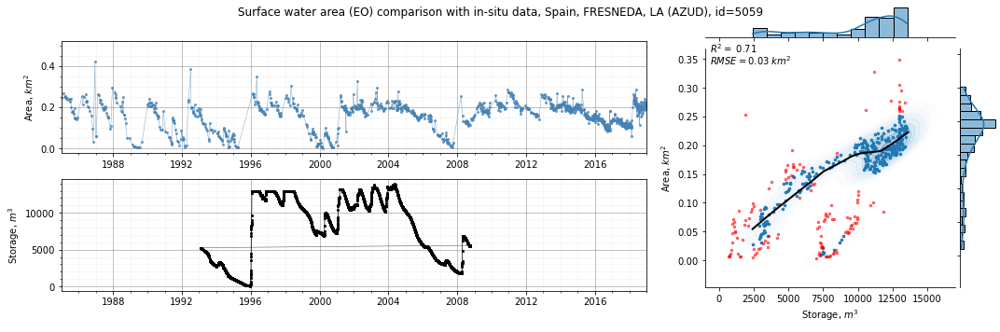

  5%|████▍                                                                            | 17/313 [00:50<15:36,  3.16s/it]

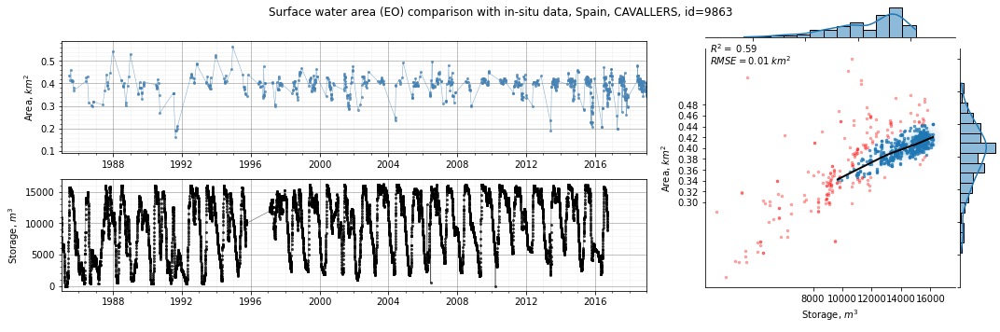

  6%|████▋                                                                            | 18/313 [00:54<16:10,  3.29s/it]

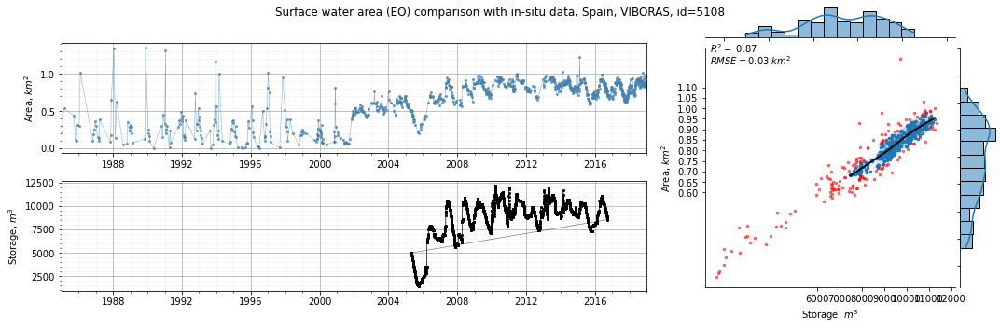

  6%|████▉                                                                            | 19/313 [00:57<16:34,  3.38s/it]

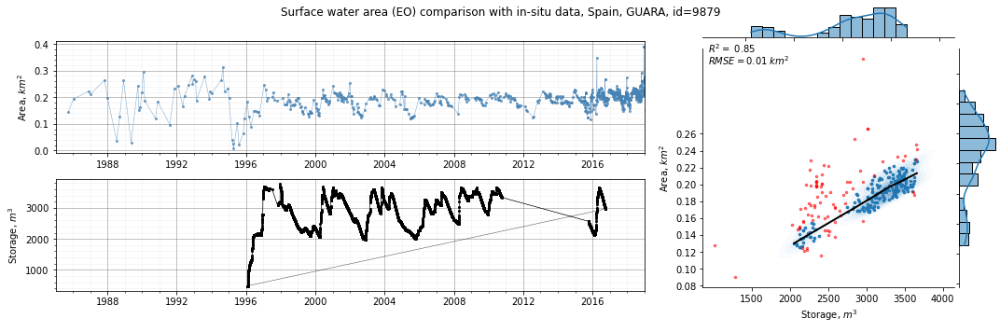

  6%|█████▏                                                                           | 20/313 [01:00<16:14,  3.33s/it]

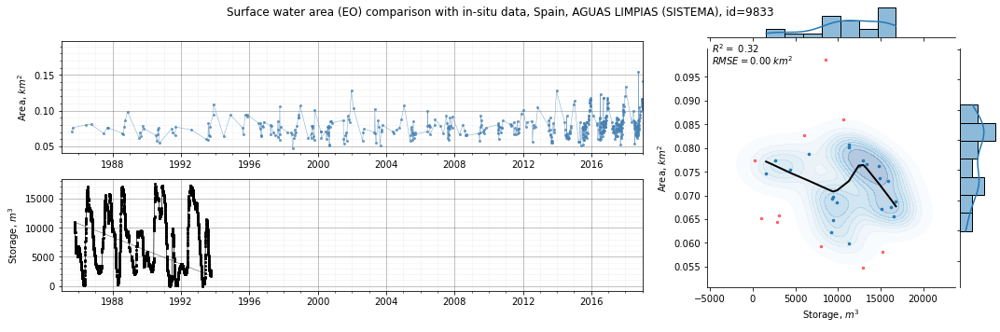

  7%|█████▍                                                                           | 21/313 [01:03<14:41,  3.02s/it]

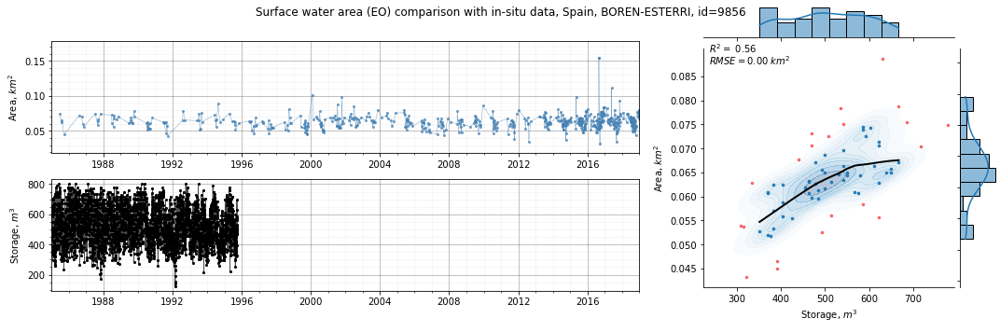

  7%|█████▋                                                                           | 22/313 [01:05<13:43,  2.83s/it]

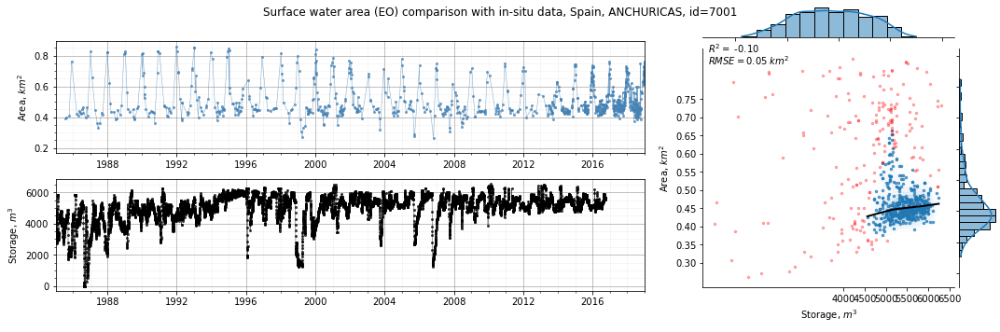

  7%|█████▉                                                                           | 23/313 [01:08<13:08,  2.72s/it]

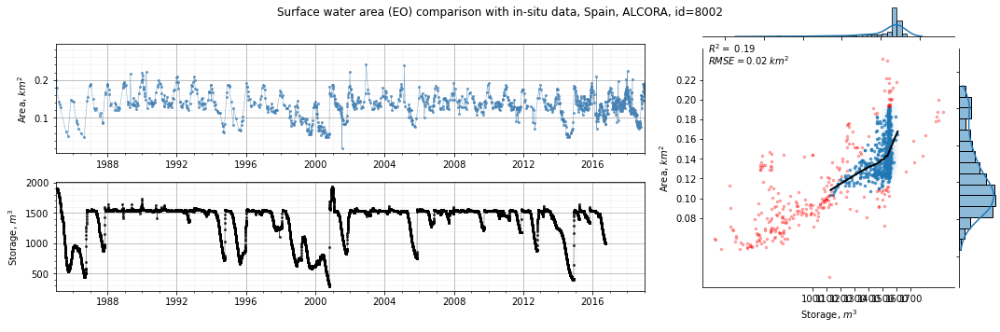

  8%|██████▏                                                                          | 24/313 [01:10<12:41,  2.63s/it]

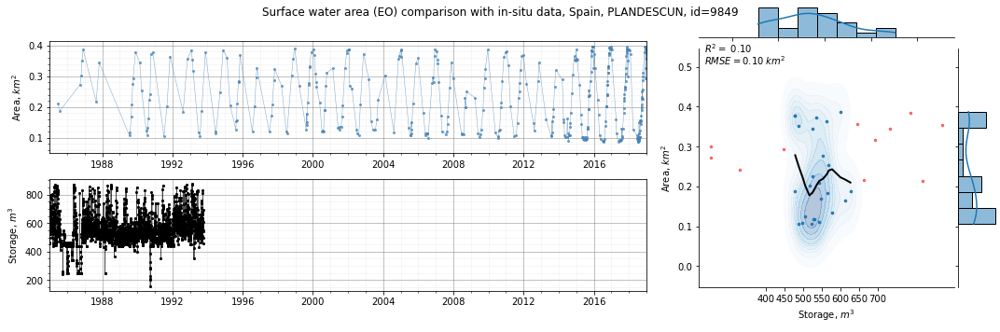

  8%|██████▍                                                                          | 25/313 [01:12<11:20,  2.36s/it]

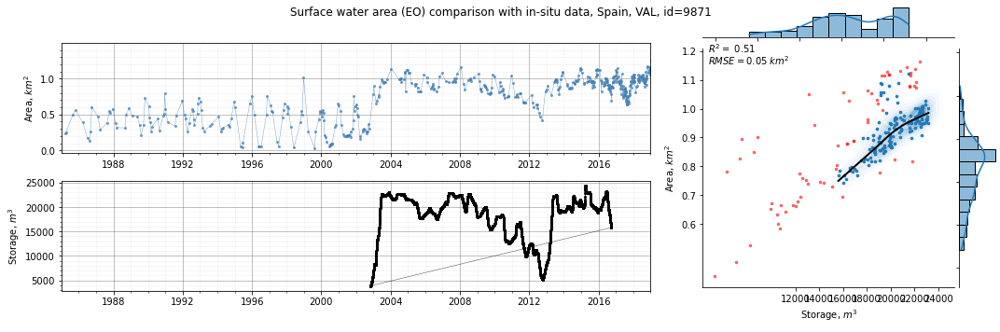

  8%|██████▋                                                                          | 26/313 [01:14<10:58,  2.29s/it]

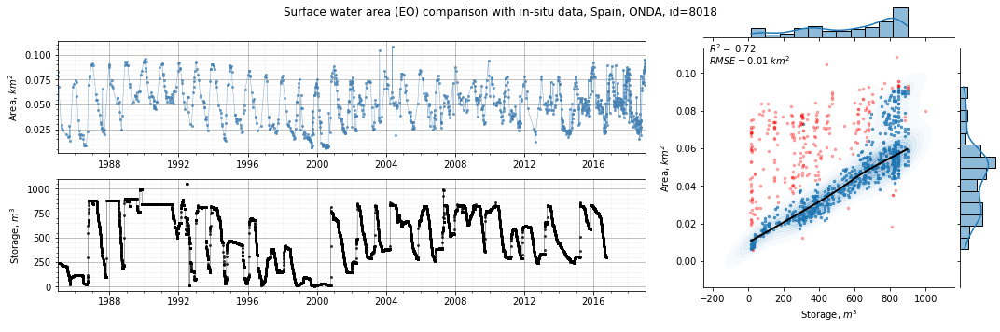

  9%|██████▉                                                                          | 27/313 [01:16<11:23,  2.39s/it]

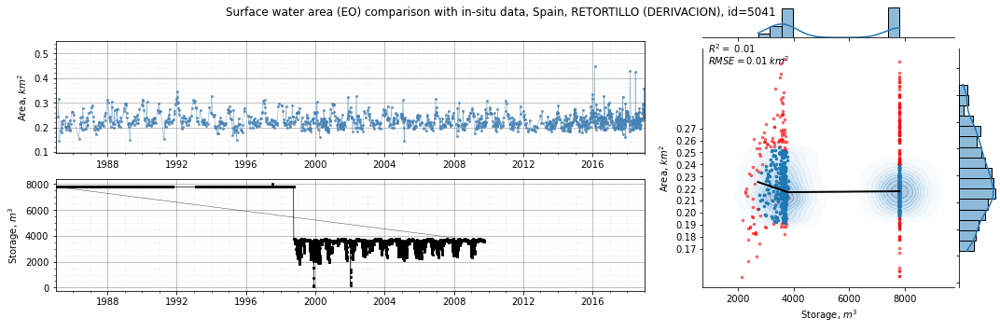

  9%|███████▏                                                                         | 28/313 [01:20<12:20,  2.60s/it]

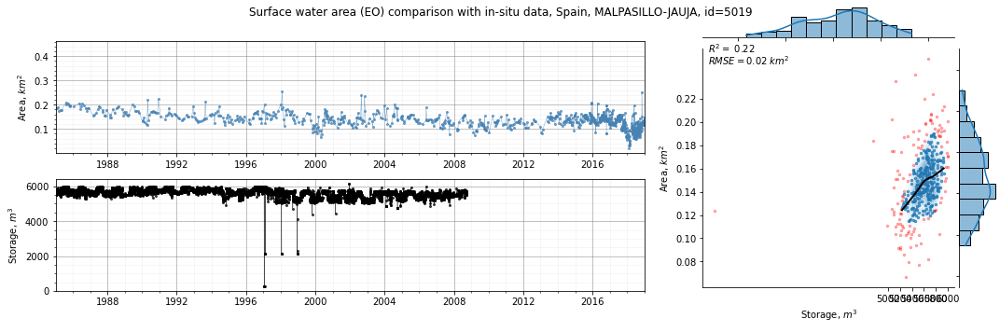

  9%|███████▌                                                                         | 29/313 [01:22<11:35,  2.45s/it]

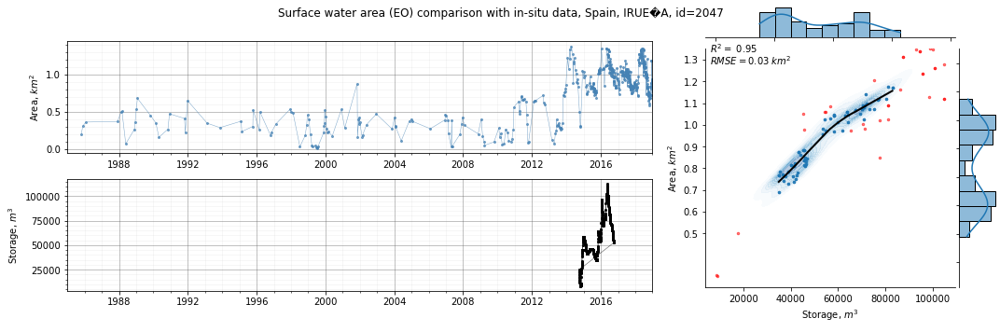

 10%|███████▊                                                                         | 30/313 [01:24<10:54,  2.31s/it]

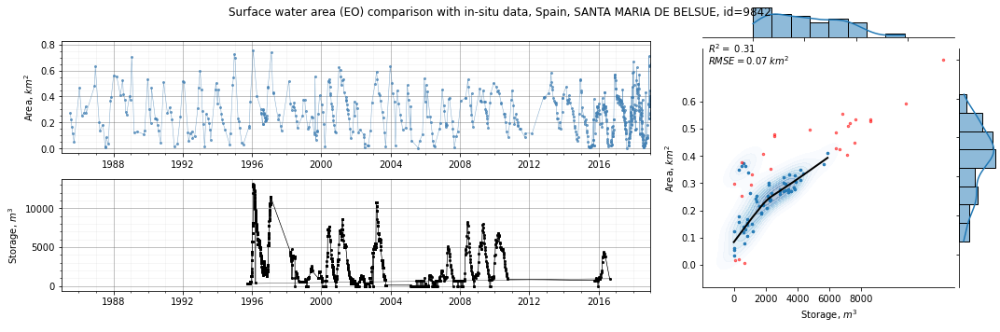

 10%|████████                                                                         | 31/313 [01:26<10:17,  2.19s/it]

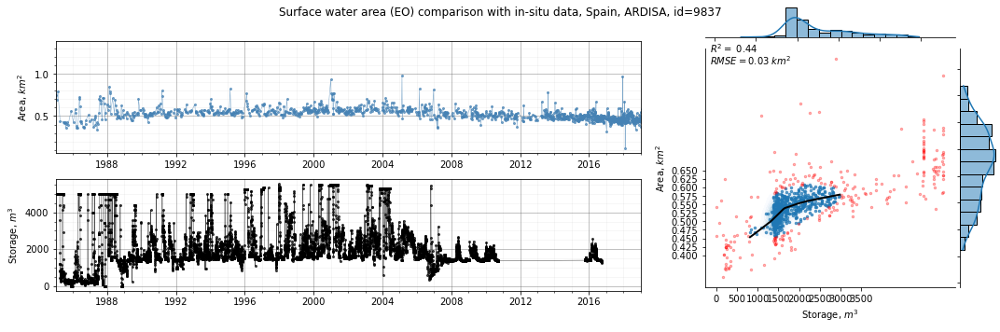

 10%|████████▎                                                                        | 32/313 [01:28<10:48,  2.31s/it]

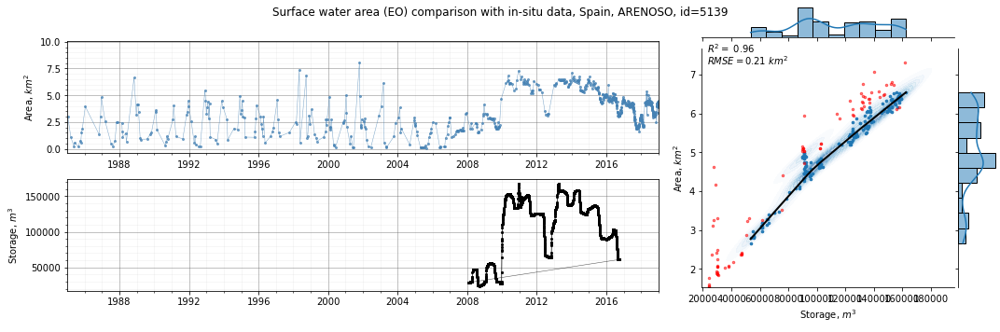

 11%|████████▌                                                                        | 33/313 [01:30<10:49,  2.32s/it]

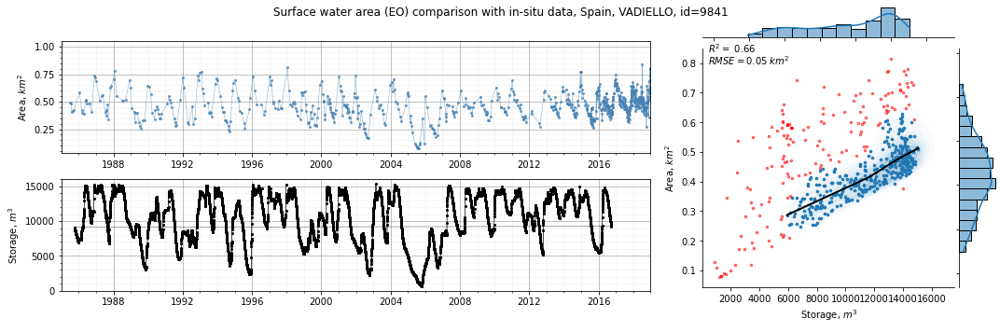

 11%|████████▊                                                                        | 34/313 [01:33<11:39,  2.51s/it]

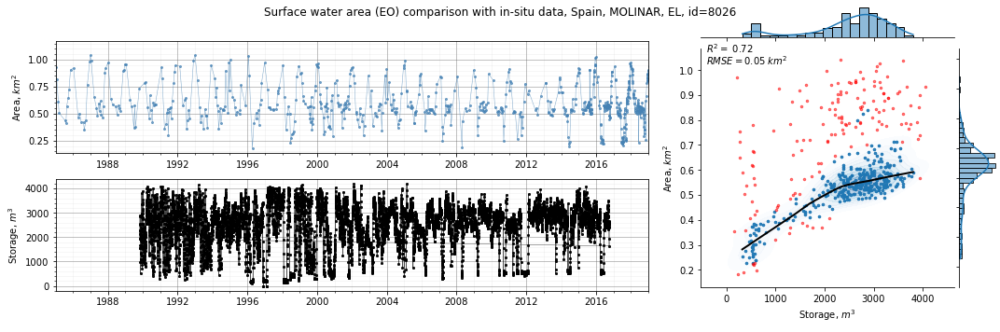

 11%|█████████                                                                        | 35/313 [01:36<12:10,  2.63s/it]

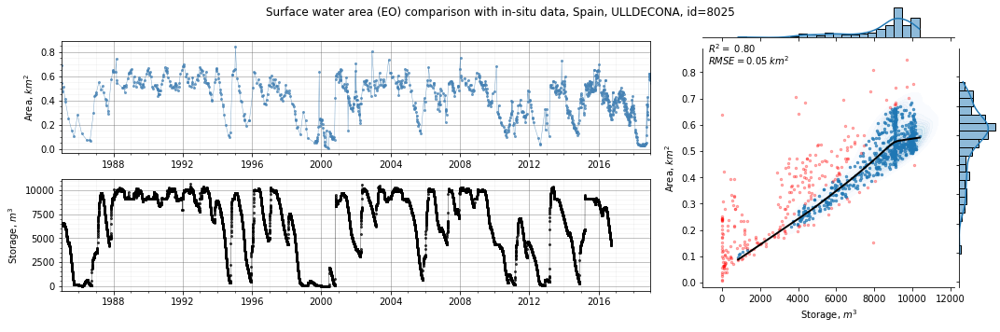

 12%|█████████▎                                                                       | 36/313 [01:39<12:36,  2.73s/it]

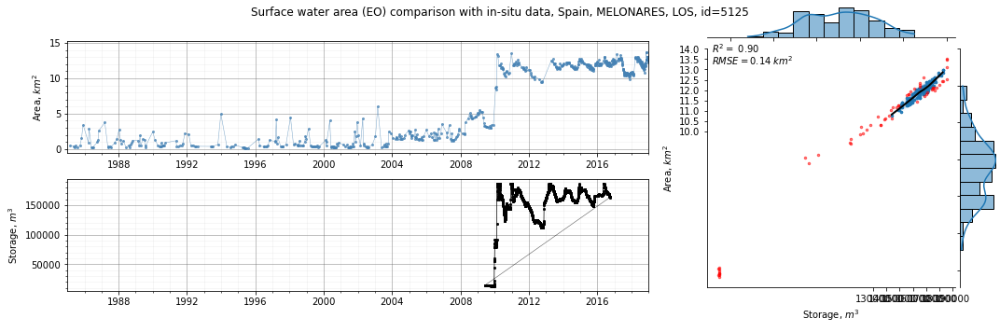

 12%|█████████▌                                                                       | 37/313 [01:42<11:59,  2.61s/it]

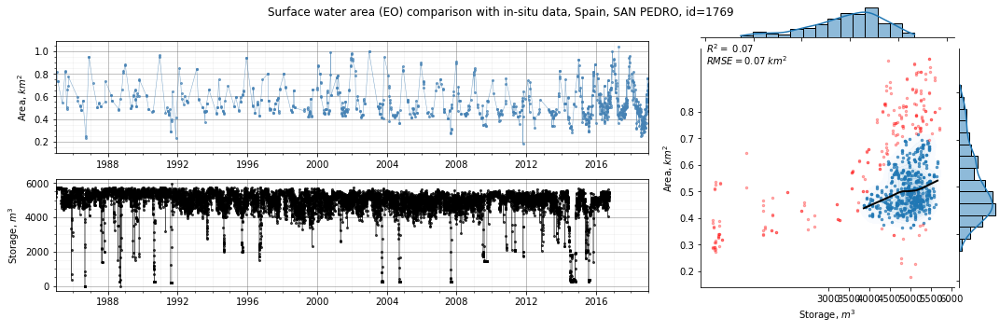

 12%|█████████▊                                                                       | 38/313 [01:44<12:10,  2.65s/it]

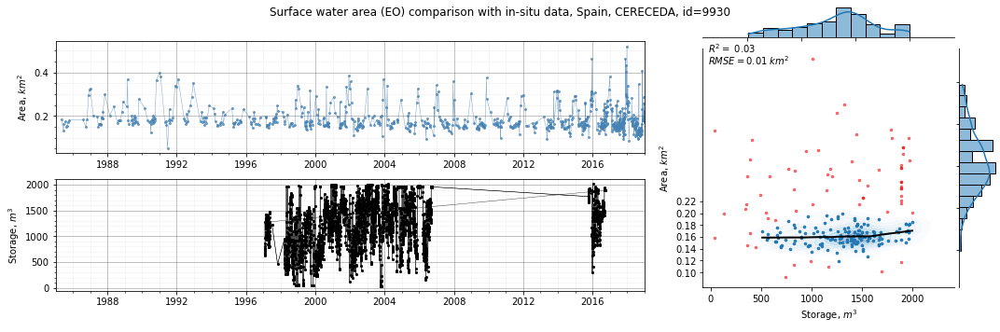

 12%|██████████                                                                       | 39/313 [01:47<11:35,  2.54s/it]

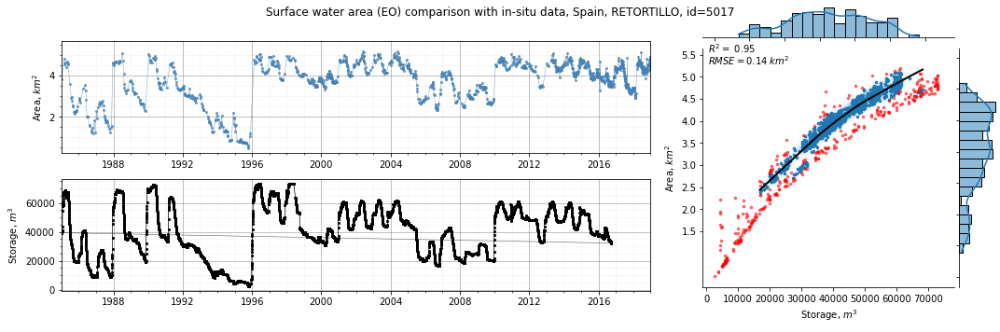

 13%|██████████▎                                                                      | 40/313 [01:51<14:41,  3.23s/it]

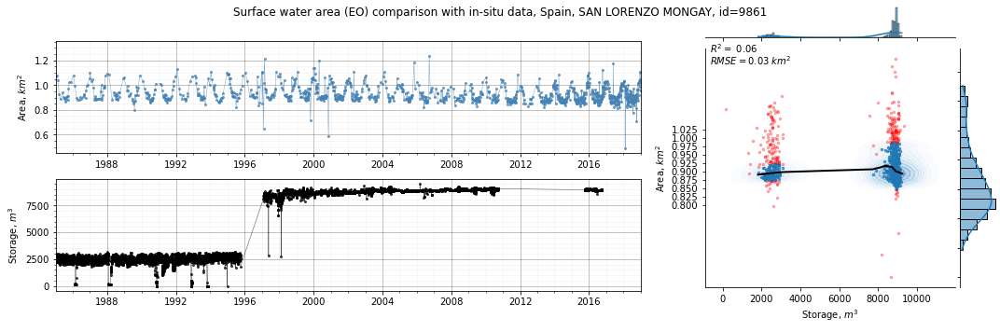

 13%|██████████▌                                                                      | 41/313 [01:54<13:53,  3.06s/it]

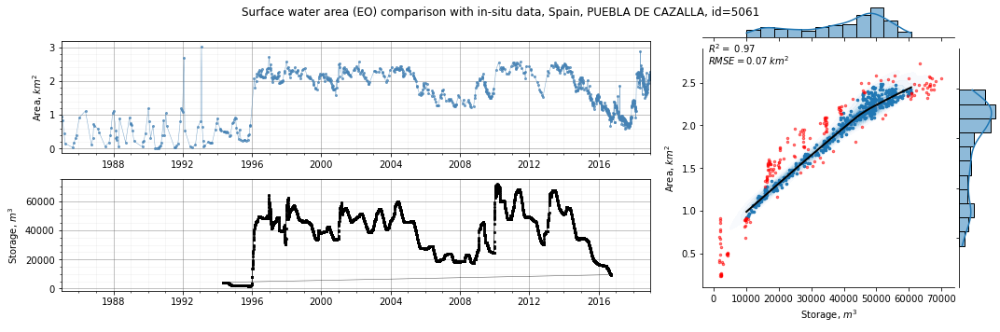

 13%|██████████▊                                                                      | 42/313 [01:57<14:03,  3.11s/it]

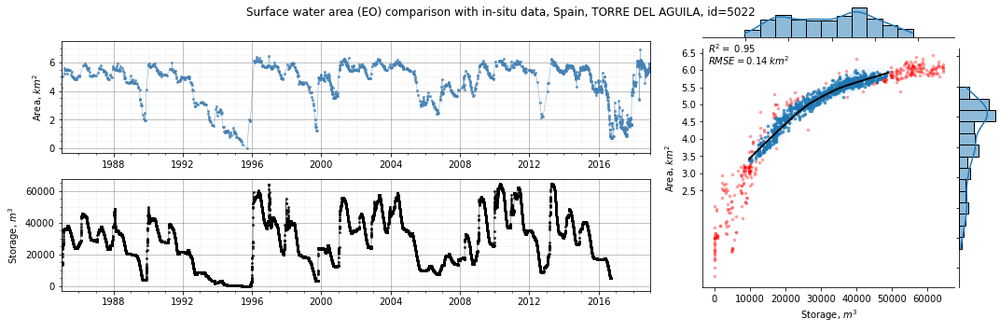

 14%|███████████▏                                                                     | 43/313 [02:00<13:48,  3.07s/it]

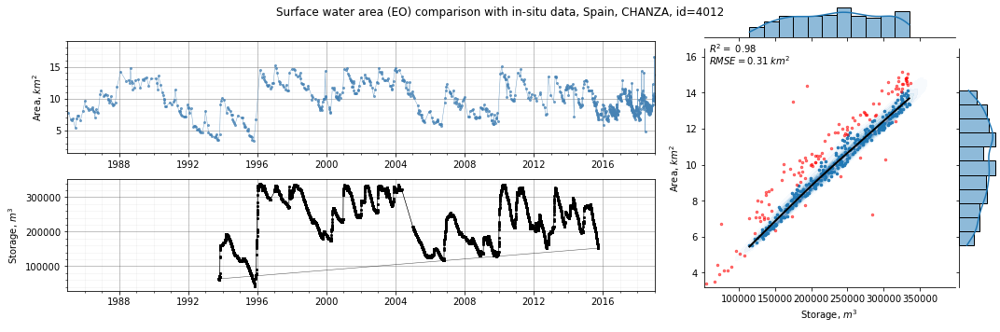

 14%|███████████▍                                                                     | 44/313 [02:03<13:34,  3.03s/it]

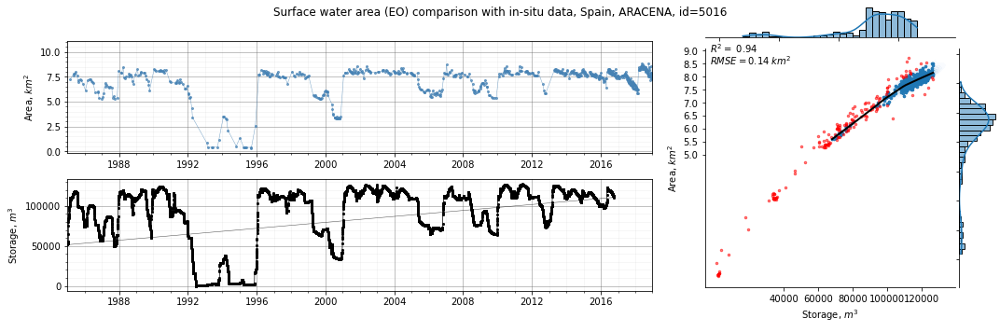

 14%|███████████▋                                                                     | 45/313 [02:07<13:47,  3.09s/it]

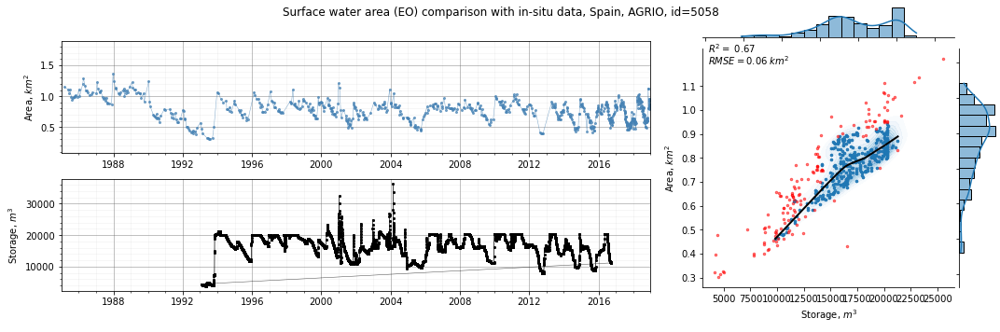

 15%|███████████▉                                                                     | 46/313 [02:09<13:16,  2.98s/it]

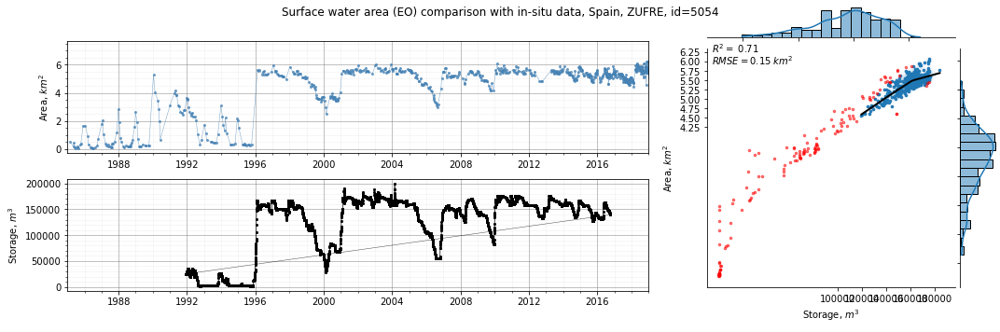

 15%|████████████▏                                                                    | 47/313 [02:12<12:51,  2.90s/it]

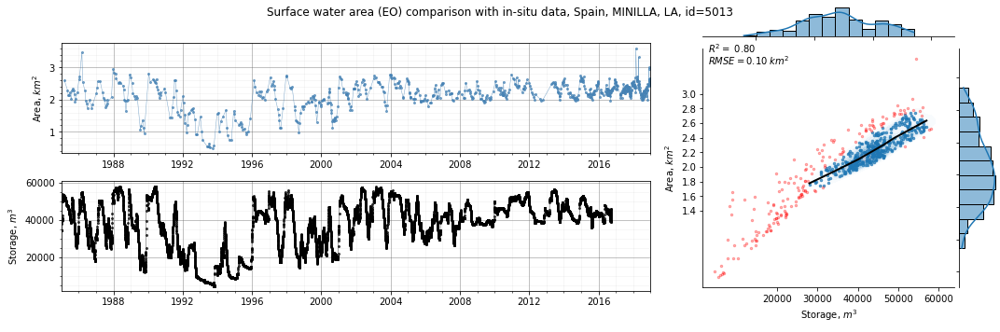

 15%|████████████▍                                                                    | 48/313 [02:14<12:13,  2.77s/it]

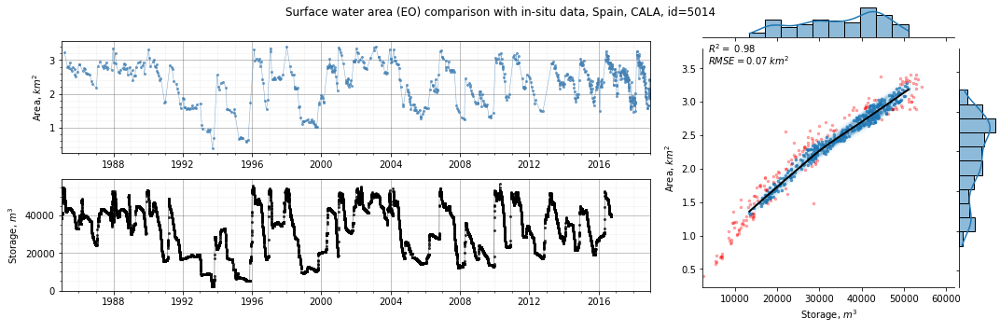

 16%|████████████▋                                                                    | 49/313 [02:17<11:53,  2.70s/it]

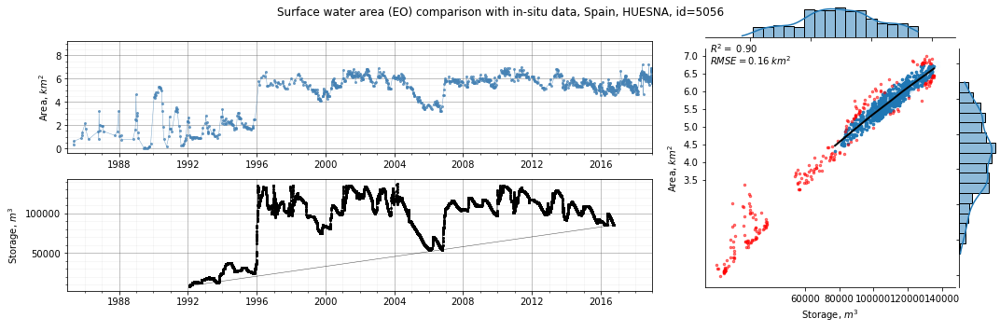

 16%|████████████▉                                                                    | 50/313 [02:21<13:02,  2.98s/it]

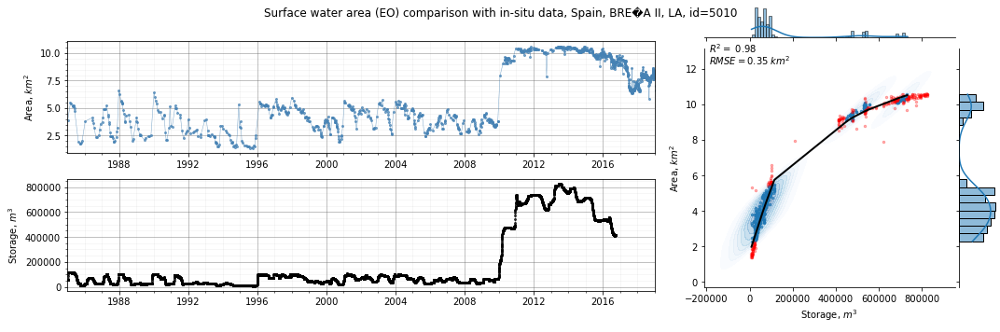

 16%|█████████████▏                                                                   | 51/313 [02:23<12:54,  2.96s/it]

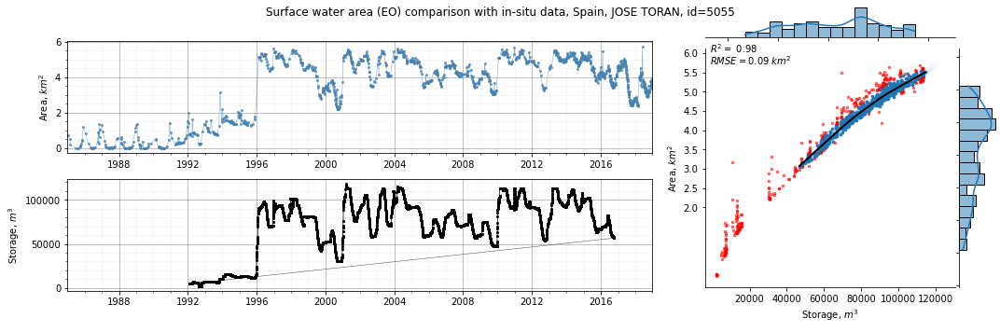

 17%|█████████████▍                                                                   | 52/313 [02:28<14:34,  3.35s/it]

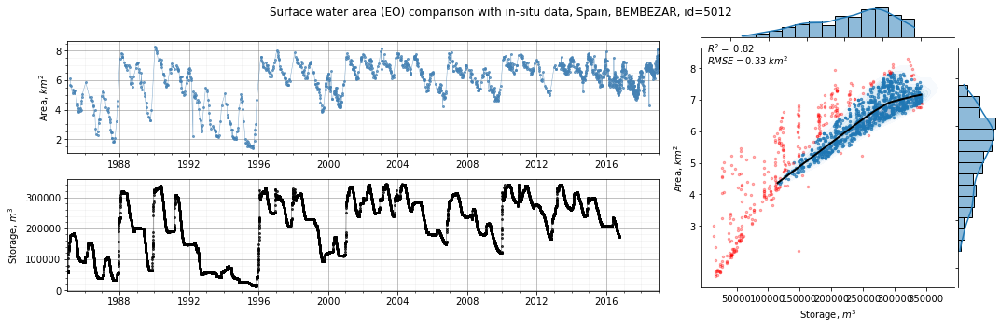

 17%|█████████████▋                                                                   | 53/313 [02:31<13:55,  3.21s/it]

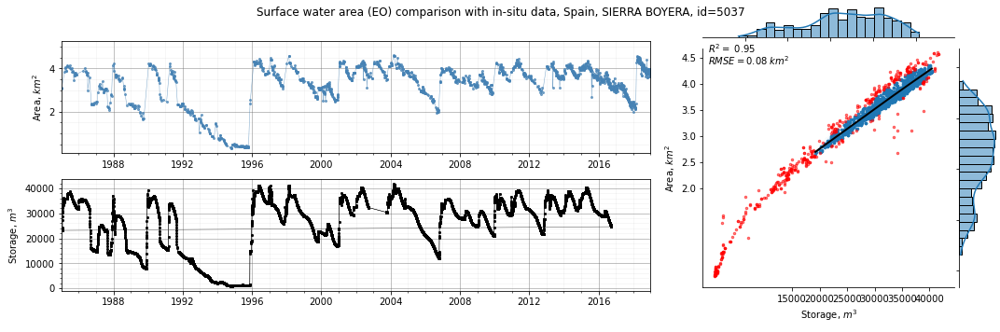

 17%|█████████████▉                                                                   | 54/313 [02:36<16:40,  3.86s/it]

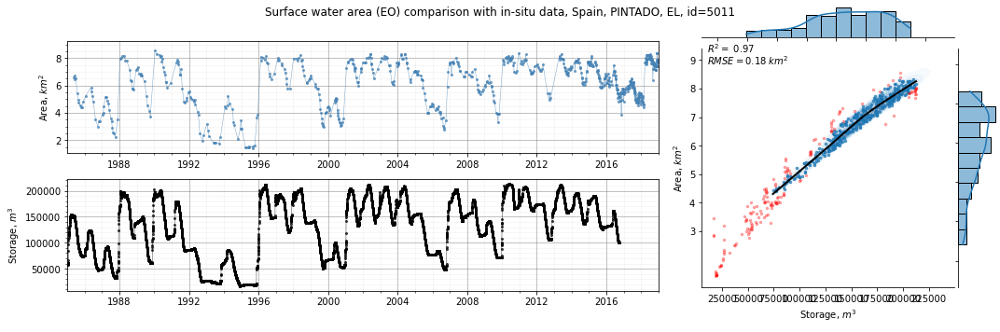

 18%|██████████████▏                                                                  | 55/313 [02:39<15:01,  3.49s/it]

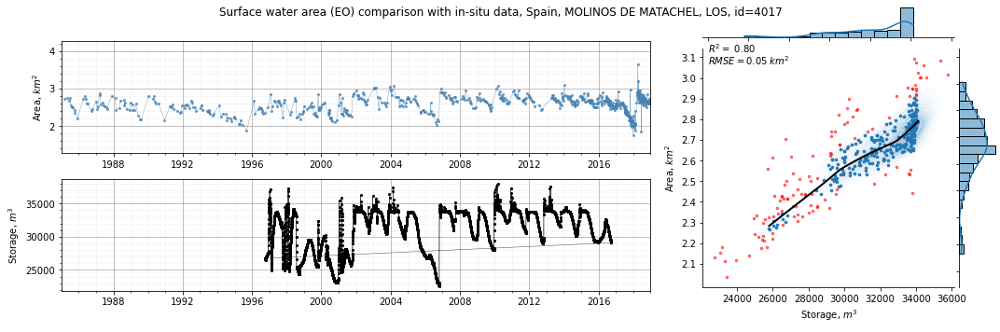

 18%|██████████████▍                                                                  | 56/313 [02:41<13:52,  3.24s/it]

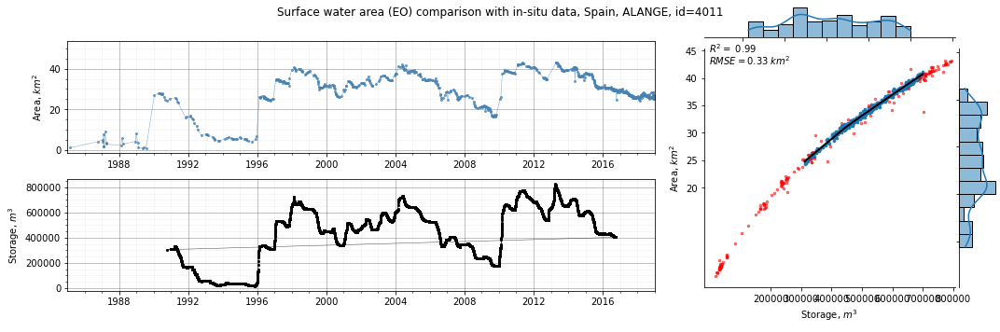

 18%|██████████████▊                                                                  | 57/313 [02:45<13:56,  3.27s/it]

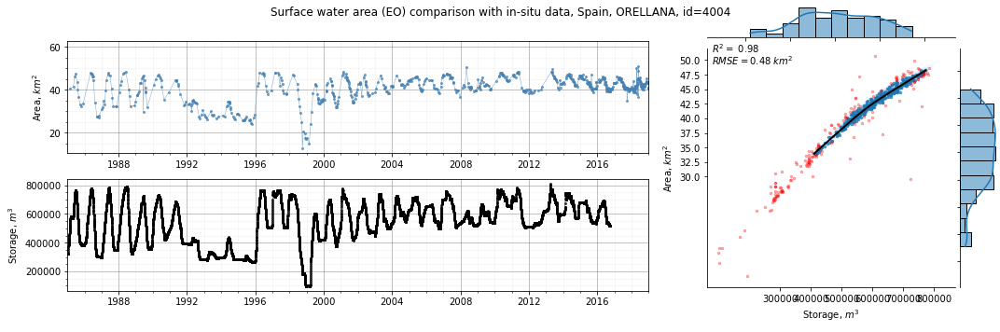

 19%|███████████████                                                                  | 58/313 [02:47<13:09,  3.10s/it]

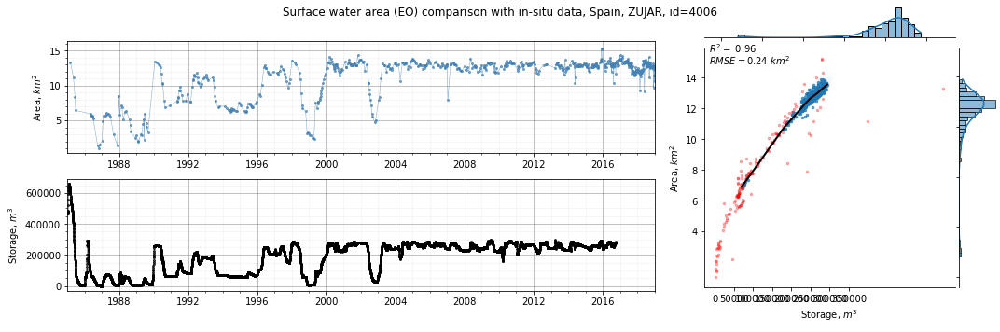

 19%|███████████████▎                                                                 | 59/313 [02:50<12:31,  2.96s/it]

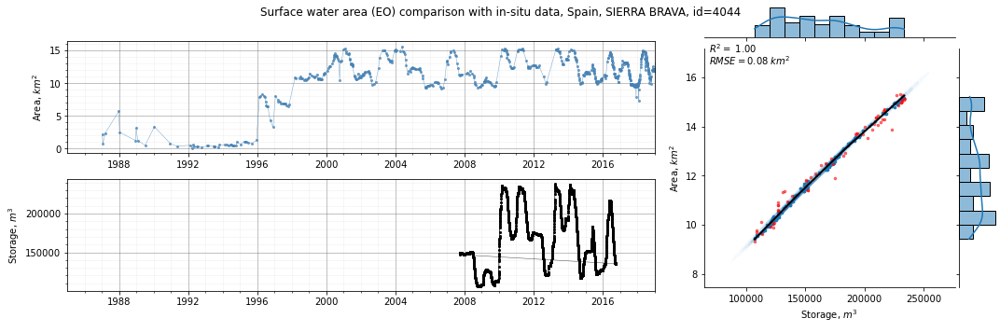

 19%|███████████████▌                                                                 | 60/313 [02:52<11:48,  2.80s/it]

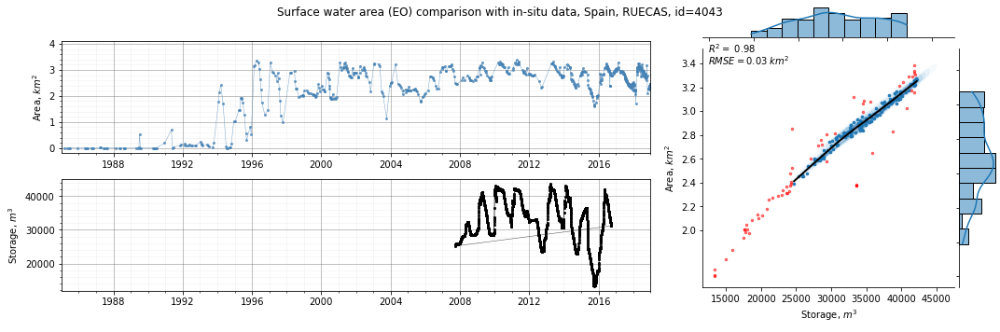

 19%|███████████████▊                                                                 | 61/313 [02:55<11:09,  2.66s/it]

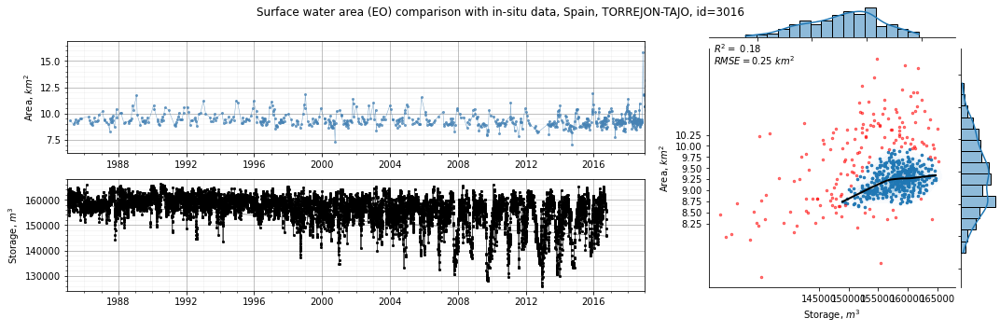

 20%|████████████████                                                                 | 62/313 [02:58<11:38,  2.78s/it]

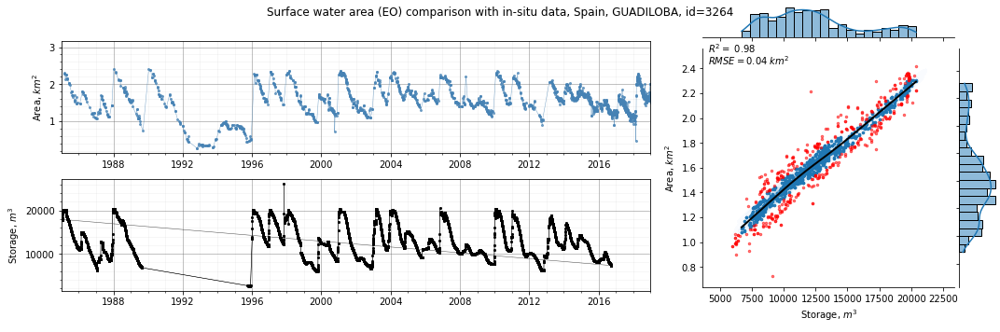

 20%|████████████████▎                                                                | 63/313 [03:03<14:29,  3.48s/it]

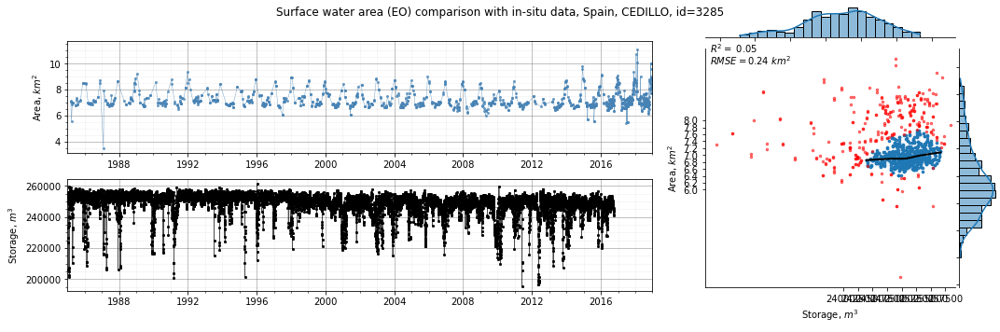

 20%|████████████████▌                                                                | 64/313 [03:06<14:25,  3.48s/it]

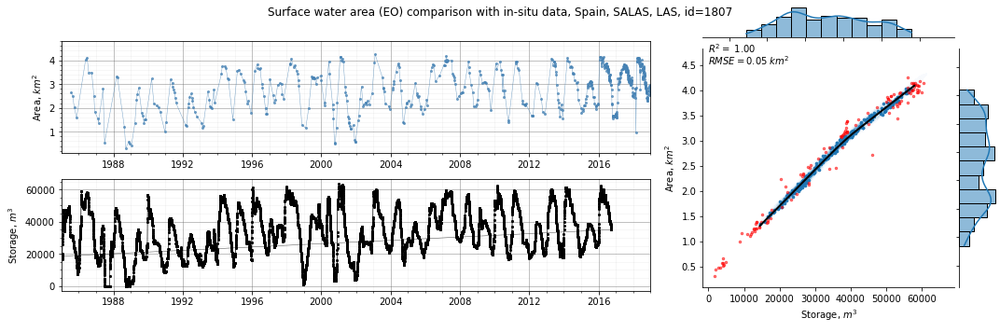

 21%|████████████████▊                                                                | 65/313 [03:10<14:02,  3.40s/it]

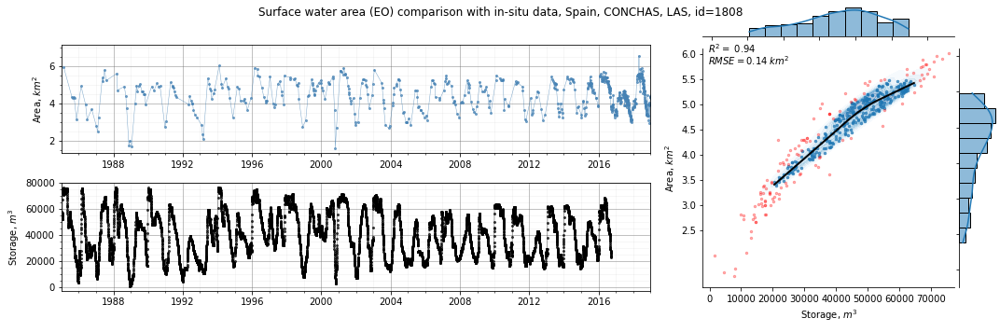

 21%|█████████████████                                                                | 66/313 [03:12<12:48,  3.11s/it]

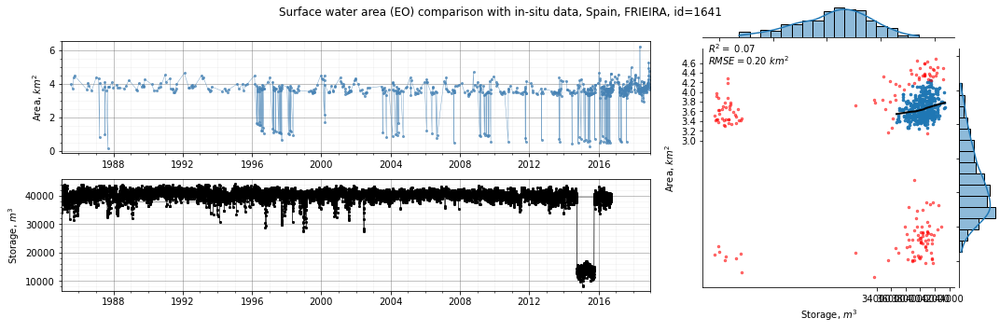

 21%|█████████████████▎                                                               | 67/313 [03:15<12:51,  3.13s/it]

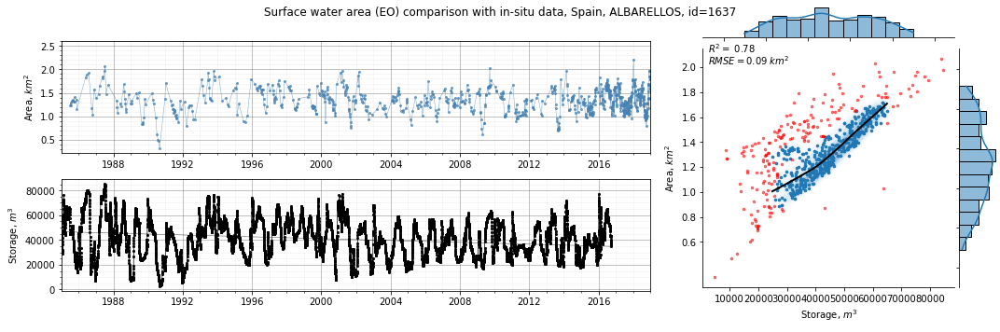

 22%|█████████████████▌                                                               | 68/313 [03:18<12:53,  3.16s/it]

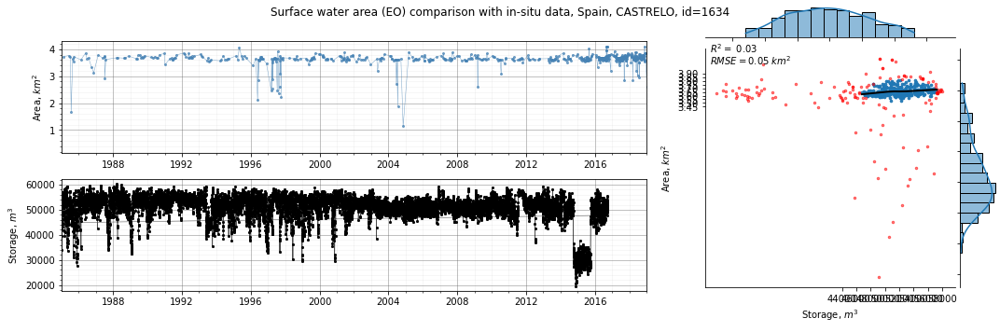

 22%|█████████████████▊                                                               | 69/313 [03:21<12:31,  3.08s/it]

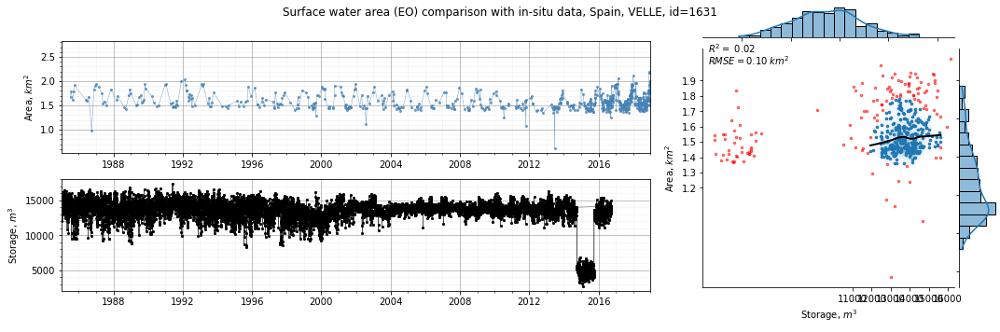

 22%|██████████████████                                                               | 70/313 [03:24<12:24,  3.06s/it]

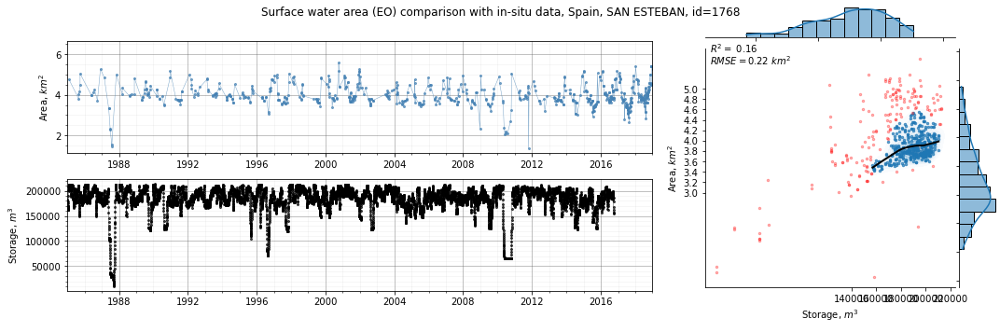

 23%|██████████████████▎                                                              | 71/313 [03:27<11:32,  2.86s/it]

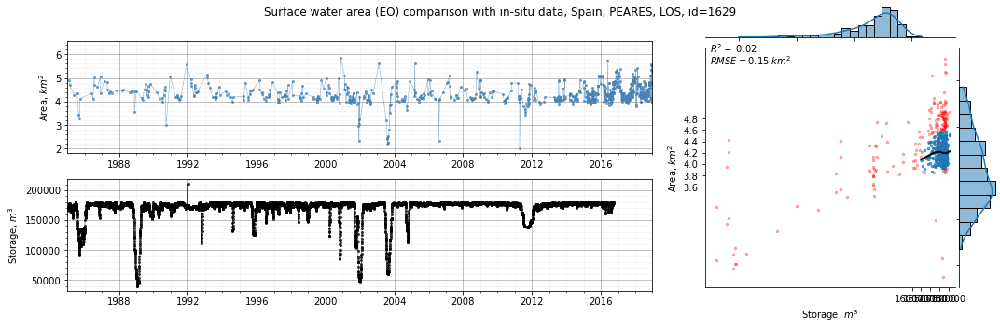

 23%|██████████████████▋                                                              | 72/313 [03:29<11:02,  2.75s/it]

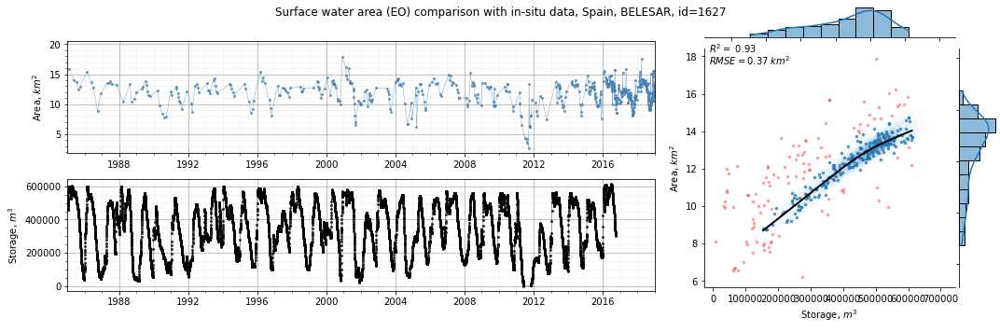

 23%|██████████████████▉                                                              | 73/313 [03:32<10:28,  2.62s/it]

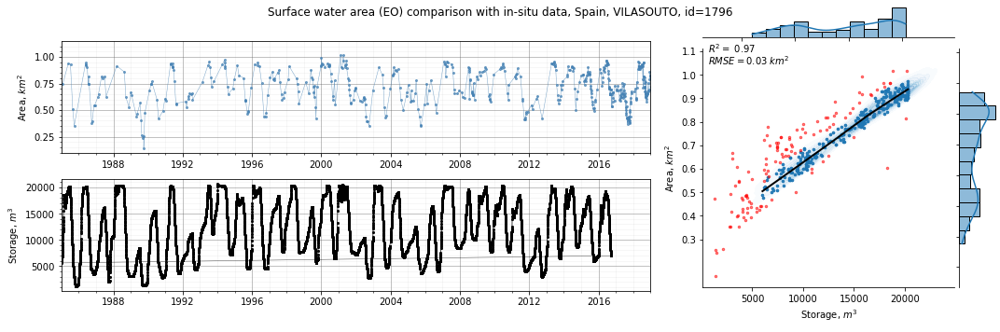

 24%|███████████████████▏                                                             | 74/313 [03:35<10:57,  2.75s/it]

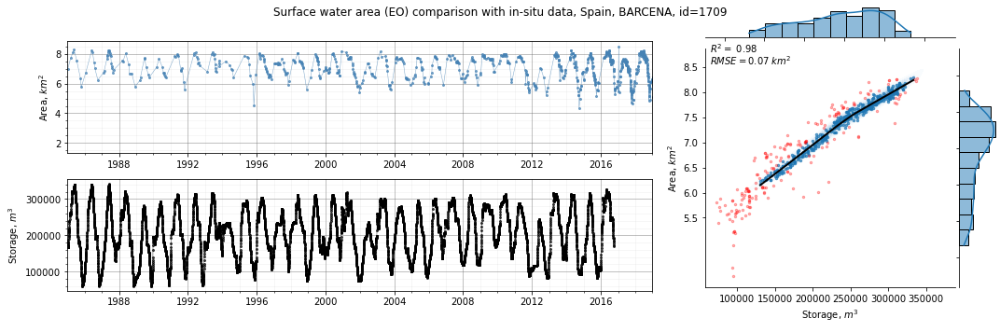

 24%|███████████████████▍                                                             | 75/313 [03:37<10:58,  2.77s/it]

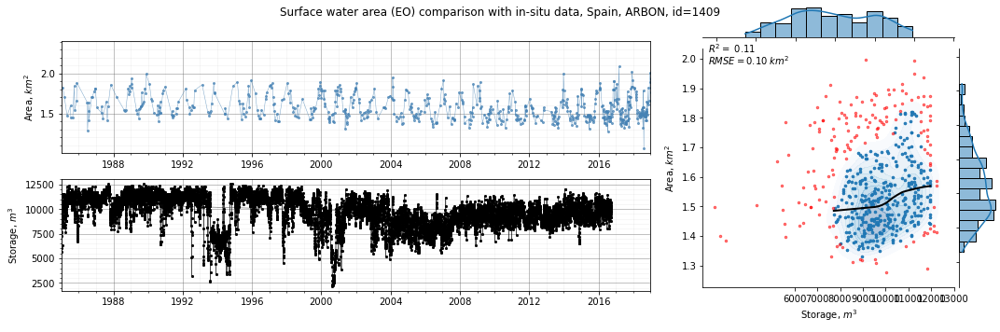

 24%|███████████████████▋                                                             | 76/313 [03:40<11:09,  2.83s/it]

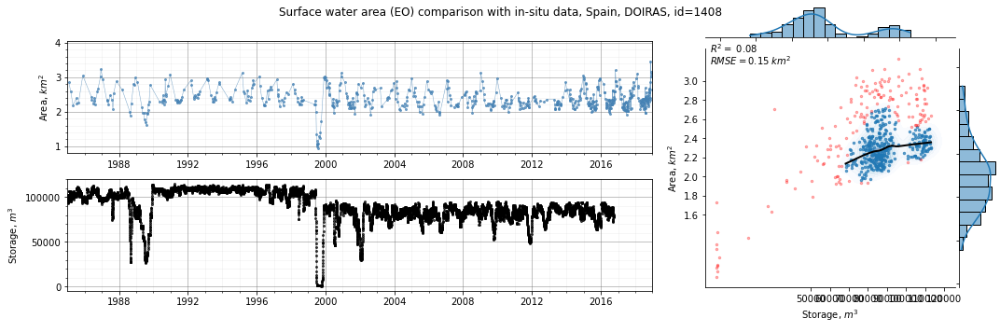

 25%|███████████████████▉                                                             | 77/313 [03:43<10:30,  2.67s/it]

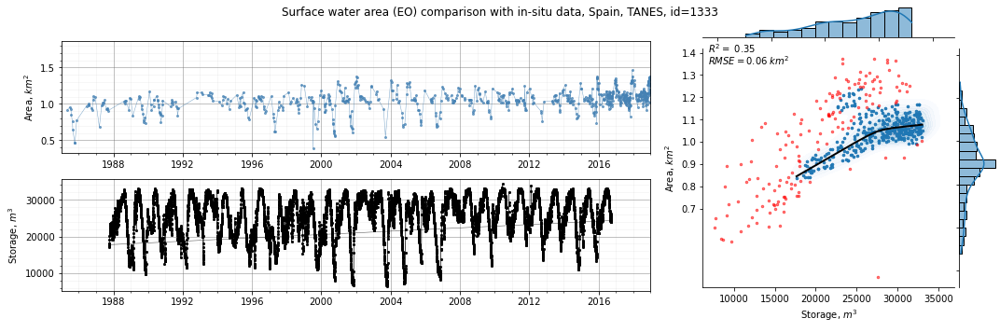

 25%|████████████████████▏                                                            | 78/313 [03:46<10:43,  2.74s/it]

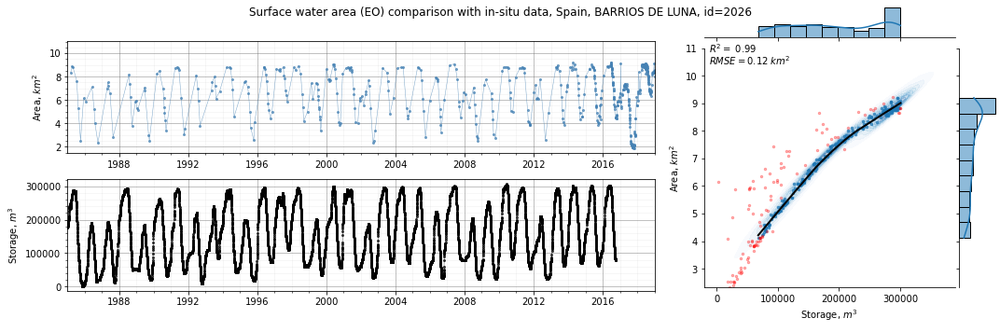

 25%|████████████████████▍                                                            | 79/313 [03:48<10:14,  2.63s/it]

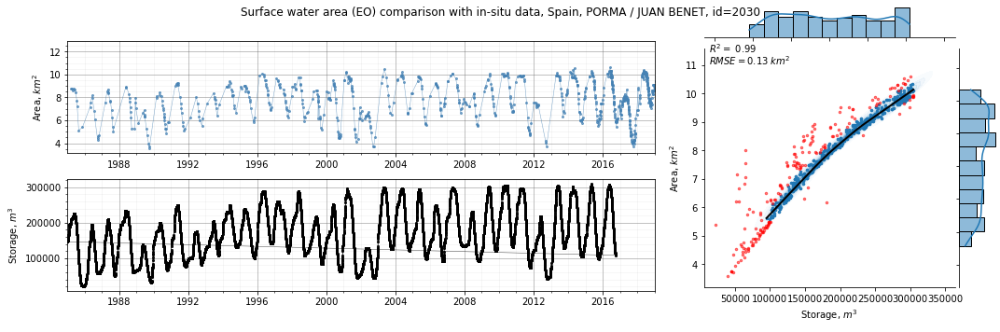

 26%|████████████████████▋                                                            | 80/313 [03:52<11:26,  2.95s/it]

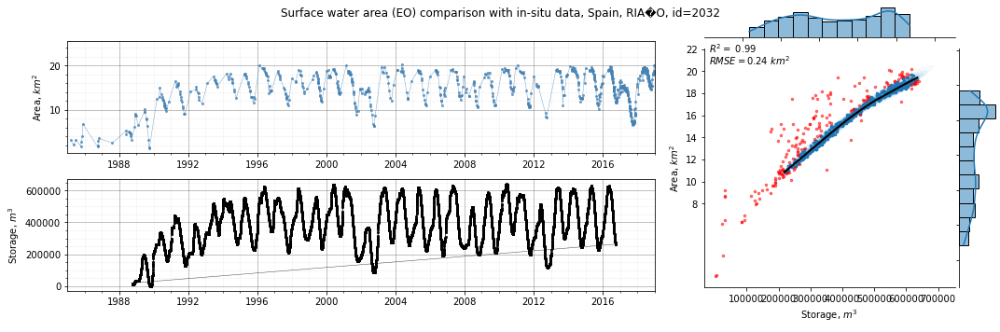

 26%|████████████████████▉                                                            | 81/313 [03:55<11:52,  3.07s/it]

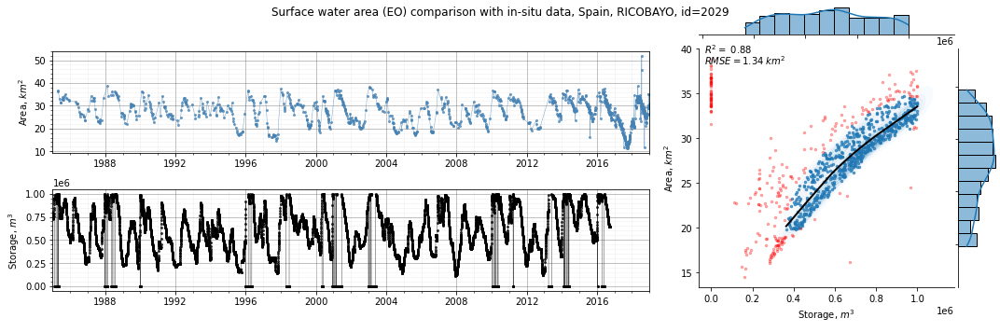

 26%|█████████████████████▏                                                           | 82/313 [03:58<11:34,  3.01s/it]

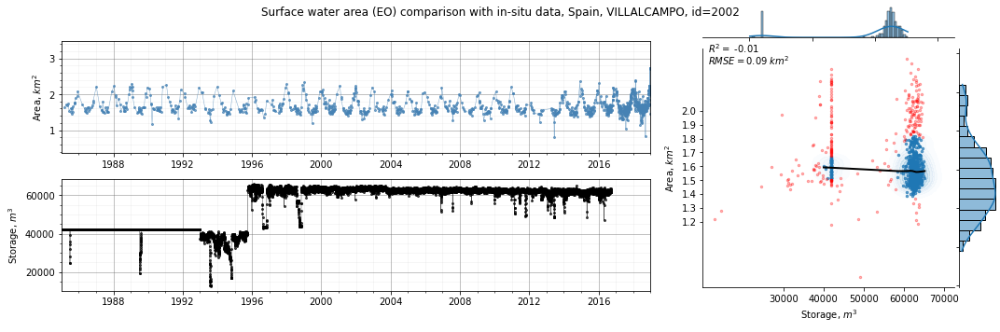

 27%|█████████████████████▍                                                           | 83/313 [04:00<11:02,  2.88s/it]

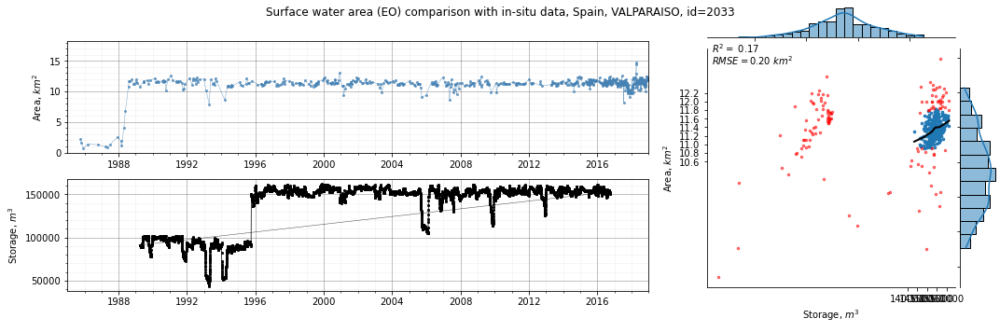

 27%|█████████████████████▋                                                           | 84/313 [04:03<11:03,  2.90s/it]

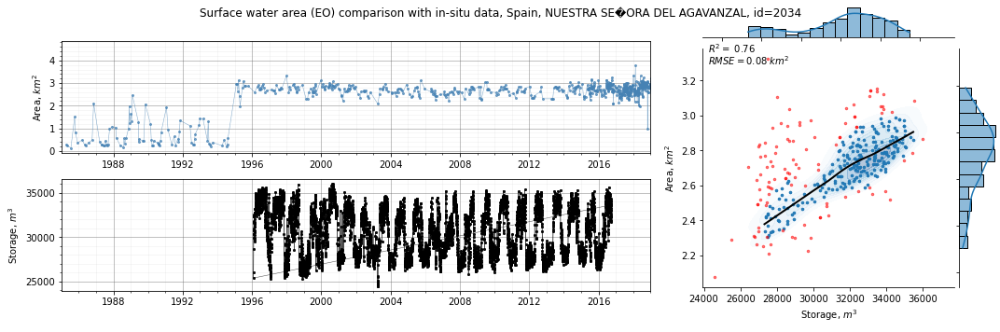

 27%|█████████████████████▉                                                           | 85/313 [04:06<10:39,  2.81s/it]

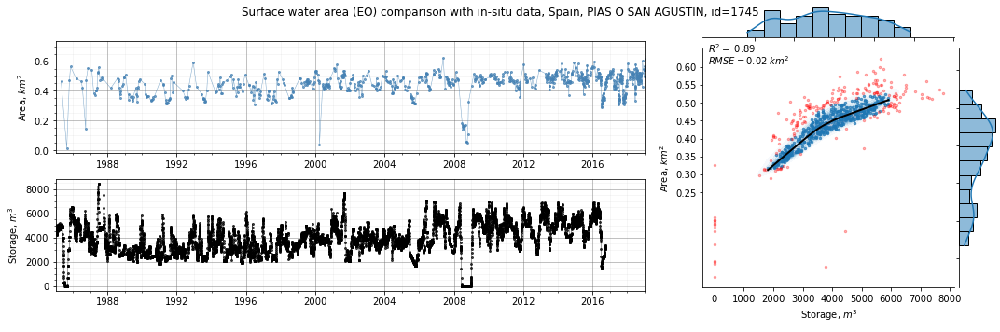

 27%|██████████████████████▎                                                          | 86/313 [04:09<10:24,  2.75s/it]

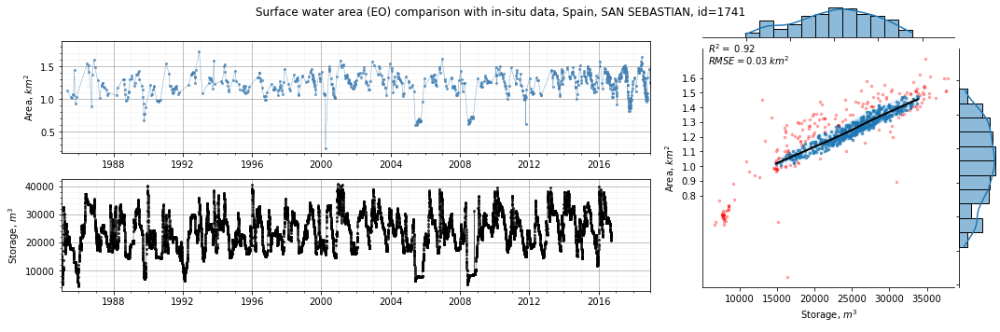

 28%|██████████████████████▌                                                          | 87/313 [04:11<10:17,  2.73s/it]

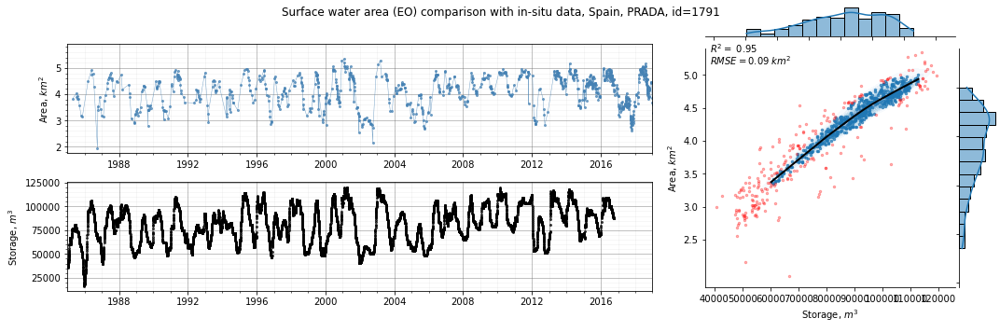

 28%|██████████████████████▊                                                          | 88/313 [04:14<10:25,  2.78s/it]

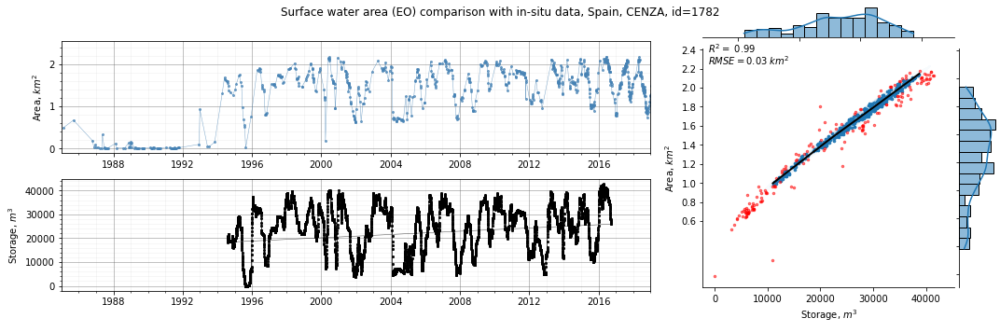

 28%|███████████████████████                                                          | 89/313 [04:18<11:05,  2.97s/it]

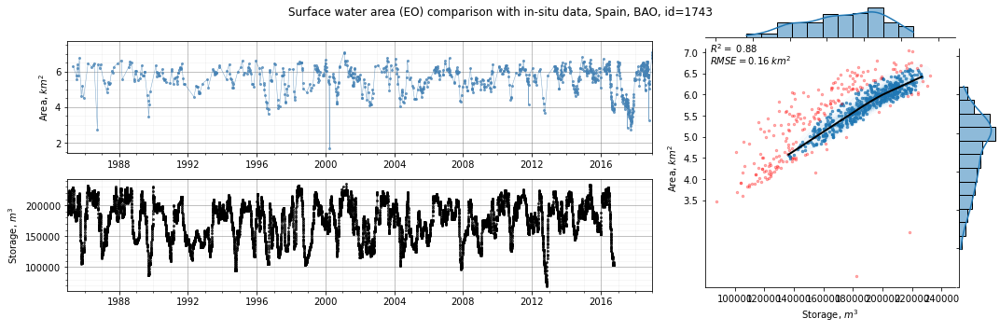

 29%|███████████████████████▎                                                         | 90/313 [04:20<10:47,  2.90s/it]

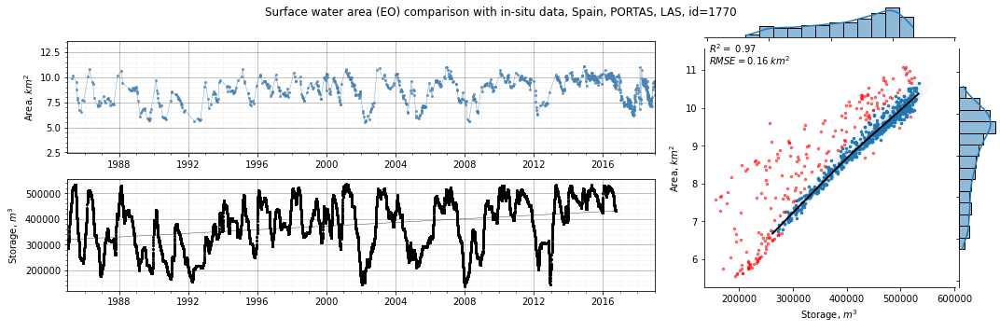

 29%|███████████████████████▌                                                         | 91/313 [04:24<11:42,  3.16s/it]

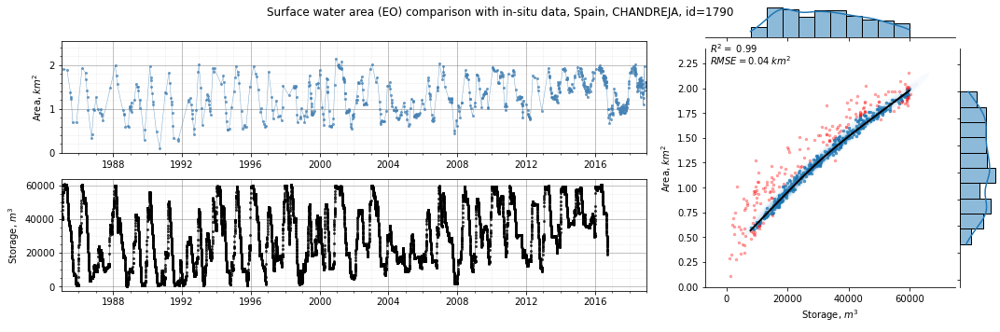

 29%|███████████████████████▊                                                         | 92/313 [04:27<11:17,  3.07s/it]

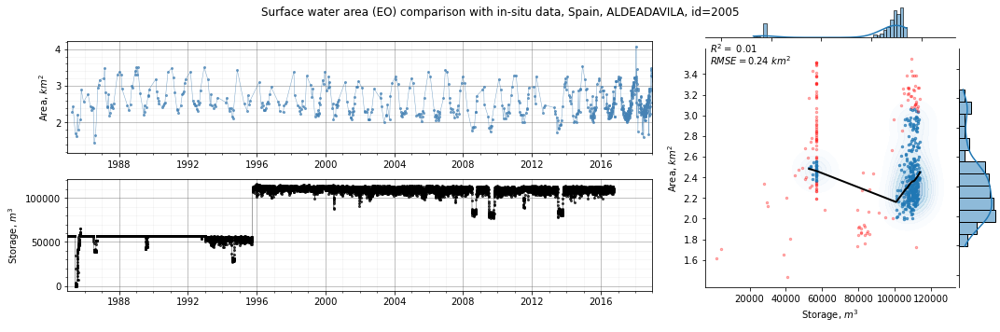

 30%|████████████████████████                                                         | 93/313 [04:29<10:37,  2.90s/it]

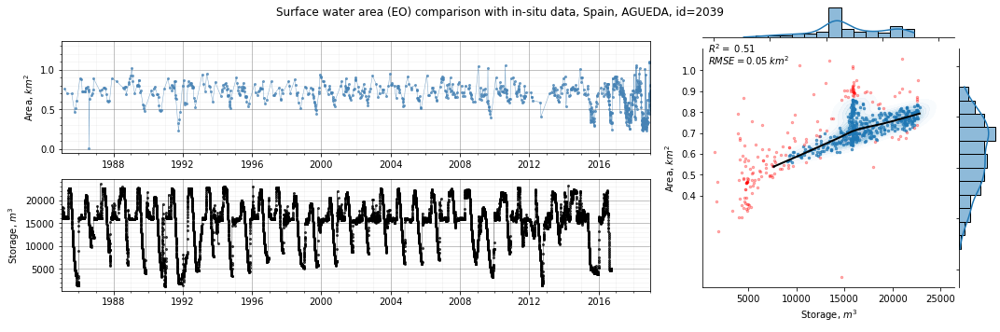

 30%|████████████████████████▎                                                        | 94/313 [04:32<10:12,  2.79s/it]

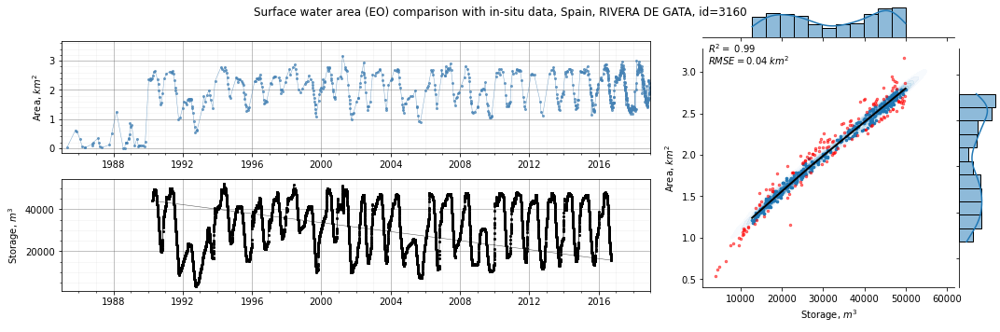

 30%|████████████████████████▌                                                        | 95/313 [04:35<10:49,  2.98s/it]

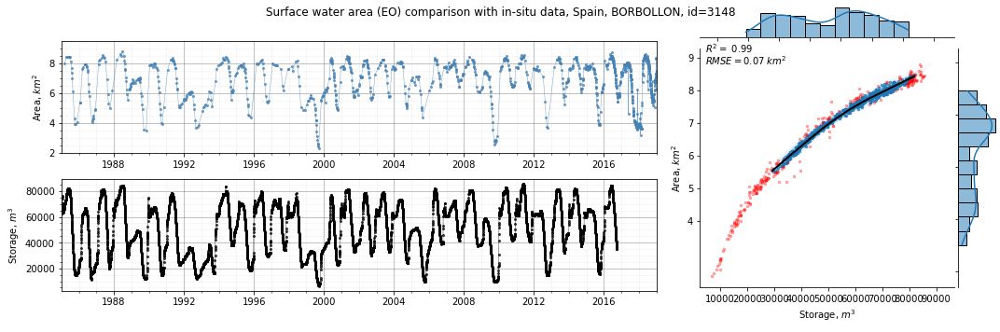

 31%|████████████████████████▊                                                        | 96/313 [04:39<10:52,  3.01s/it]

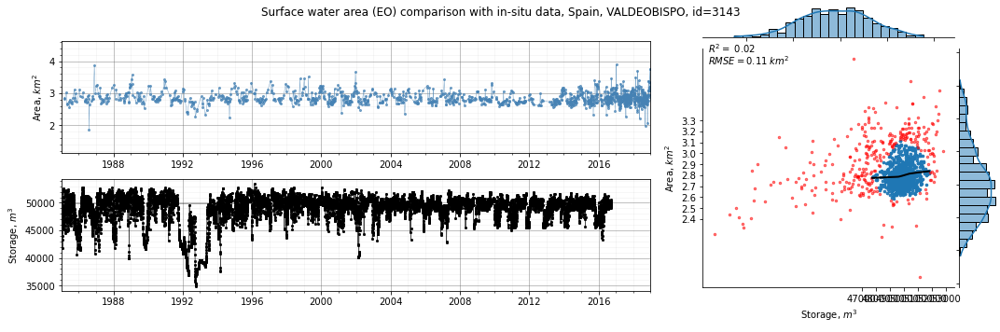

 31%|█████████████████████████                                                        | 97/313 [04:42<11:24,  3.17s/it]

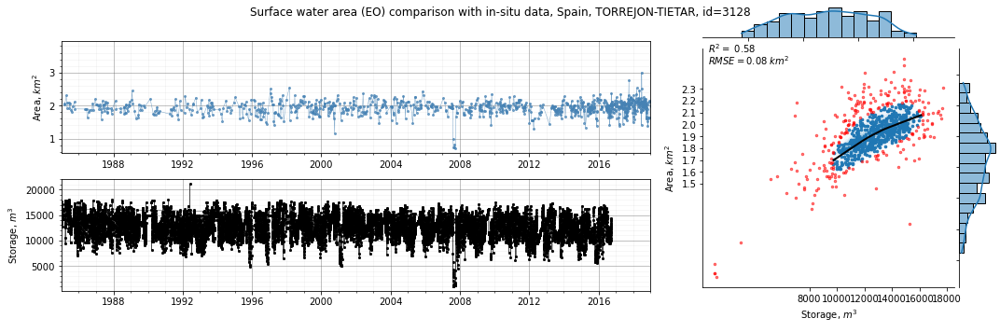

 31%|█████████████████████████▎                                                       | 98/313 [04:45<11:28,  3.20s/it]

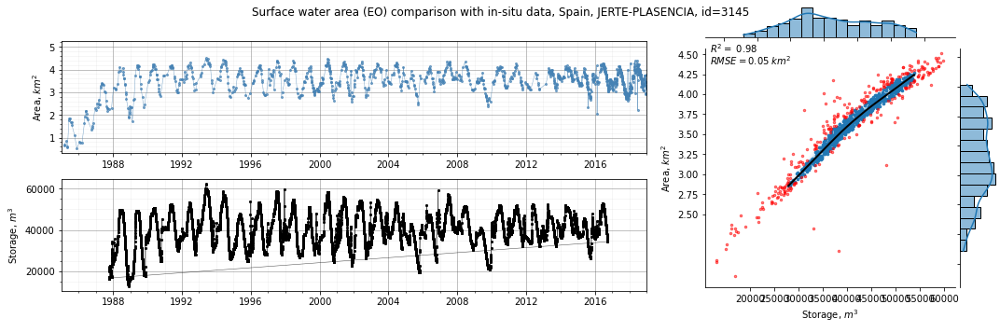

 32%|█████████████████████████▌                                                       | 99/313 [04:50<12:30,  3.51s/it]

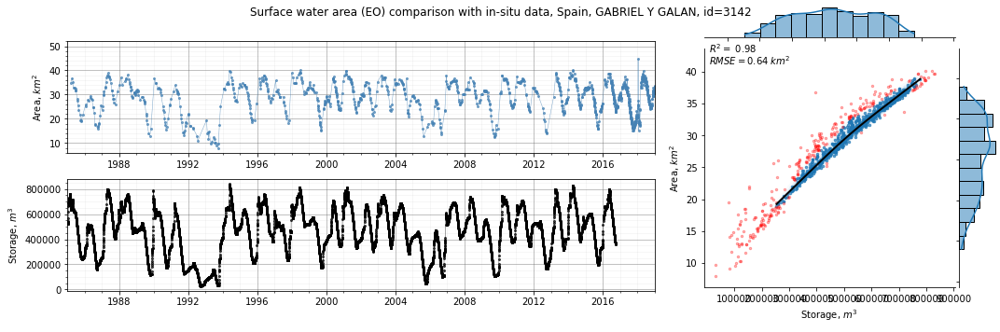

 32%|█████████████████████████▌                                                      | 100/313 [04:53<12:11,  3.43s/it]

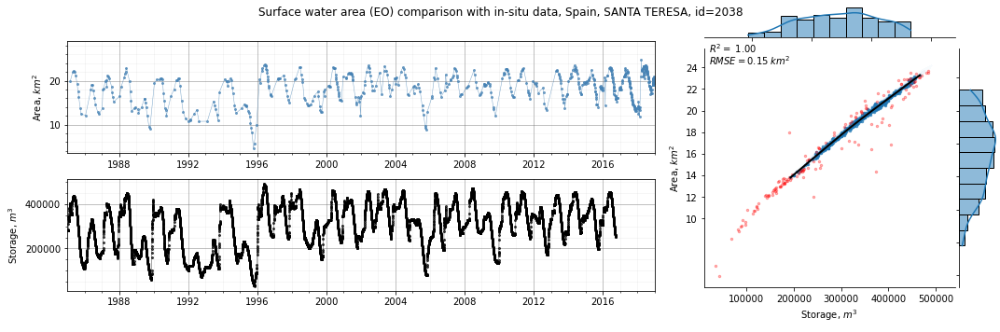

 32%|█████████████████████████▊                                                      | 101/313 [04:55<11:09,  3.16s/it]

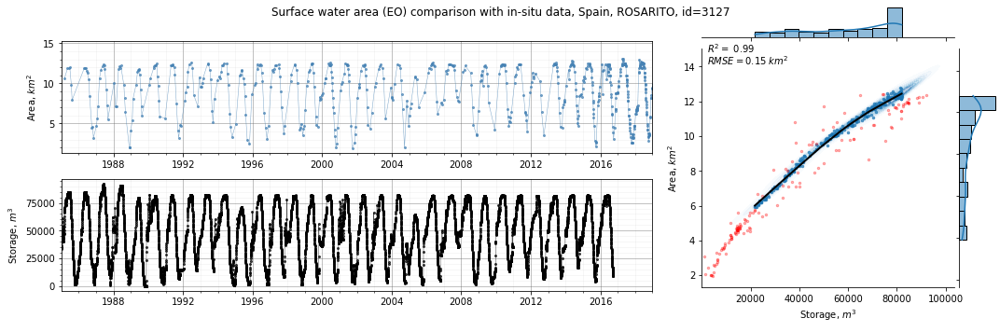

 33%|██████████████████████████                                                      | 102/313 [04:58<10:28,  2.98s/it]

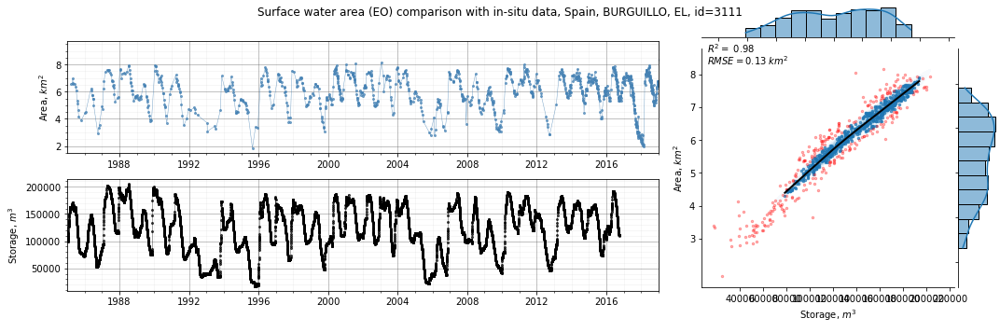

 33%|██████████████████████████▎                                                     | 103/313 [05:01<10:27,  2.99s/it]

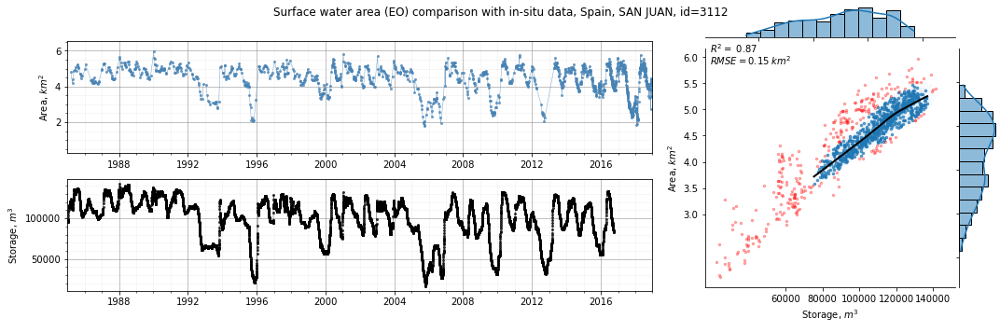

 33%|██████████████████████████▌                                                     | 104/313 [05:04<10:14,  2.94s/it]

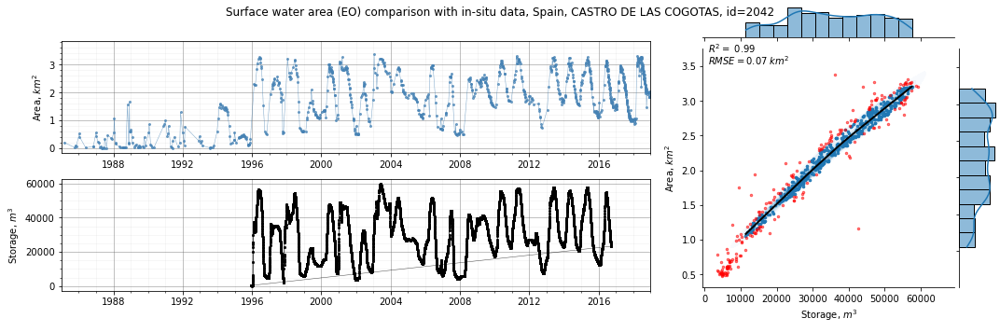

 34%|██████████████████████████▊                                                     | 105/313 [05:07<10:50,  3.13s/it]

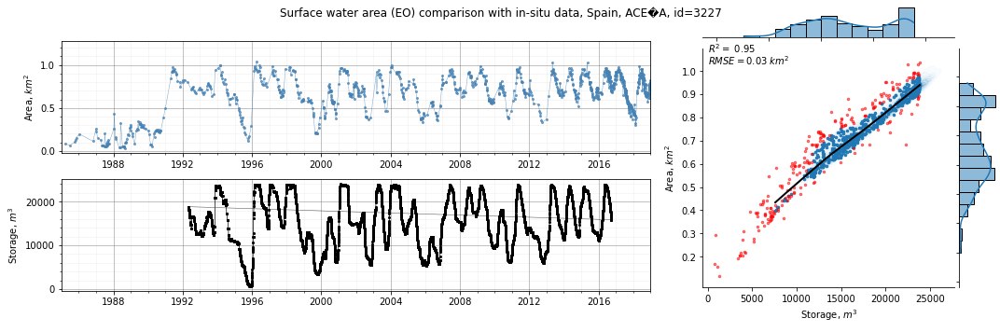

 34%|███████████████████████████                                                     | 106/313 [05:11<11:10,  3.24s/it]

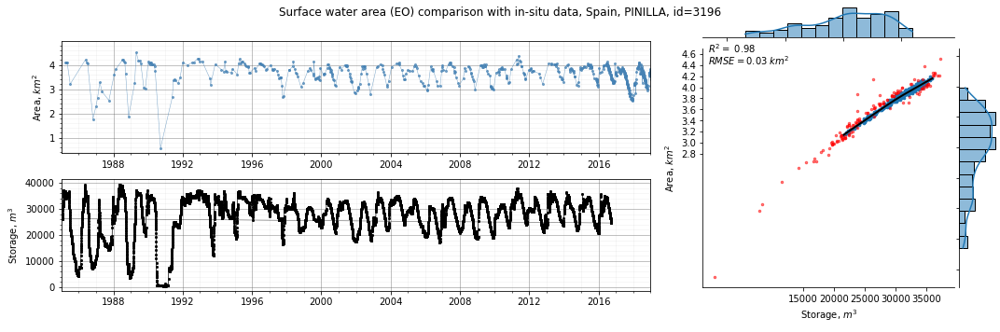

 34%|███████████████████████████▎                                                    | 107/313 [05:14<11:05,  3.23s/it]

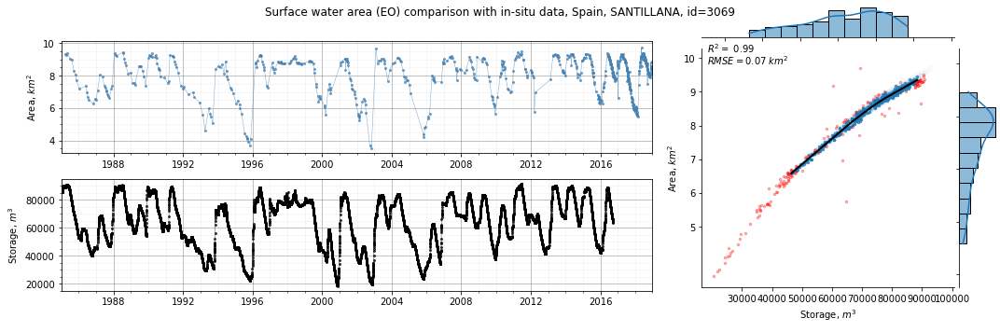

 35%|███████████████████████████▌                                                    | 108/313 [05:17<10:41,  3.13s/it]

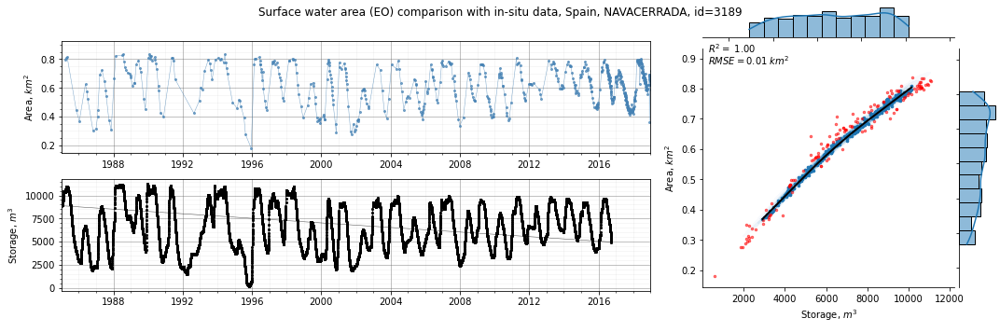

 35%|███████████████████████████▊                                                    | 109/313 [05:20<10:58,  3.23s/it]

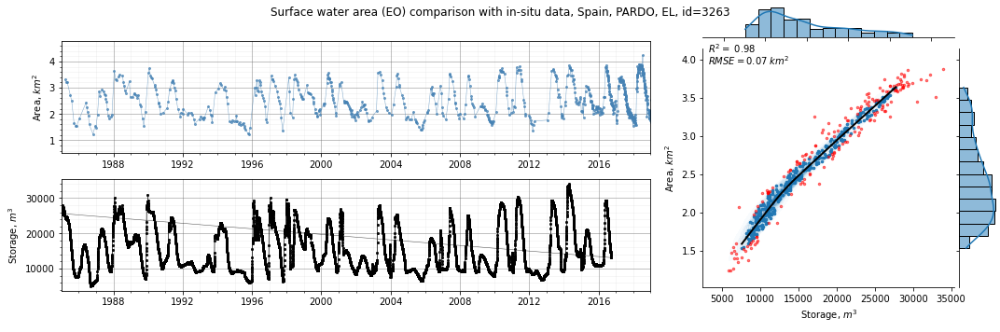

 35%|████████████████████████████                                                    | 110/313 [05:24<11:11,  3.31s/it]

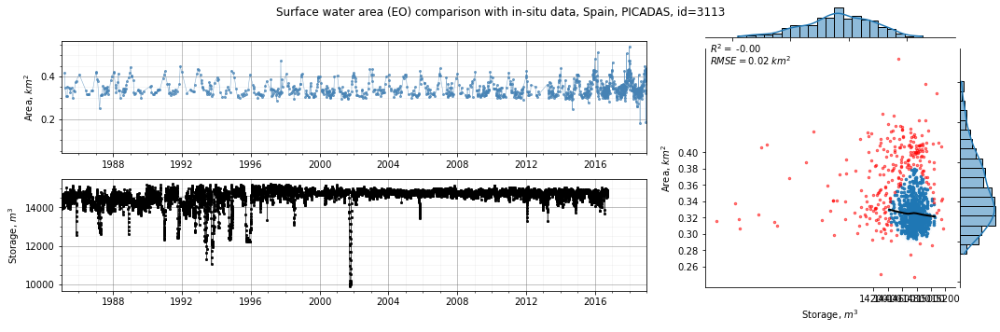

 35%|████████████████████████████▎                                                   | 111/313 [05:27<10:59,  3.27s/it]

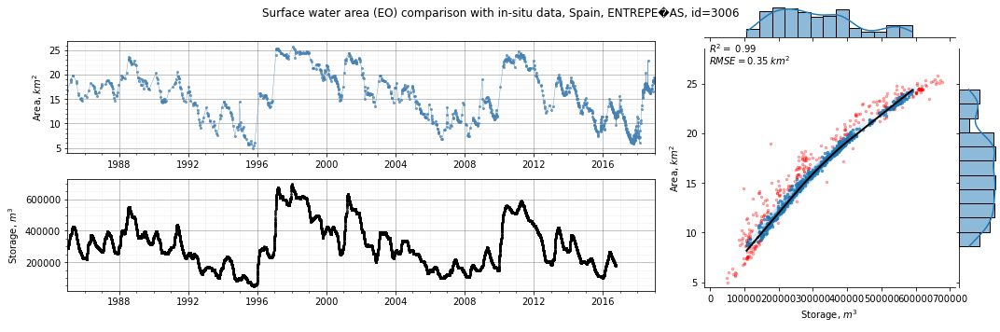

 36%|████████████████████████████▋                                                   | 112/313 [05:30<10:55,  3.26s/it]

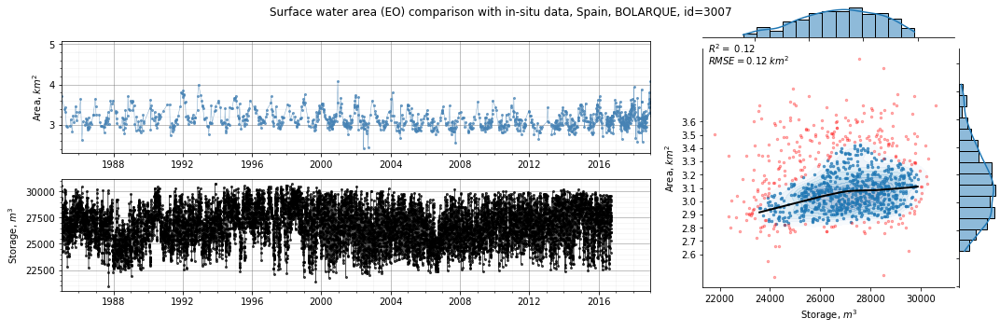

 36%|████████████████████████████▉                                                   | 113/313 [05:33<10:27,  3.14s/it]

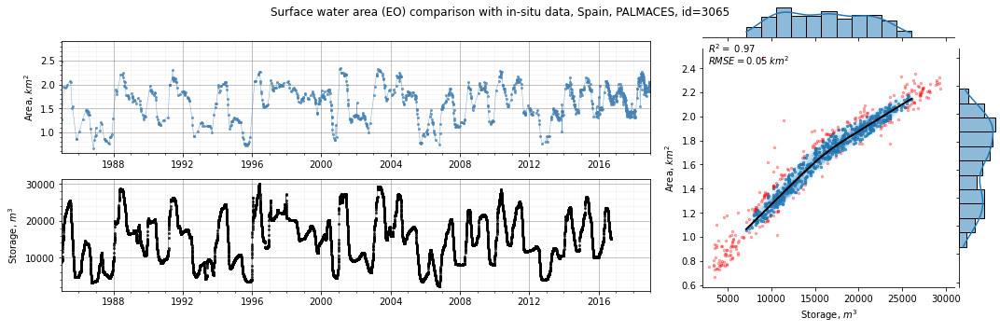

 36%|█████████████████████████████▏                                                  | 114/313 [05:36<10:17,  3.11s/it]

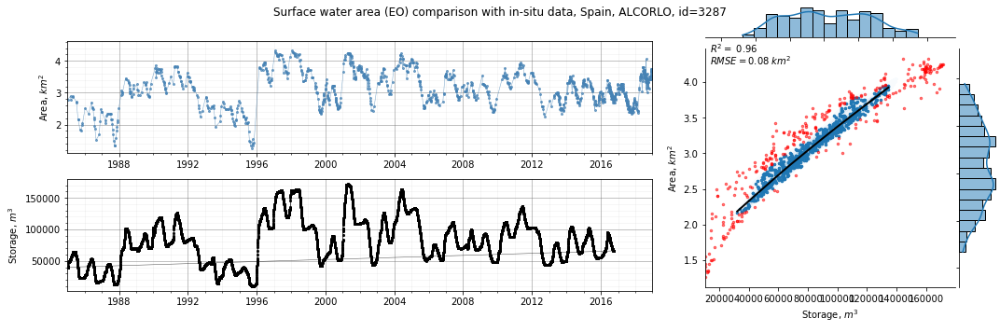

 37%|█████████████████████████████▍                                                  | 115/313 [05:41<11:40,  3.54s/it]

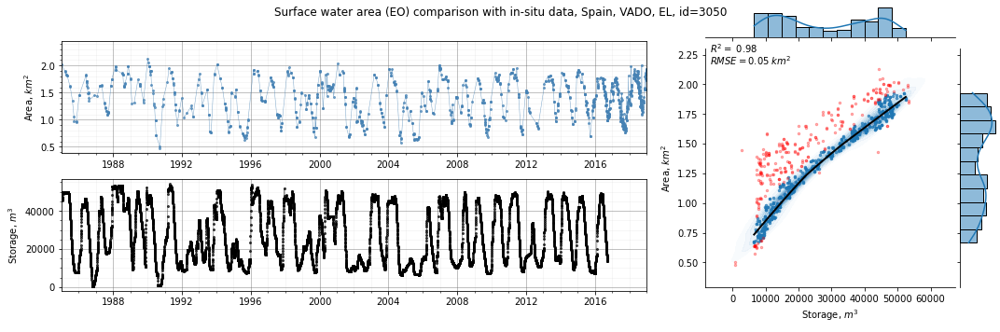

 37%|█████████████████████████████▋                                                  | 116/313 [05:44<10:57,  3.34s/it]

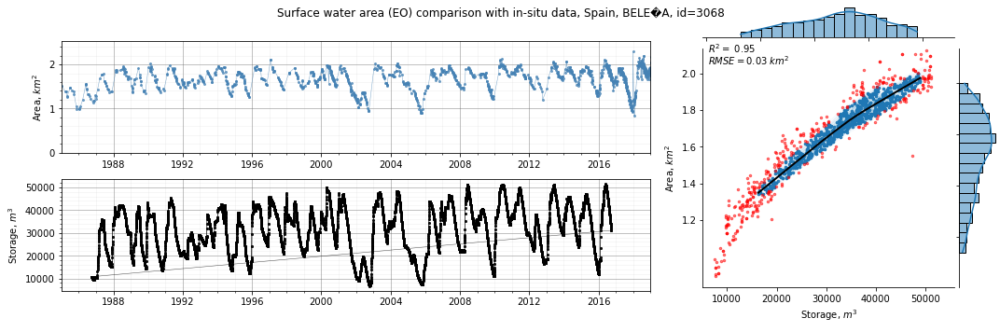

 37%|█████████████████████████████▉                                                  | 117/313 [05:48<12:05,  3.70s/it]

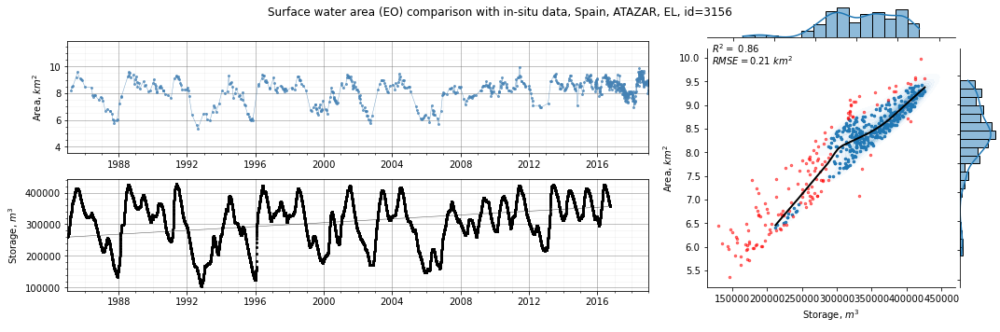

 38%|██████████████████████████████▏                                                 | 118/313 [05:51<11:26,  3.52s/it]

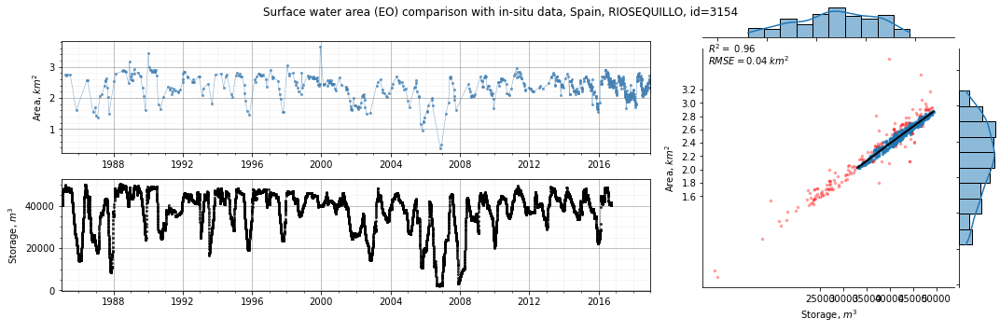

 38%|██████████████████████████████▍                                                 | 119/313 [05:54<10:24,  3.22s/it]

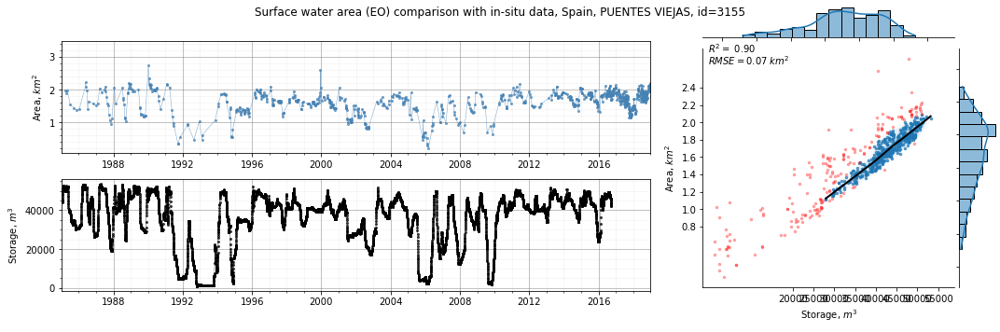

 38%|██████████████████████████████▋                                                 | 120/313 [05:56<09:53,  3.07s/it]

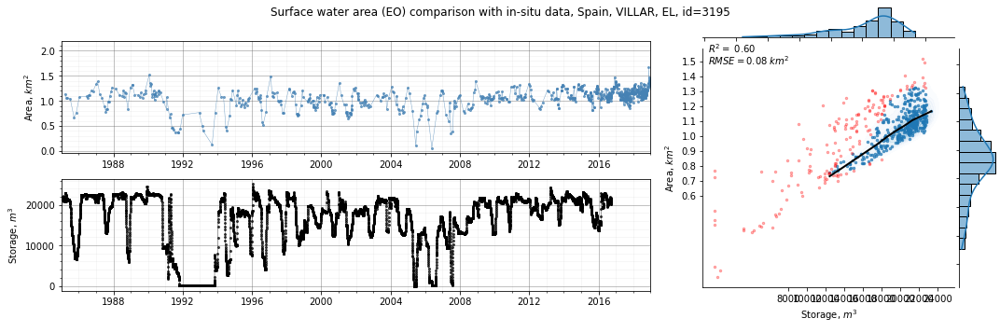

 39%|██████████████████████████████▉                                                 | 121/313 [05:59<09:14,  2.89s/it]

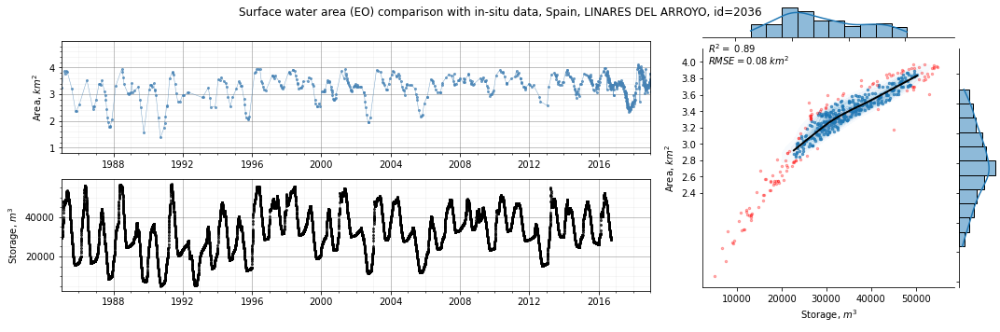

 39%|███████████████████████████████▏                                                | 122/313 [06:01<08:48,  2.77s/it]

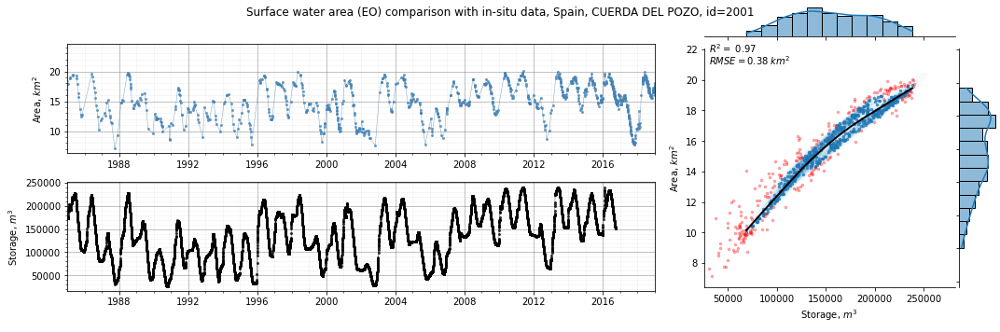

 39%|███████████████████████████████▍                                                | 123/313 [06:04<09:00,  2.85s/it]

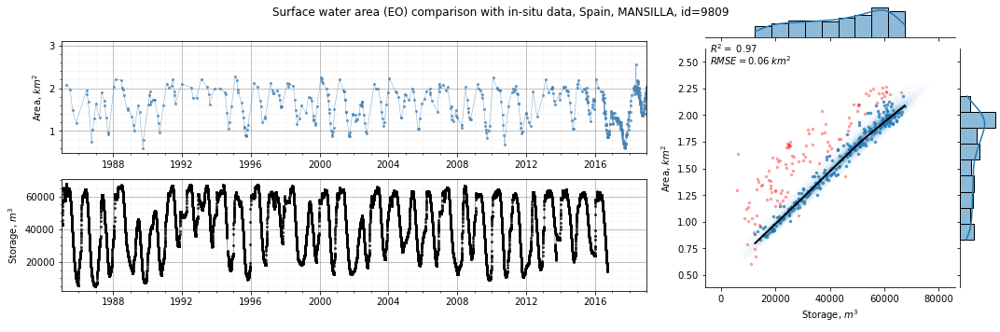

 40%|███████████████████████████████▋                                                | 124/313 [06:07<08:38,  2.74s/it]

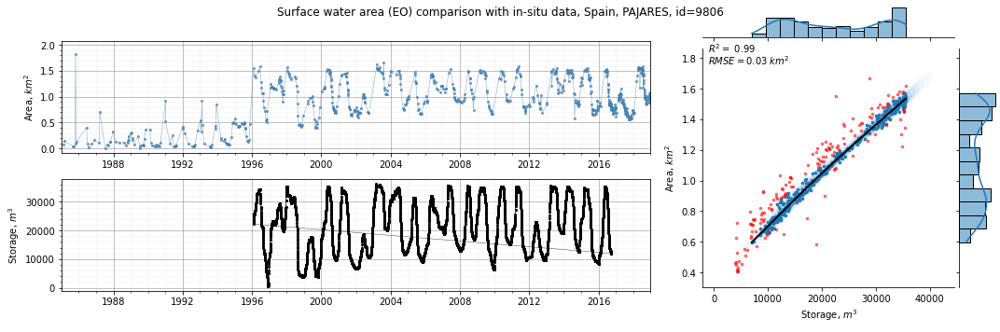

 40%|███████████████████████████████▉                                                | 125/313 [06:10<08:57,  2.86s/it]

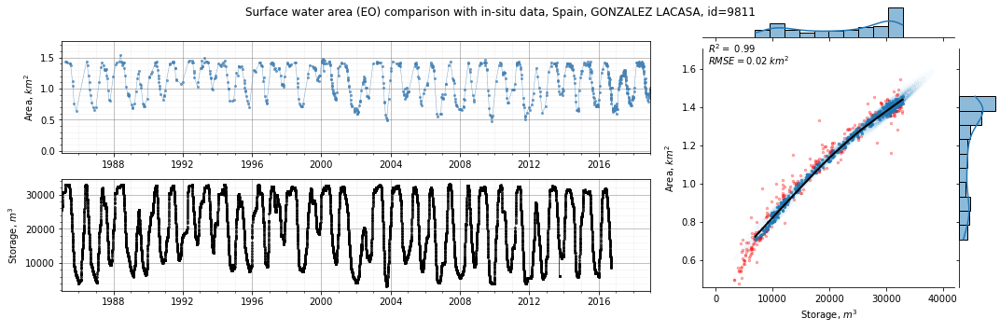

 40%|████████████████████████████████▏                                               | 126/313 [06:13<08:46,  2.82s/it]

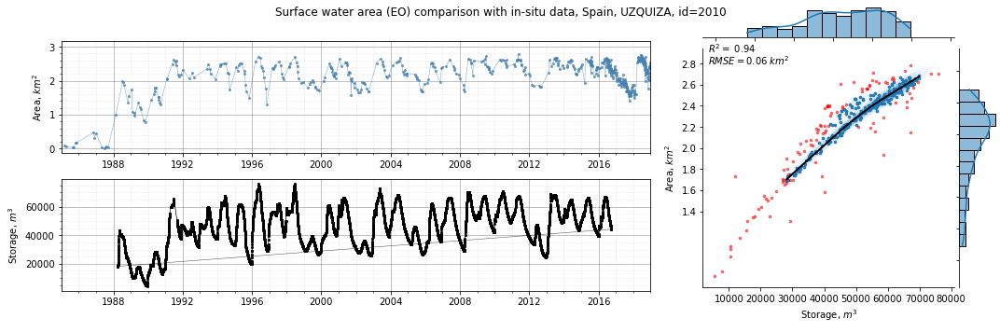

 41%|████████████████████████████████▍                                               | 127/313 [06:16<08:42,  2.81s/it]

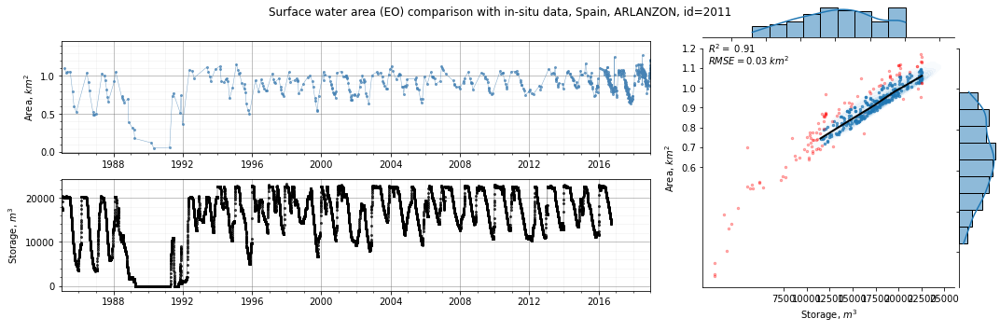

 41%|████████████████████████████████▋                                               | 128/313 [06:18<08:05,  2.63s/it]

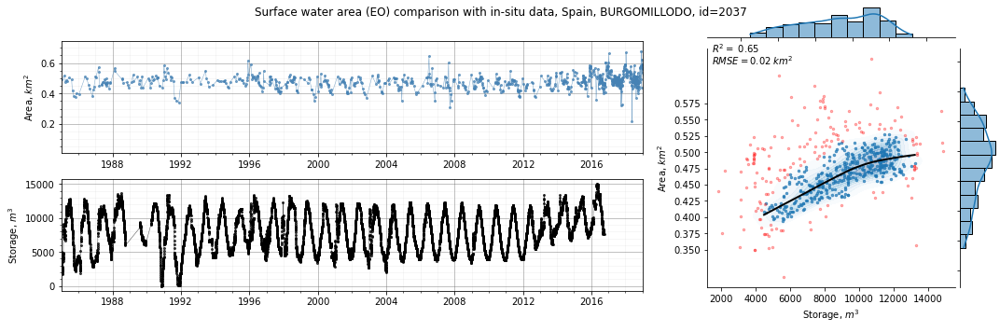

 41%|████████████████████████████████▉                                               | 129/313 [06:20<07:54,  2.58s/it]

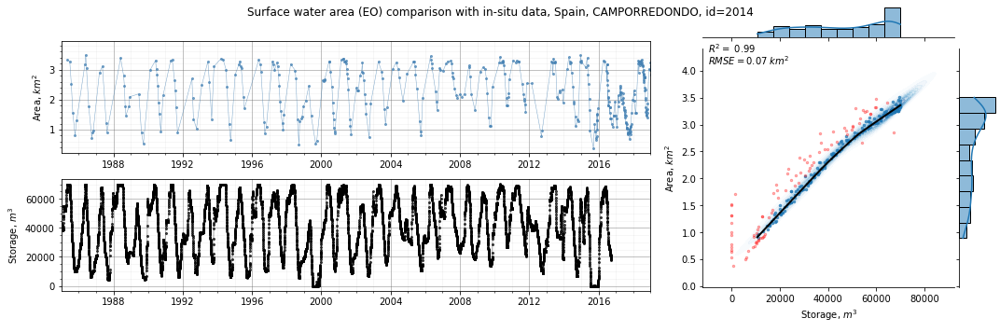

 42%|█████████████████████████████████▏                                              | 130/313 [06:22<07:34,  2.48s/it]

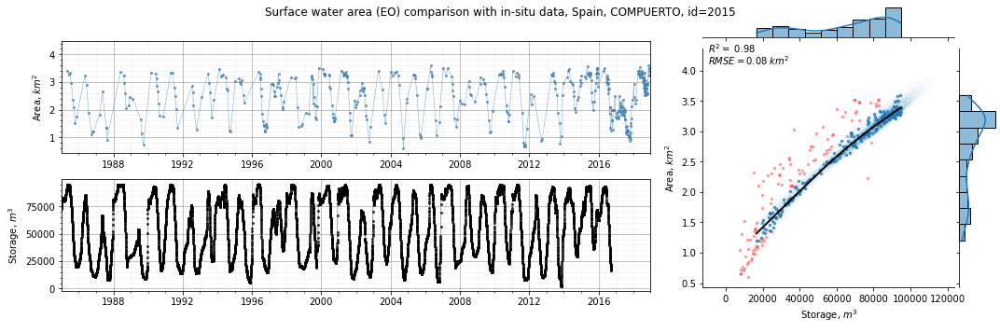

 42%|█████████████████████████████████▍                                              | 131/313 [06:25<07:29,  2.47s/it]

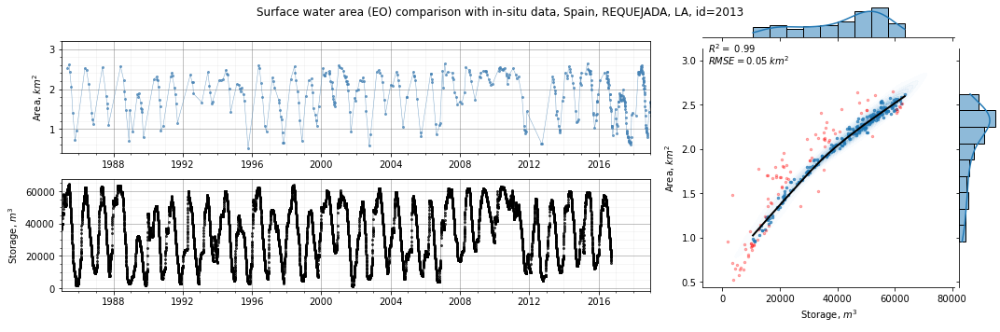

 42%|█████████████████████████████████▋                                              | 132/313 [06:27<07:16,  2.41s/it]

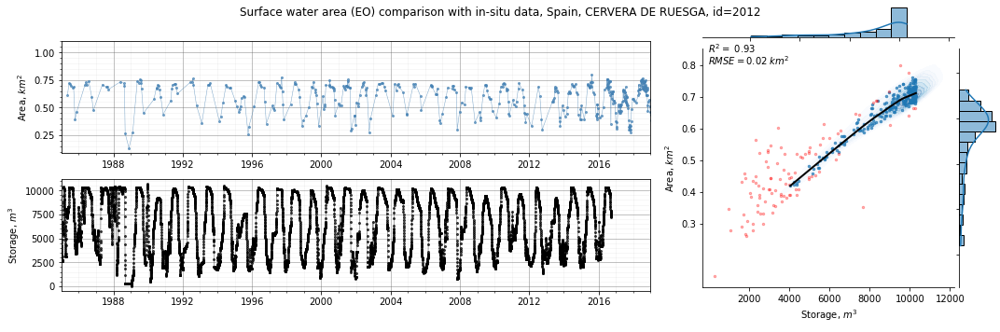

 42%|█████████████████████████████████▉                                              | 133/313 [06:30<07:15,  2.42s/it]

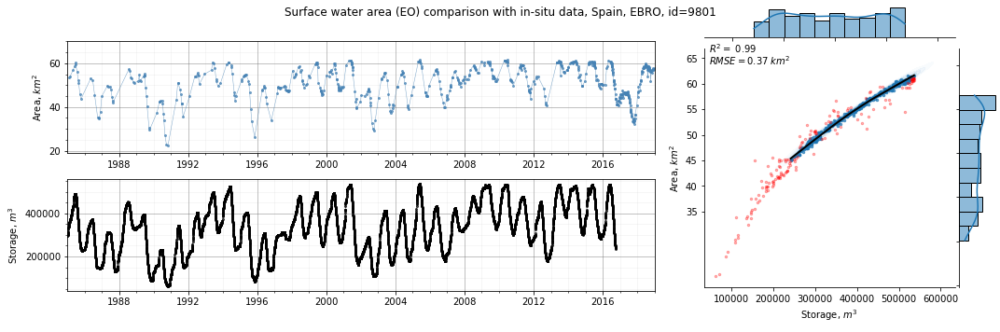

 43%|██████████████████████████████████▏                                             | 134/313 [06:32<07:21,  2.47s/it]

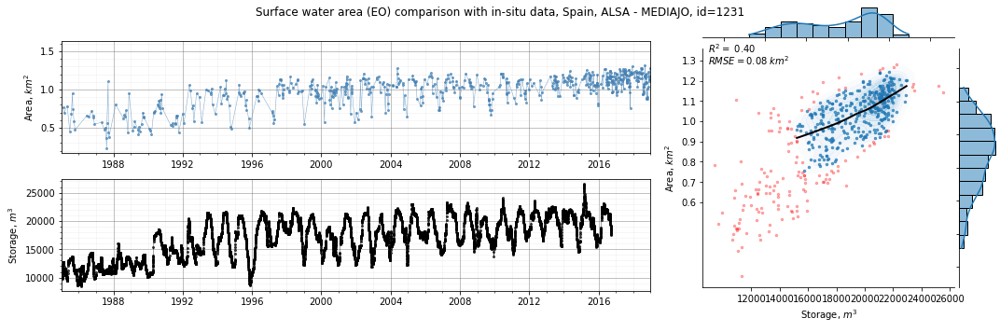

 43%|██████████████████████████████████▌                                             | 135/313 [06:35<07:18,  2.47s/it]

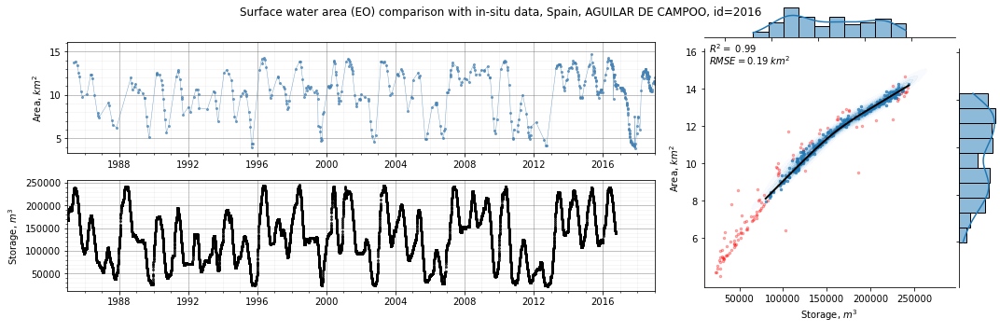

 43%|██████████████████████████████████▊                                             | 136/313 [06:37<07:13,  2.45s/it]

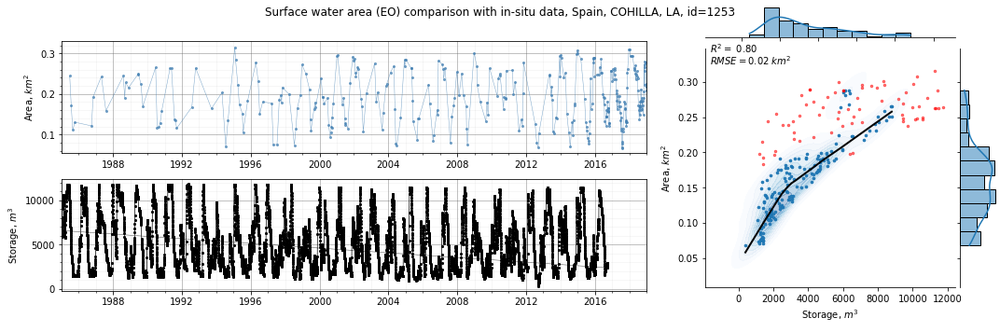

 44%|███████████████████████████████████                                             | 137/313 [06:40<07:21,  2.51s/it]

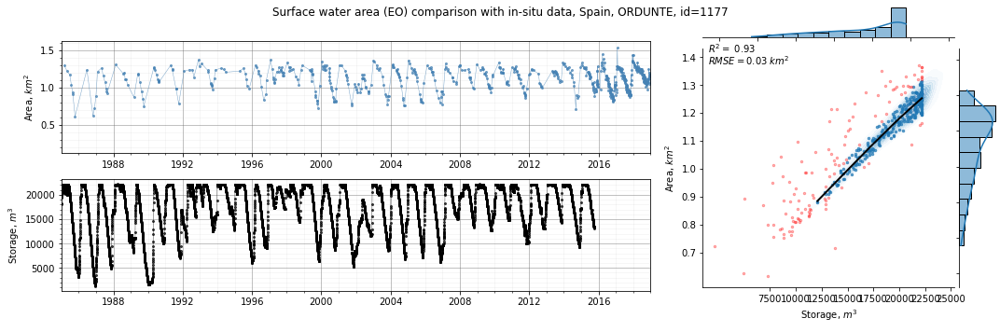

 44%|███████████████████████████████████▎                                            | 138/313 [06:42<07:15,  2.49s/it]

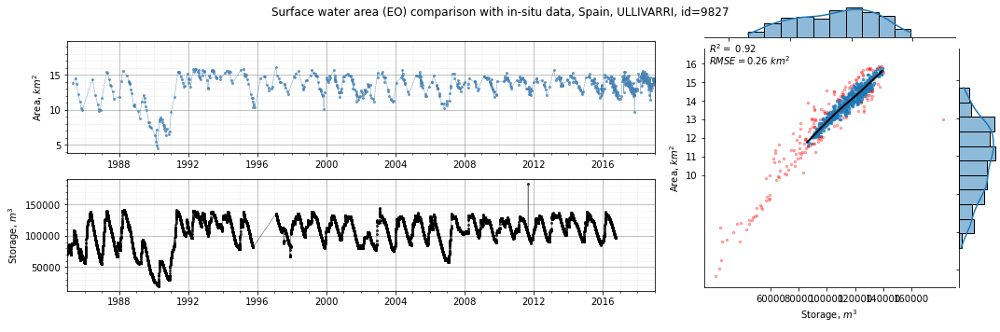

 44%|███████████████████████████████████▌                                            | 139/313 [06:45<07:04,  2.44s/it]

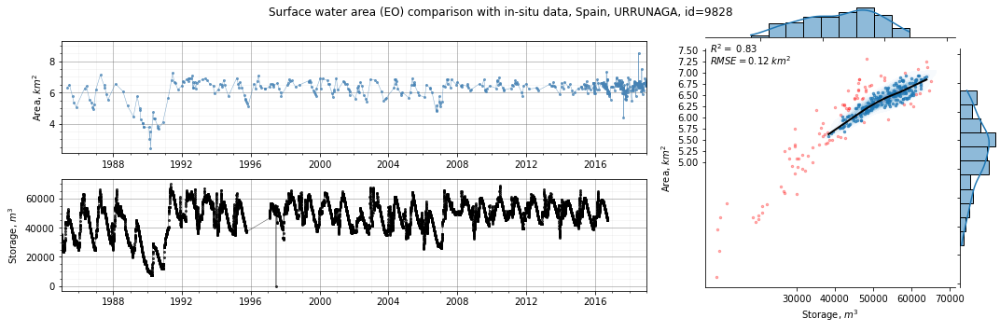

 45%|███████████████████████████████████▊                                            | 140/313 [06:47<06:51,  2.38s/it]

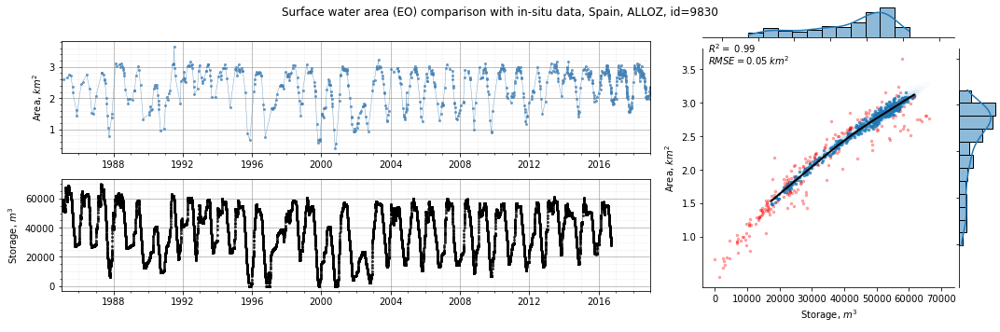

 45%|████████████████████████████████████                                            | 141/313 [06:49<06:56,  2.42s/it]

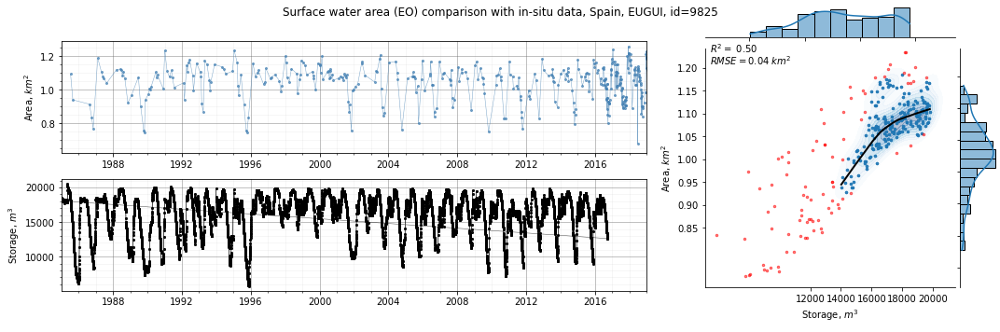

 45%|████████████████████████████████████▎                                           | 142/313 [06:52<06:52,  2.41s/it]

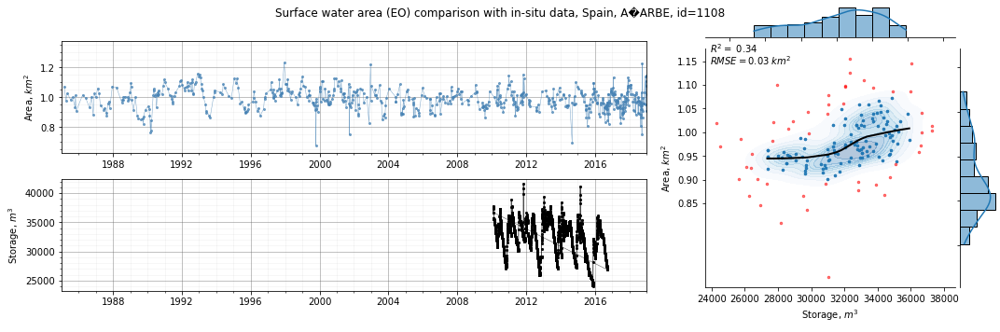

 46%|████████████████████████████████████▌                                           | 143/313 [06:53<06:19,  2.23s/it]

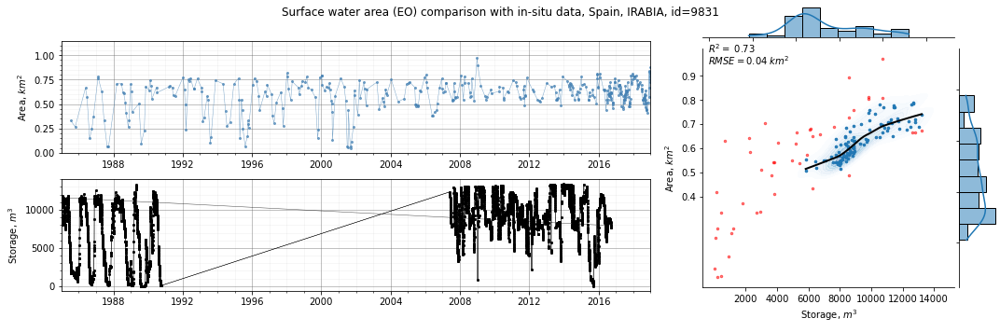

 46%|████████████████████████████████████▊                                           | 144/313 [06:55<06:06,  2.17s/it]

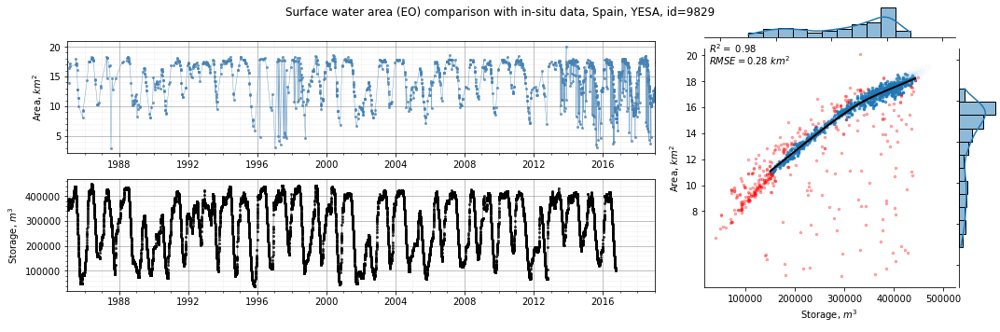

 46%|█████████████████████████████████████                                           | 145/313 [06:59<06:54,  2.46s/it]

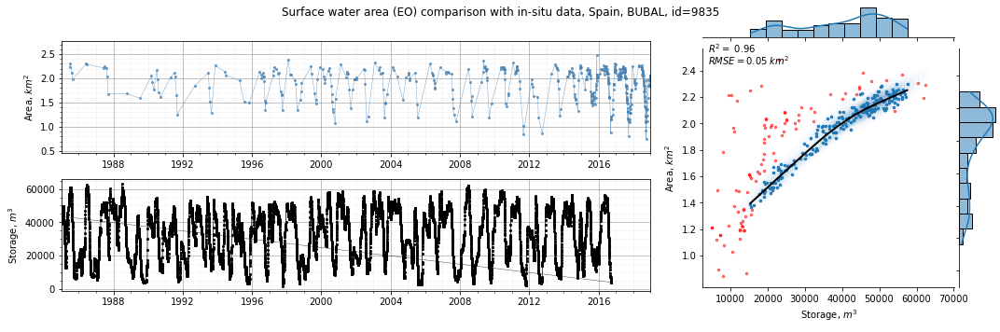

 47%|█████████████████████████████████████▎                                          | 146/313 [07:01<07:09,  2.57s/it]

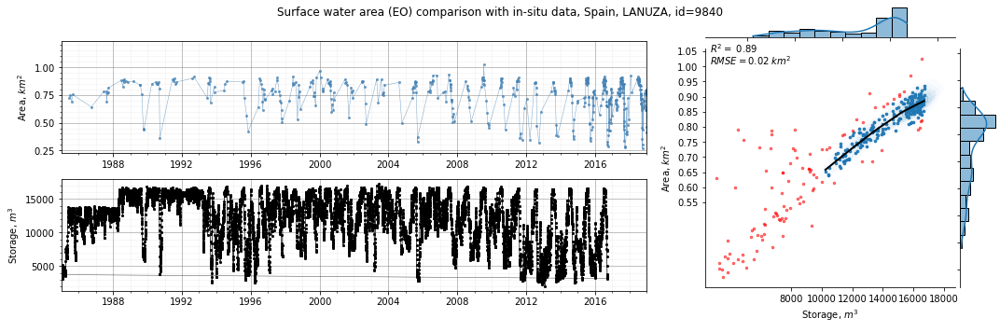

 47%|█████████████████████████████████████▌                                          | 147/313 [07:04<07:13,  2.61s/it]

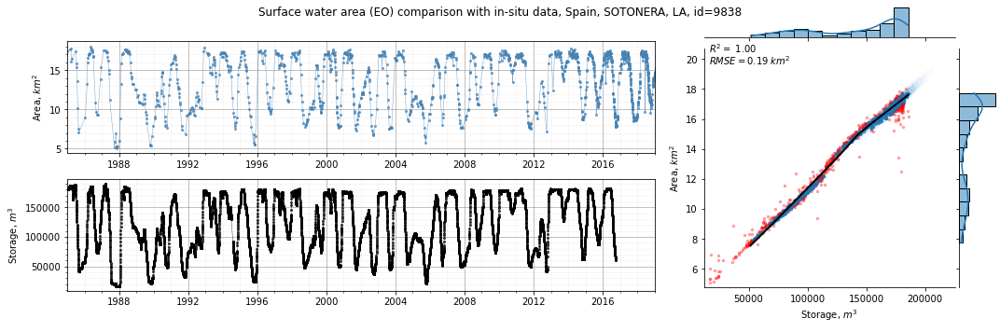

 47%|█████████████████████████████████████▊                                          | 148/313 [07:08<07:58,  2.90s/it]

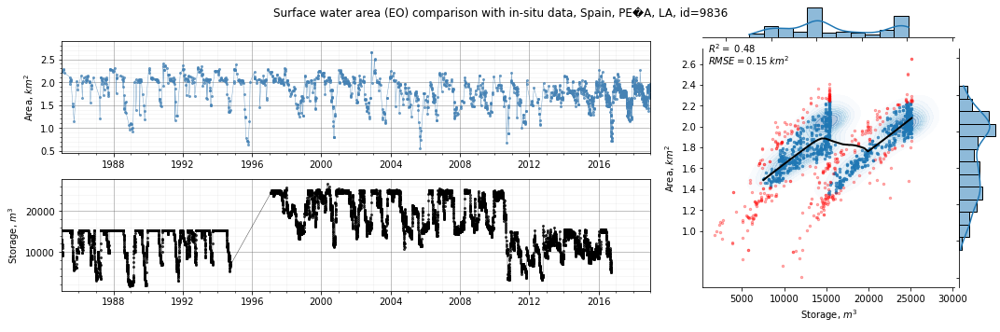

 48%|██████████████████████████████████████                                          | 149/313 [07:11<07:49,  2.87s/it]

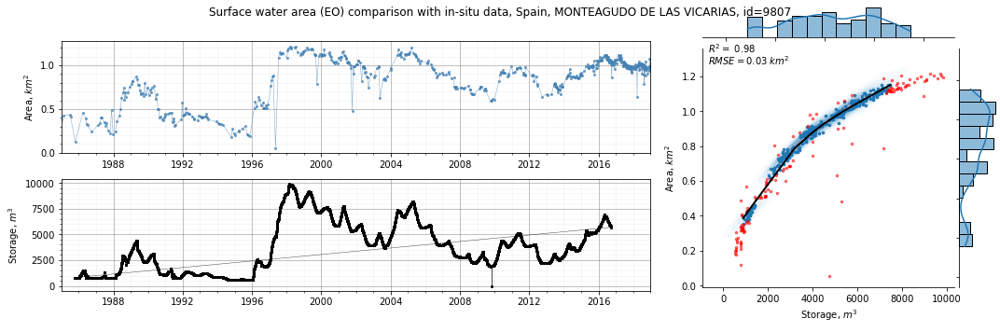

 48%|██████████████████████████████████████▎                                         | 150/313 [07:13<07:46,  2.86s/it]

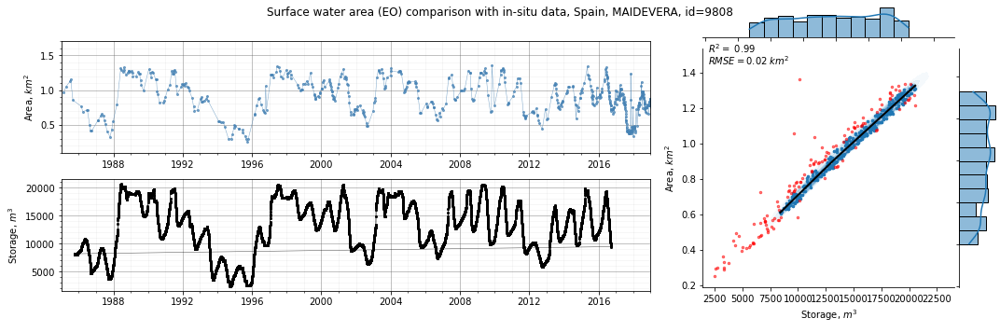

 48%|██████████████████████████████████████▌                                         | 151/313 [07:17<08:01,  2.97s/it]

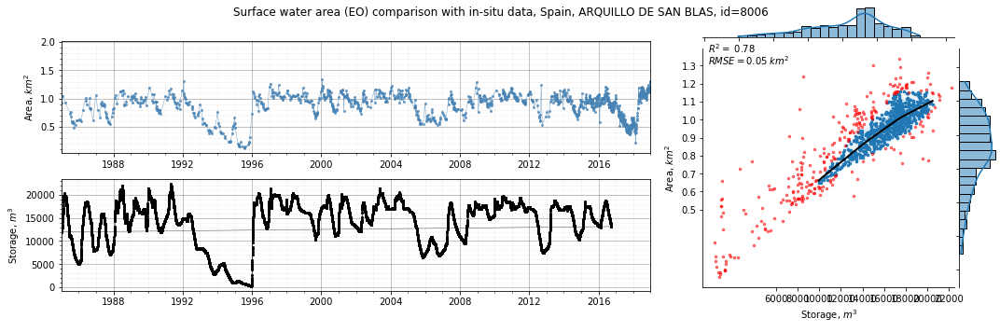

 49%|██████████████████████████████████████▊                                         | 152/313 [07:20<08:35,  3.20s/it]

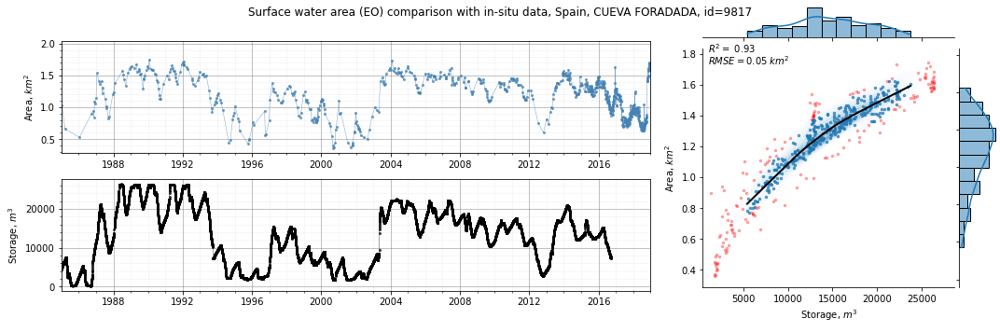

 49%|███████████████████████████████████████                                         | 153/313 [07:23<07:55,  2.97s/it]

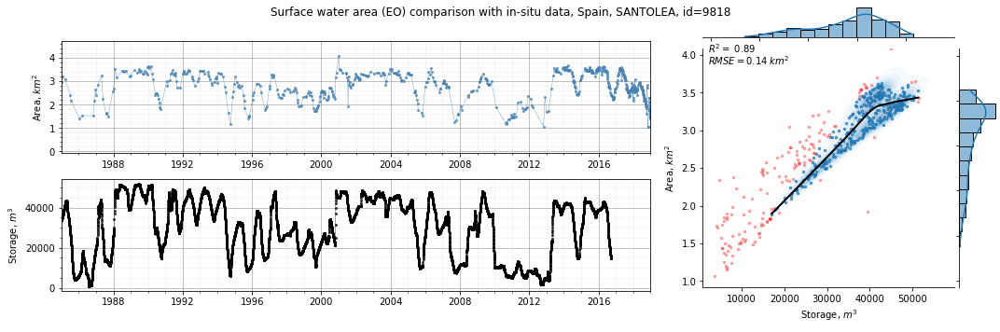

 49%|███████████████████████████████████████▎                                        | 154/313 [07:25<07:23,  2.79s/it]

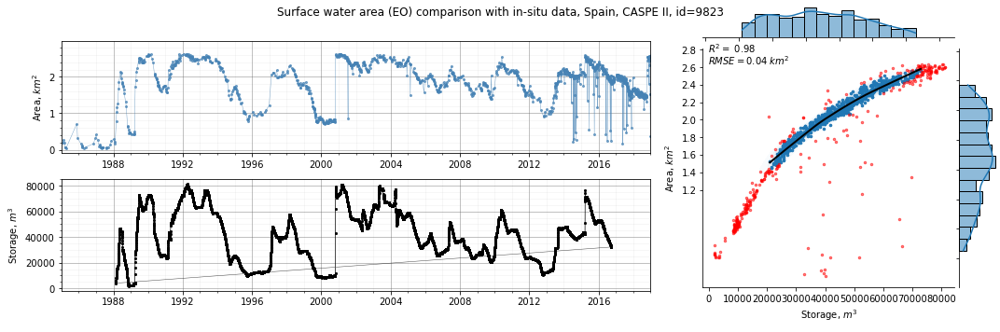

 50%|███████████████████████████████████████▌                                        | 155/313 [07:30<08:39,  3.29s/it]

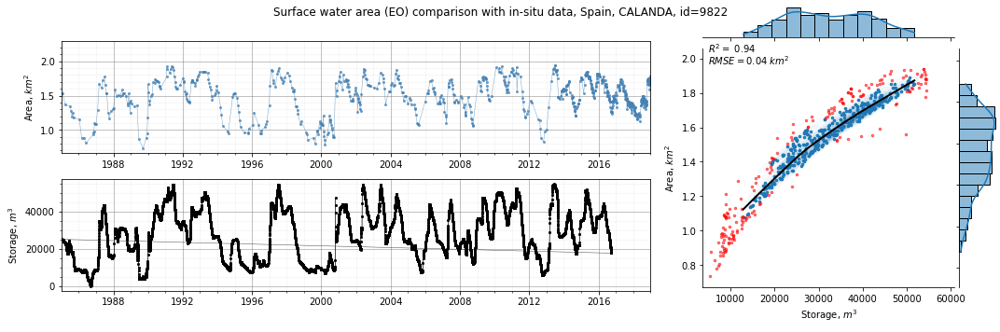

 50%|███████████████████████████████████████▊                                        | 156/313 [07:33<08:31,  3.26s/it]

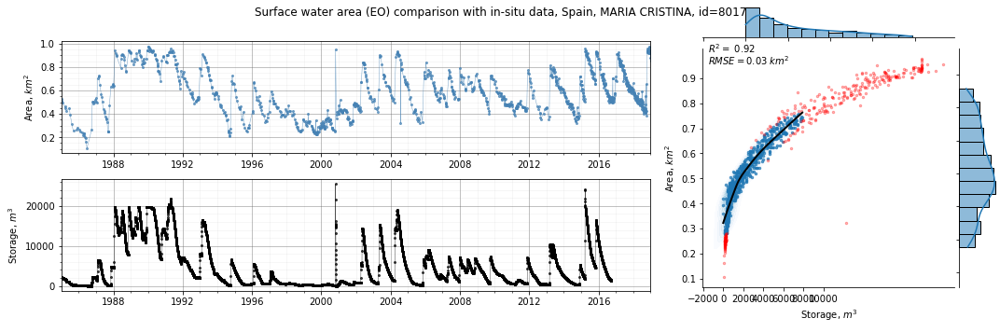

 50%|████████████████████████████████████████▏                                       | 157/313 [07:36<08:10,  3.14s/it]

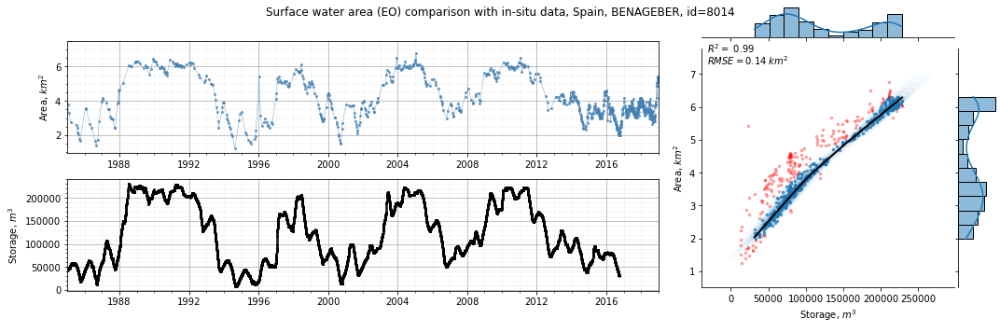

 50%|████████████████████████████████████████▍                                       | 158/313 [07:38<07:47,  3.02s/it]

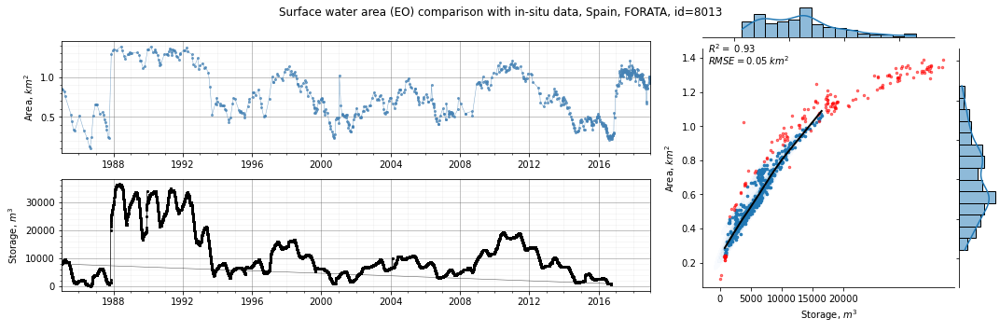

 51%|████████████████████████████████████████▋                                       | 159/313 [07:42<07:56,  3.09s/it]

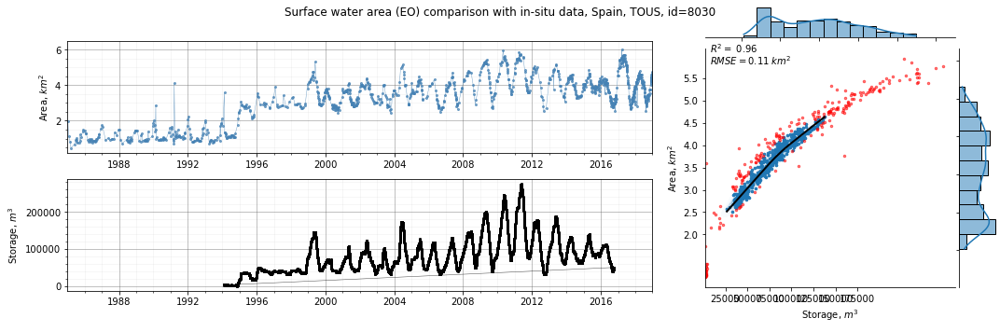

 51%|████████████████████████████████████████▉                                       | 160/313 [07:45<08:15,  3.24s/it]

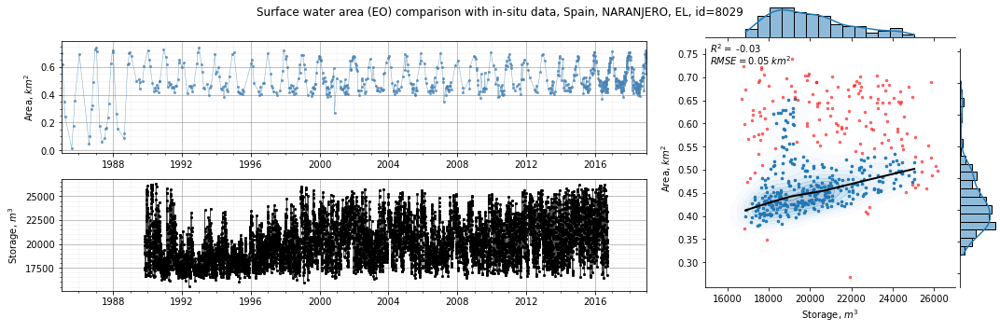

 51%|█████████████████████████████████████████▏                                      | 161/313 [07:48<08:00,  3.16s/it]

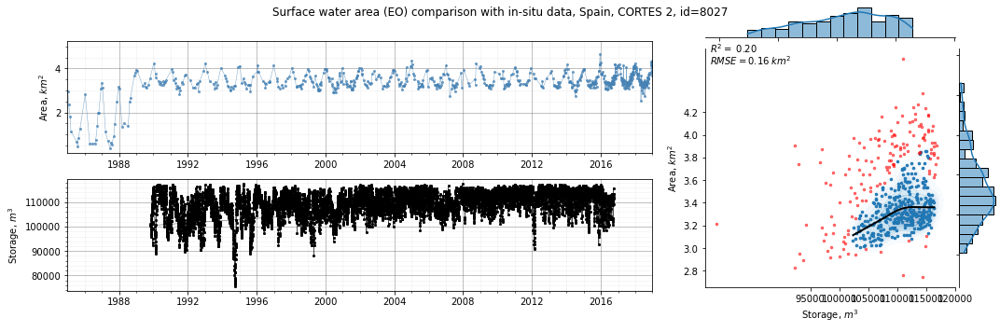

 52%|█████████████████████████████████████████▍                                      | 162/313 [07:51<07:41,  3.06s/it]

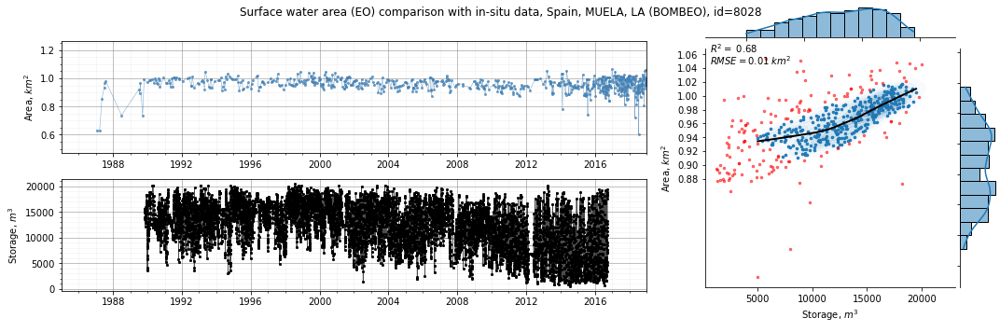

 52%|█████████████████████████████████████████▋                                      | 163/313 [07:54<07:36,  3.04s/it]

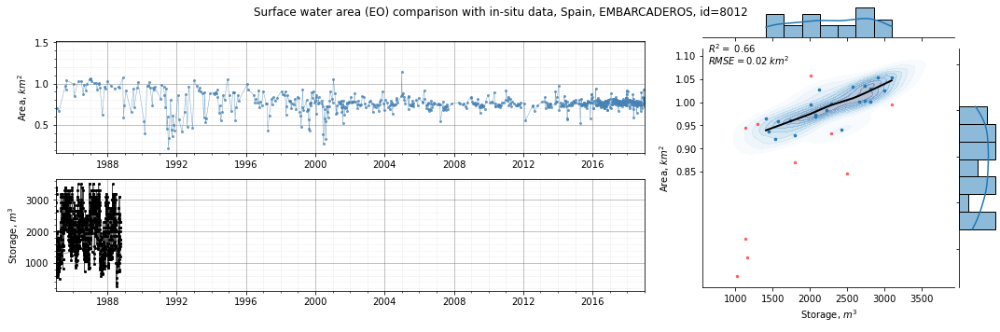

 52%|█████████████████████████████████████████▉                                      | 164/313 [07:56<06:40,  2.69s/it]

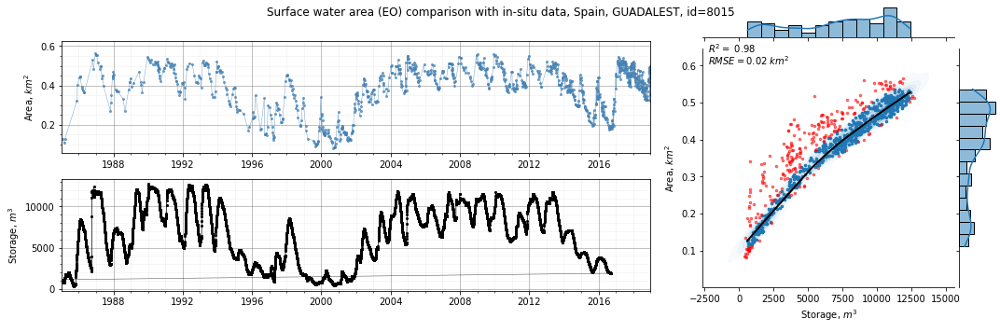

 53%|██████████████████████████████████████████▏                                     | 165/313 [08:00<07:35,  3.07s/it]

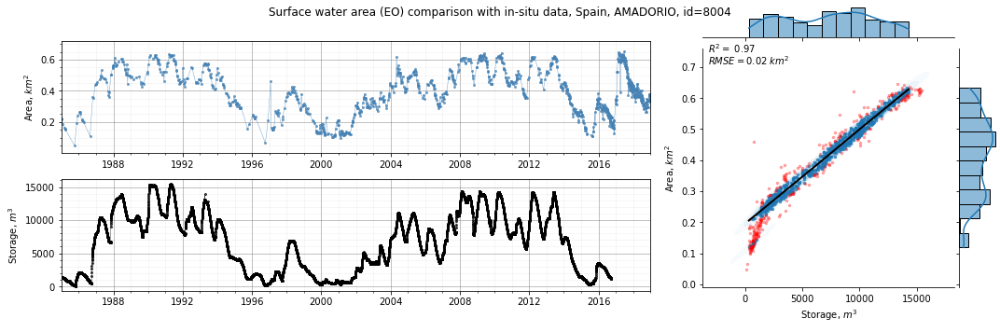

 53%|██████████████████████████████████████████▍                                     | 166/313 [08:03<07:36,  3.10s/it]

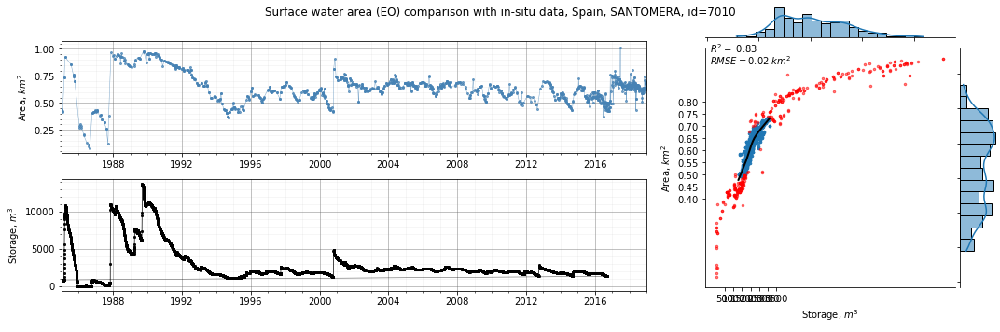

 53%|██████████████████████████████████████████▋                                     | 167/313 [08:07<07:54,  3.25s/it]

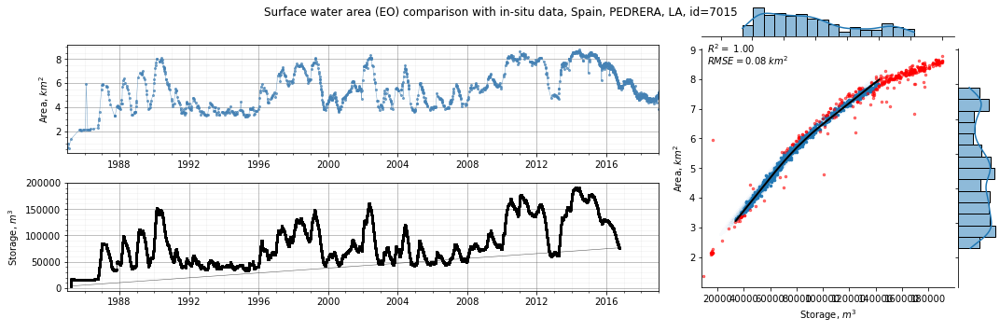

 54%|██████████████████████████████████████████▉                                     | 168/313 [08:12<09:12,  3.81s/it]

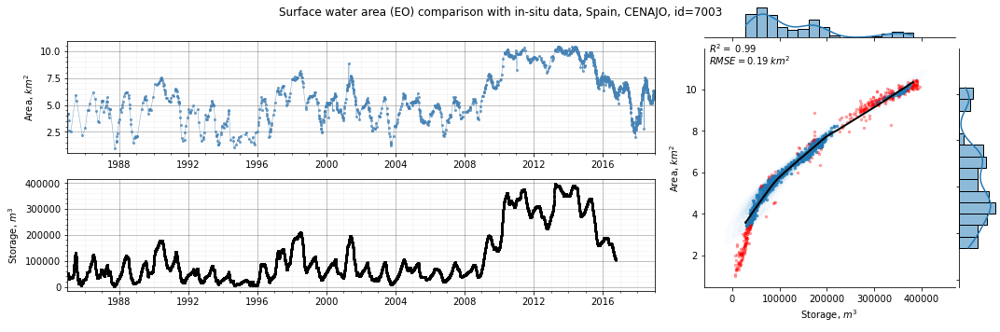

 54%|███████████████████████████████████████████▏                                    | 169/313 [08:15<08:53,  3.70s/it]

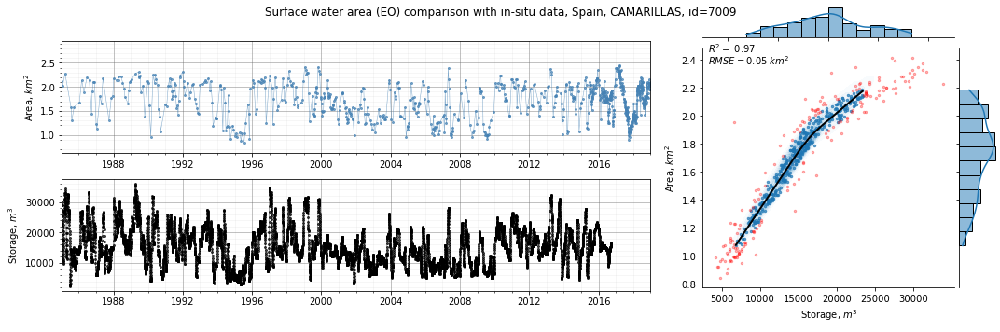

 54%|███████████████████████████████████████████▍                                    | 170/313 [08:18<08:02,  3.38s/it]

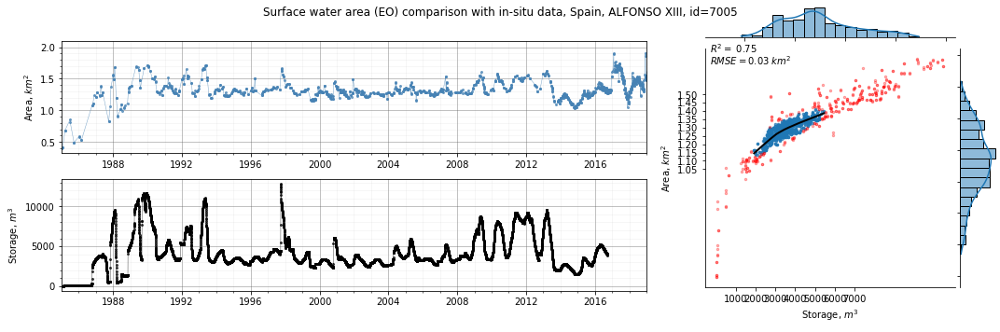

 55%|███████████████████████████████████████████▋                                    | 171/313 [08:21<07:35,  3.21s/it]

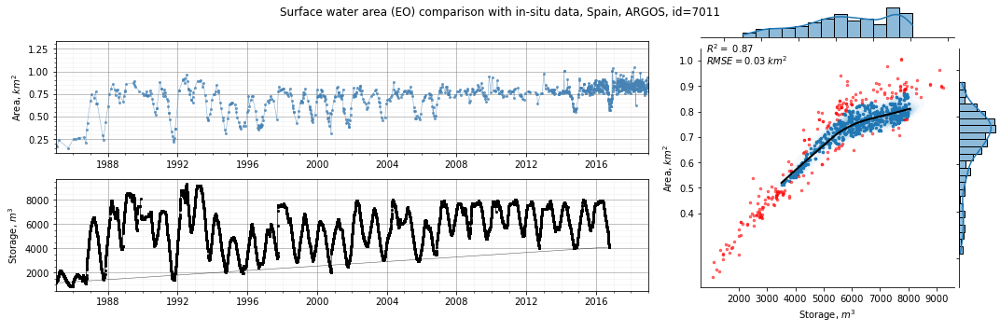

 55%|███████████████████████████████████████████▉                                    | 172/313 [08:24<07:22,  3.14s/it]

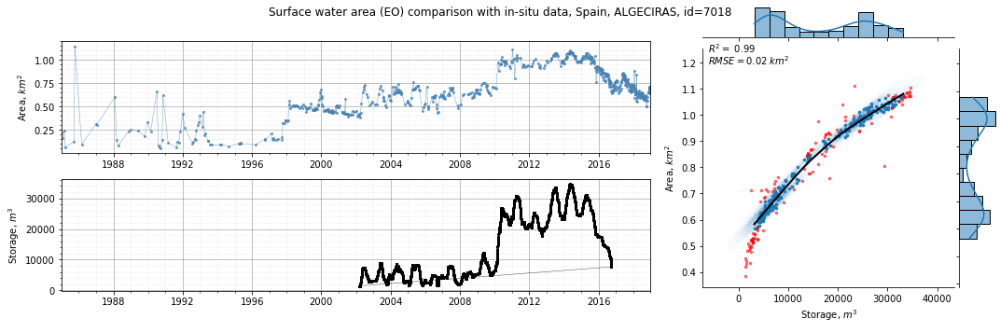

 55%|████████████████████████████████████████████▏                                   | 173/313 [08:26<06:50,  2.94s/it]

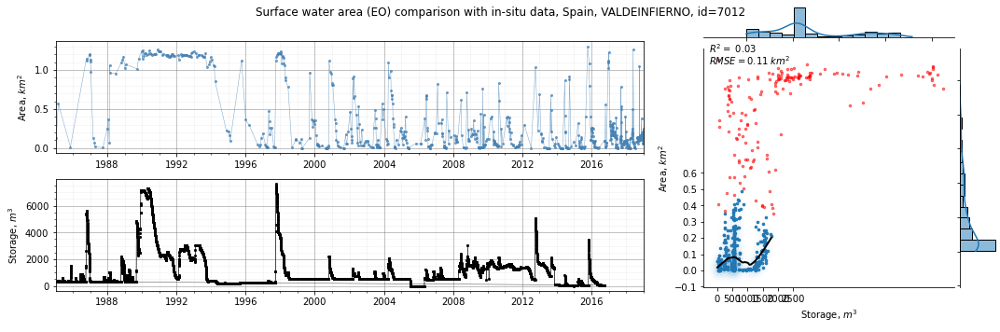

 56%|████████████████████████████████████████████▍                                   | 174/313 [08:29<06:29,  2.80s/it]

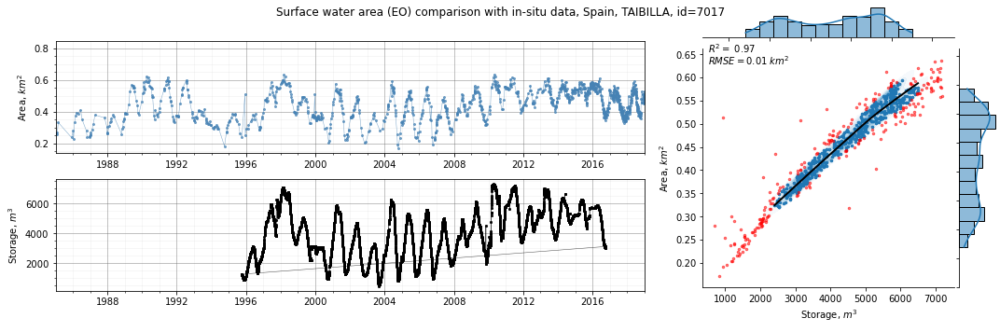

 56%|████████████████████████████████████████████▋                                   | 175/313 [08:32<06:44,  2.93s/it]

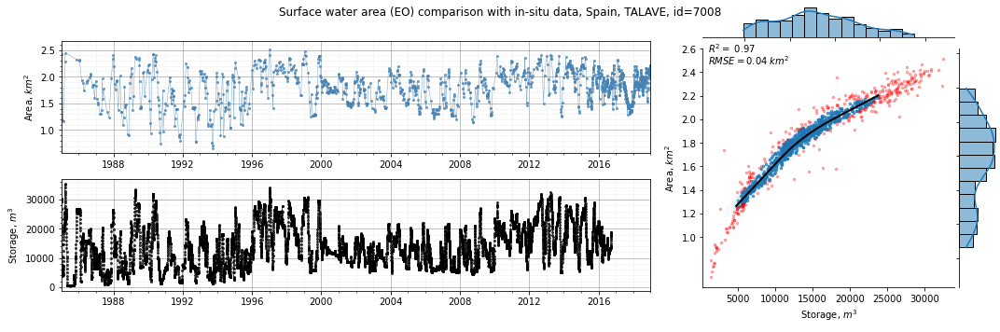

 56%|████████████████████████████████████████████▉                                   | 176/313 [08:35<06:39,  2.91s/it]

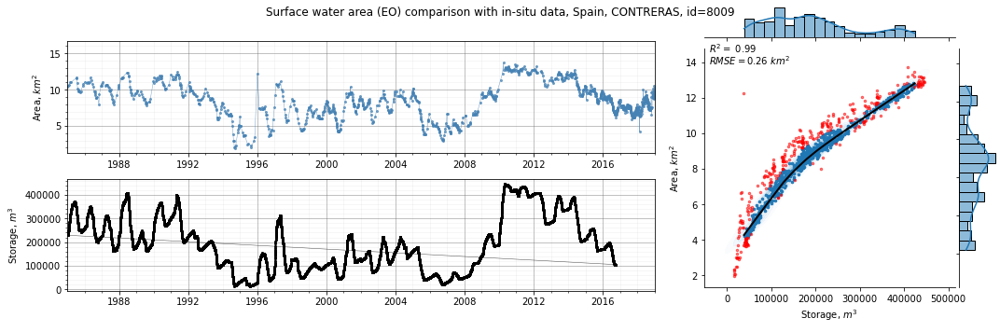

 57%|█████████████████████████████████████████████▏                                  | 177/313 [08:39<07:33,  3.33s/it]

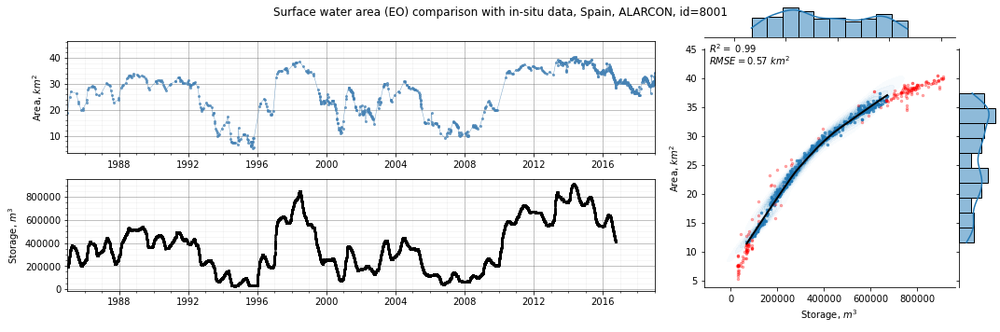

 57%|█████████████████████████████████████████████▍                                  | 178/313 [08:42<07:03,  3.13s/it]

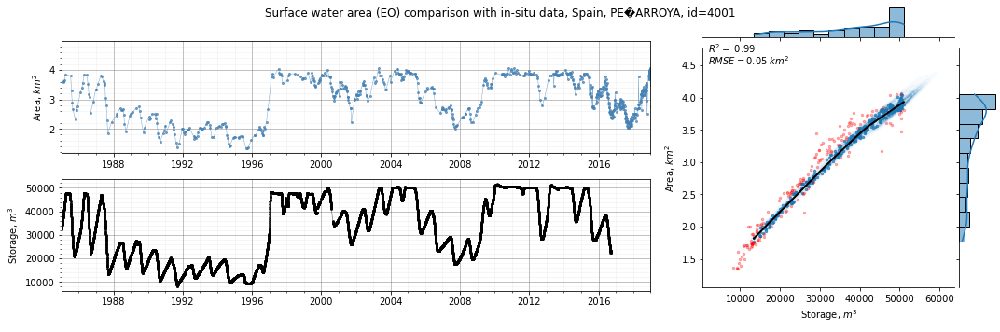

 57%|█████████████████████████████████████████████▊                                  | 179/313 [08:45<06:51,  3.07s/it]

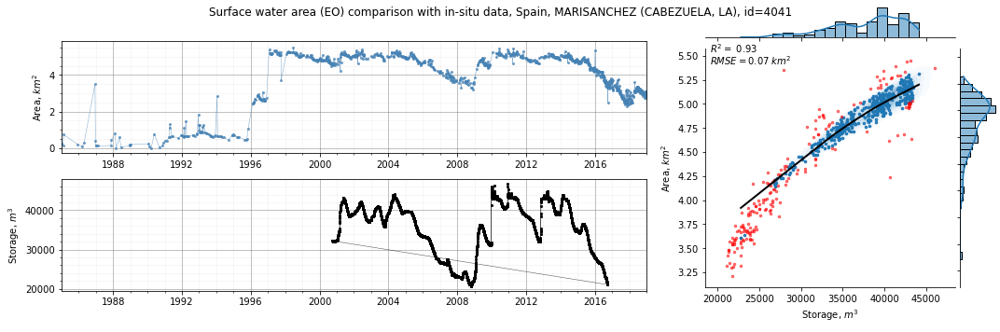

 58%|██████████████████████████████████████████████                                  | 180/313 [08:48<06:50,  3.08s/it]

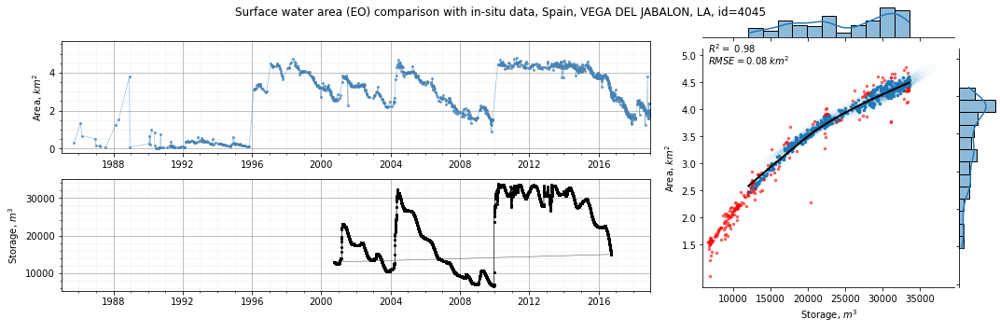

 58%|██████████████████████████████████████████████▎                                 | 181/313 [08:51<06:51,  3.12s/it]

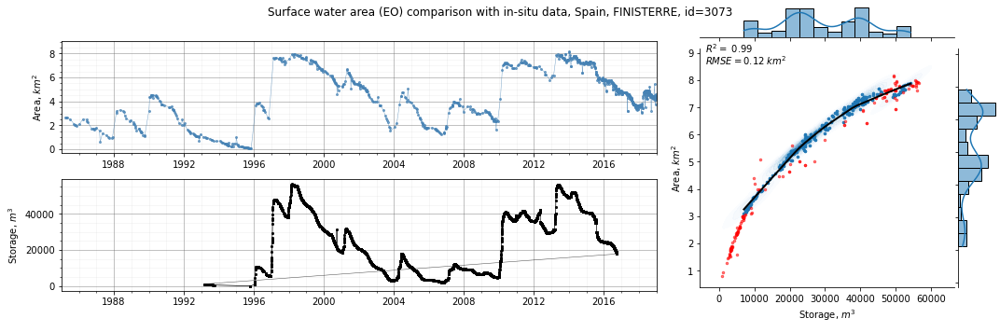

 58%|██████████████████████████████████████████████▌                                 | 182/313 [08:54<06:43,  3.08s/it]

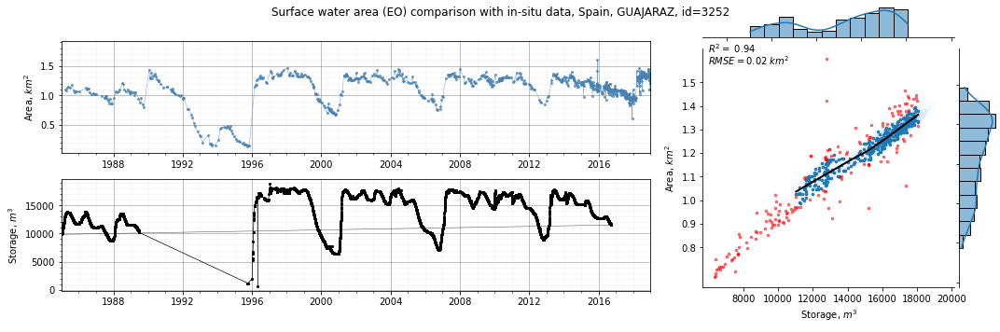

 58%|██████████████████████████████████████████████▊                                 | 183/313 [08:57<06:34,  3.04s/it]

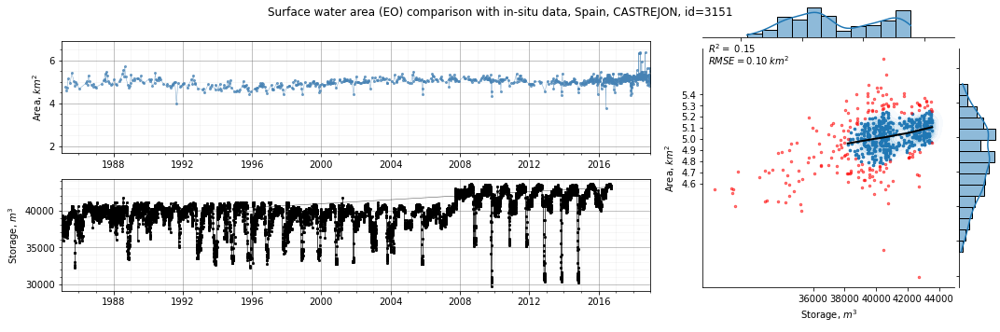

 59%|███████████████████████████████████████████████                                 | 184/313 [09:00<06:25,  2.99s/it]

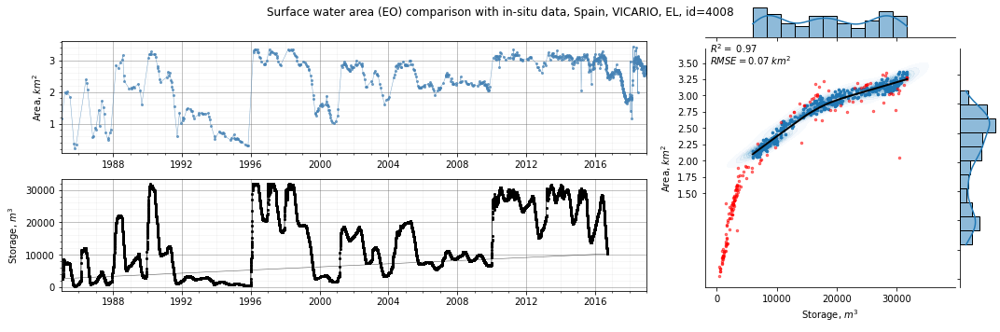

 59%|███████████████████████████████████████████████▎                                | 185/313 [09:03<06:24,  3.00s/it]

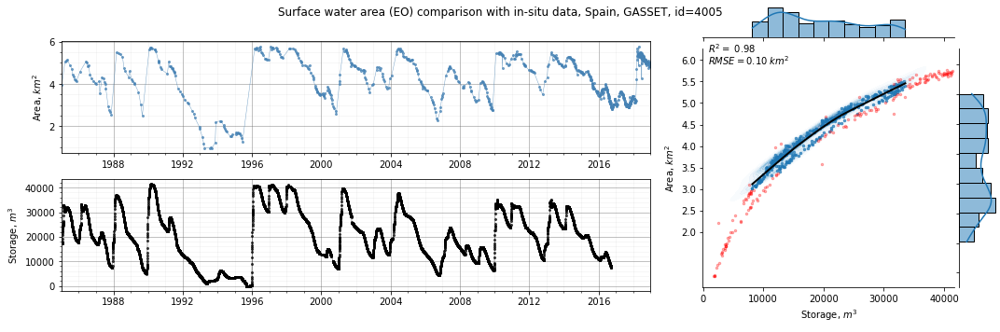

 59%|███████████████████████████████████████████████▌                                | 186/313 [09:05<05:57,  2.81s/it]

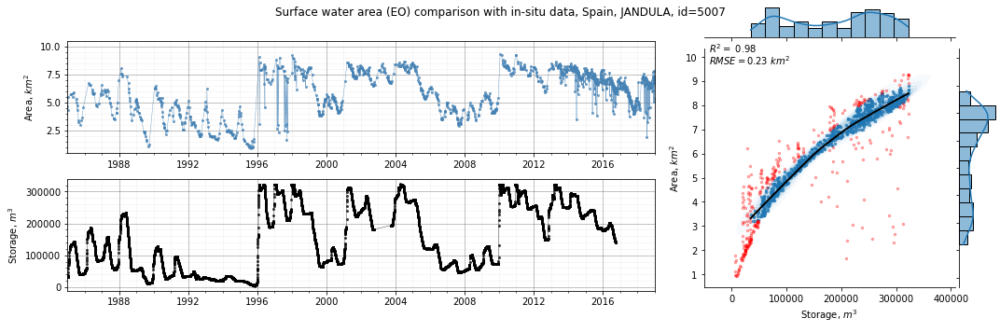

 60%|███████████████████████████████████████████████▊                                | 187/313 [09:08<06:01,  2.87s/it]

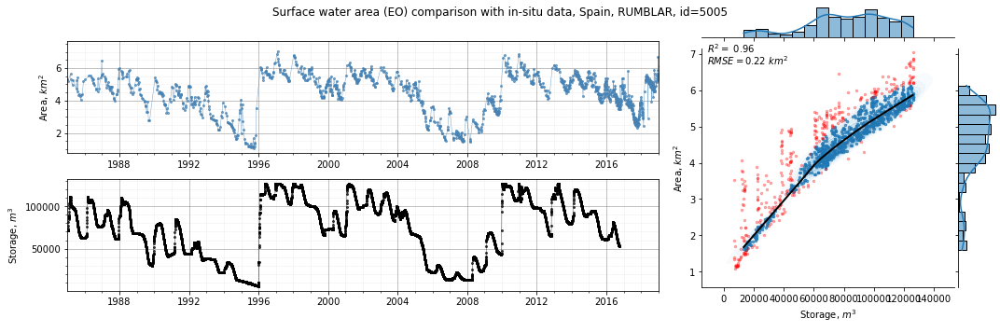

 60%|████████████████████████████████████████████████                                | 188/313 [09:11<06:11,  2.98s/it]

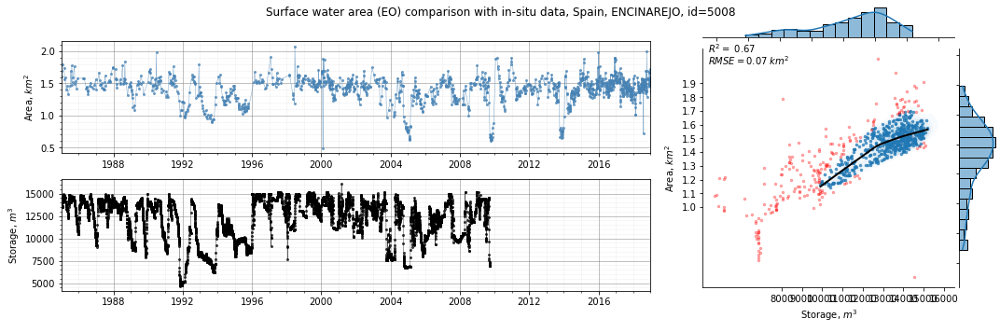

 60%|████████████████████████████████████████████████▎                               | 189/313 [09:14<05:50,  2.83s/it]

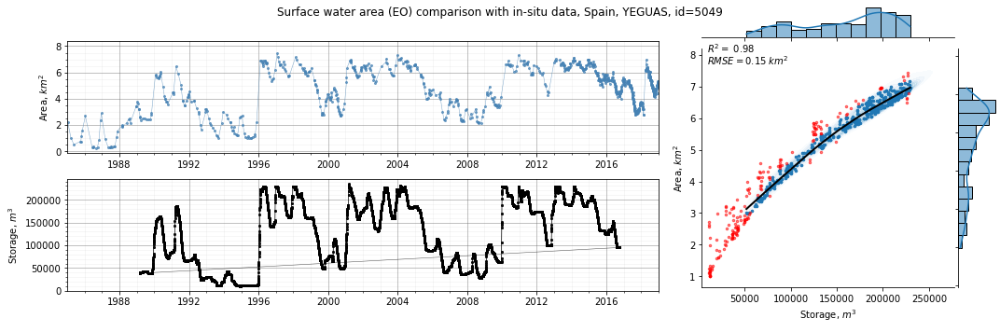

 61%|████████████████████████████████████████████████▌                               | 190/313 [09:17<06:14,  3.05s/it]

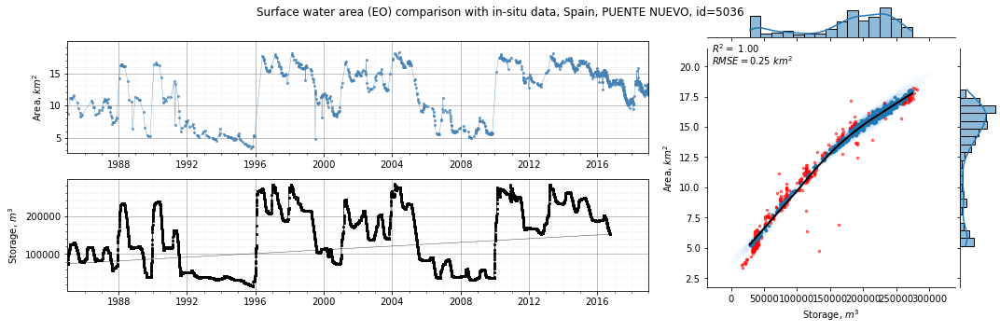

 61%|████████████████████████████████████████████████▊                               | 191/313 [09:22<07:00,  3.45s/it]

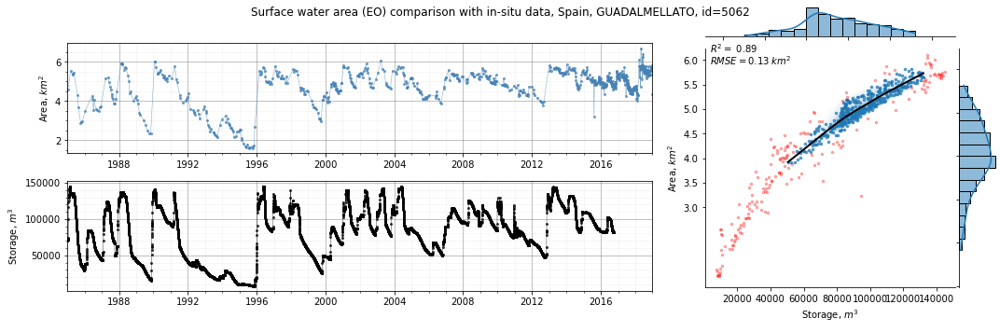

 61%|█████████████████████████████████████████████████                               | 192/313 [09:25<06:44,  3.34s/it]

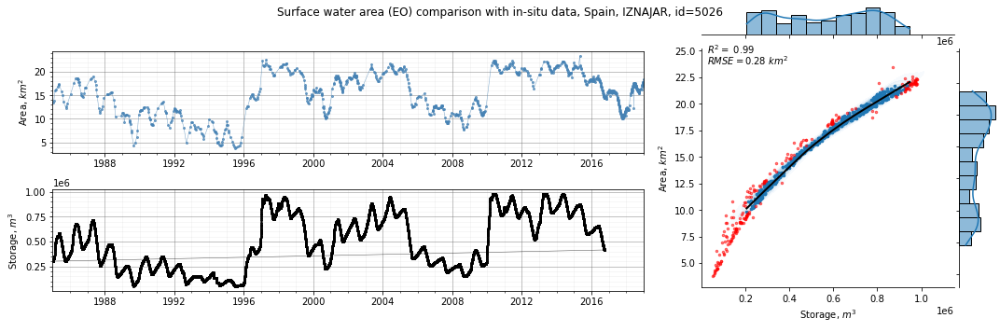

 62%|█████████████████████████████████████████████████▎                              | 193/313 [09:29<07:09,  3.58s/it]

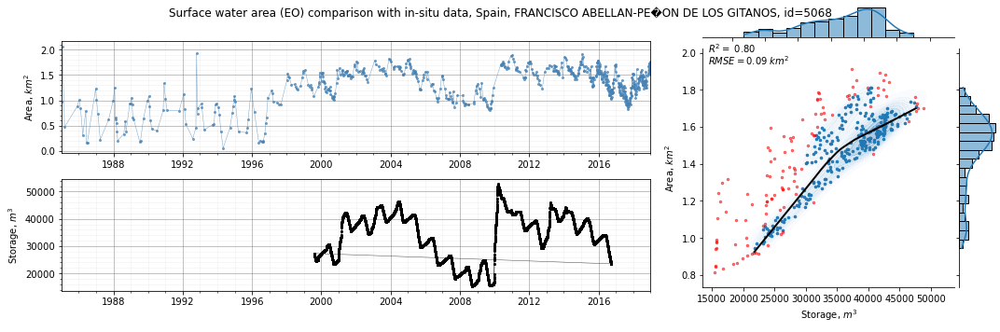

 62%|█████████████████████████████████████████████████▌                              | 194/313 [09:32<06:34,  3.31s/it]

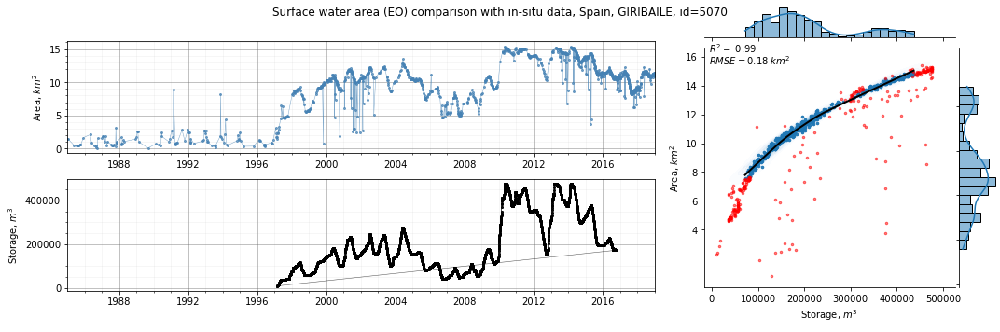

 62%|█████████████████████████████████████████████████▊                              | 195/313 [09:36<06:50,  3.48s/it]

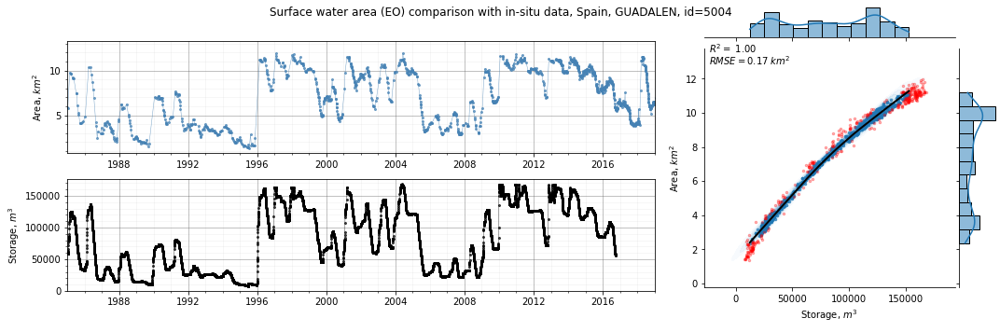

 63%|██████████████████████████████████████████████████                              | 196/313 [09:39<06:54,  3.54s/it]

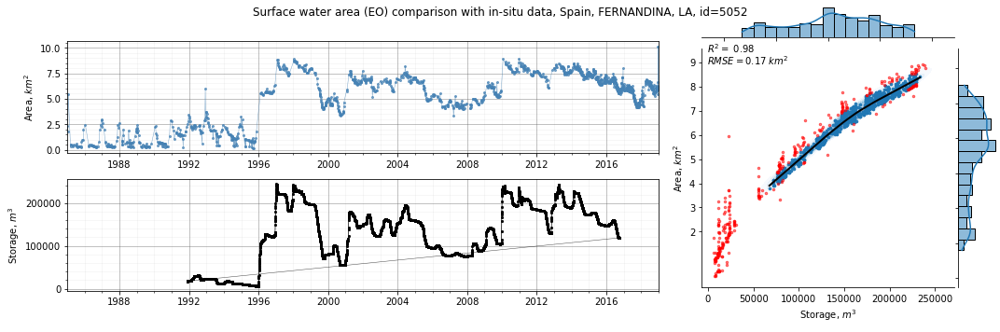

 63%|██████████████████████████████████████████████████▎                             | 197/313 [09:44<07:23,  3.82s/it]

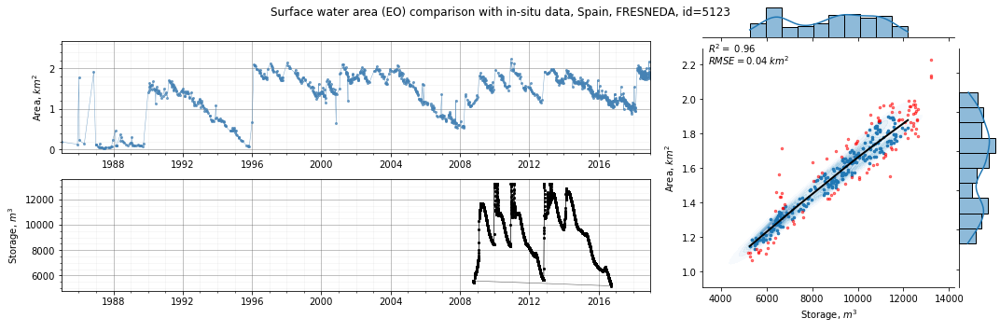

 63%|██████████████████████████████████████████████████▌                             | 198/313 [09:46<06:36,  3.45s/it]

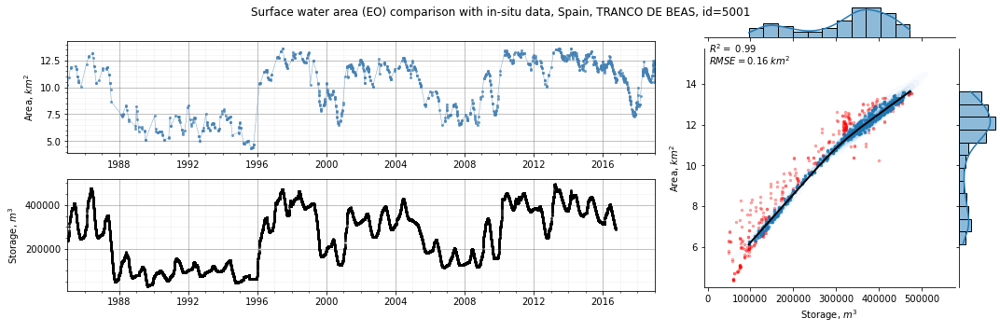

 64%|██████████████████████████████████████████████████▊                             | 199/313 [09:49<06:17,  3.31s/it]

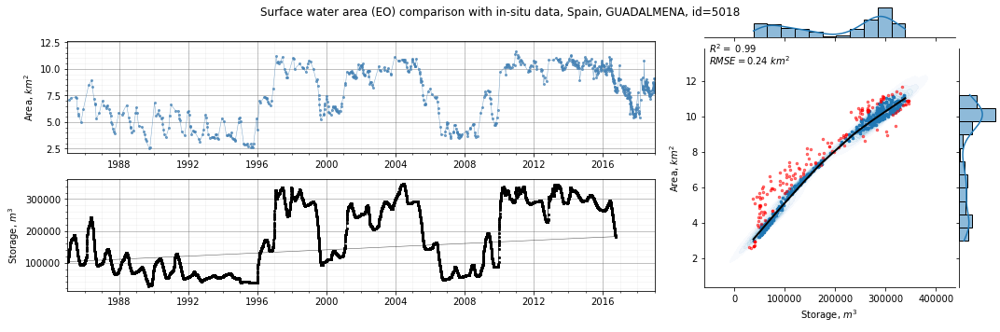

 64%|███████████████████████████████████████████████████                             | 200/313 [09:53<06:22,  3.39s/it]

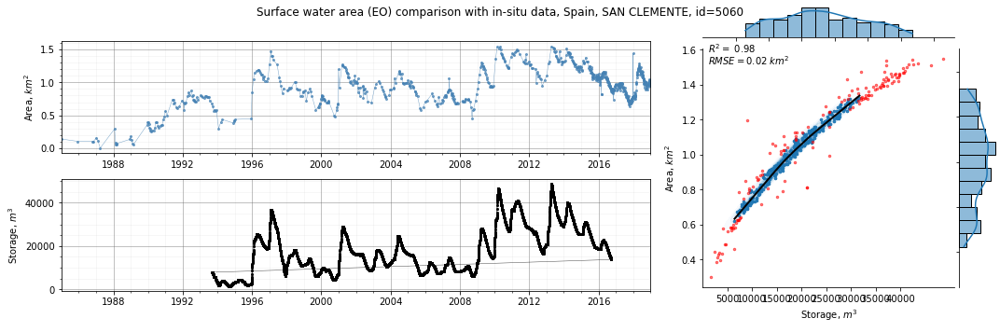

 64%|███████████████████████████████████████████████████▎                            | 201/313 [09:56<06:11,  3.32s/it]

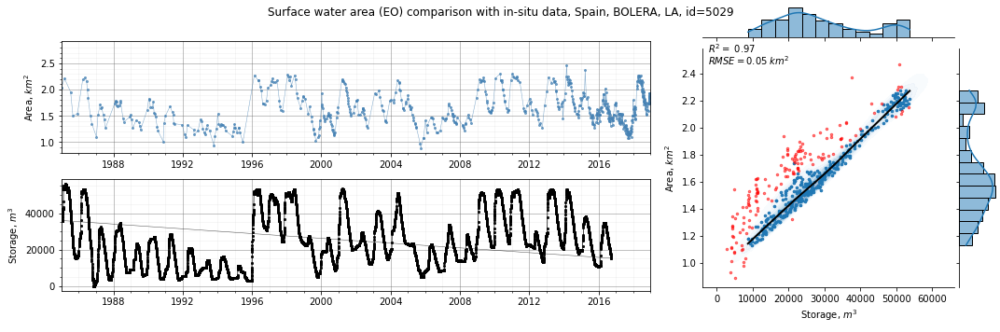

 65%|███████████████████████████████████████████████████▋                            | 202/313 [09:59<06:10,  3.33s/it]

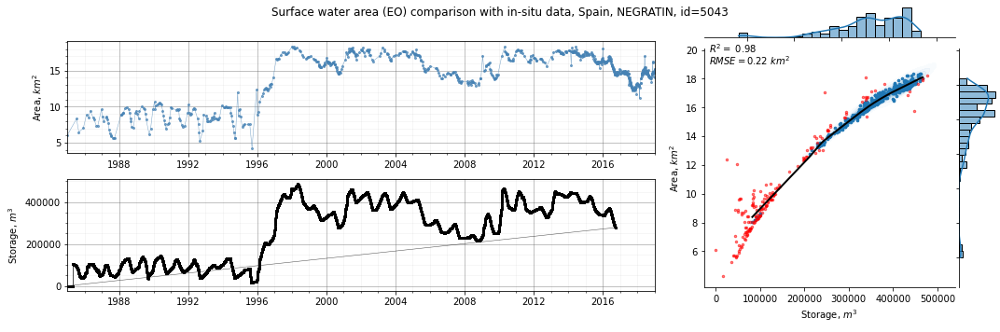

 65%|███████████████████████████████████████████████████▉                            | 203/313 [10:03<06:12,  3.39s/it]

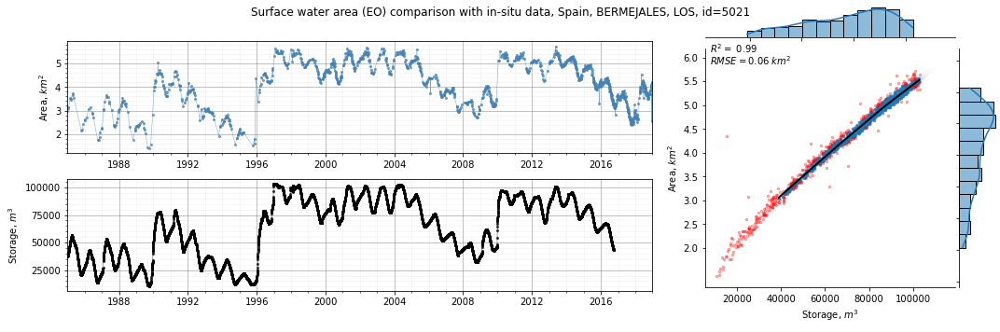

 65%|████████████████████████████████████████████████████▏                           | 204/313 [10:06<06:06,  3.36s/it]

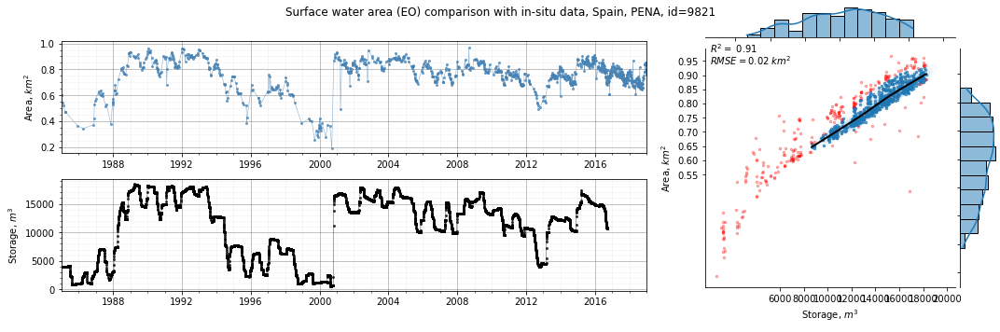

 65%|████████████████████████████████████████████████████▍                           | 205/313 [10:09<05:34,  3.10s/it]

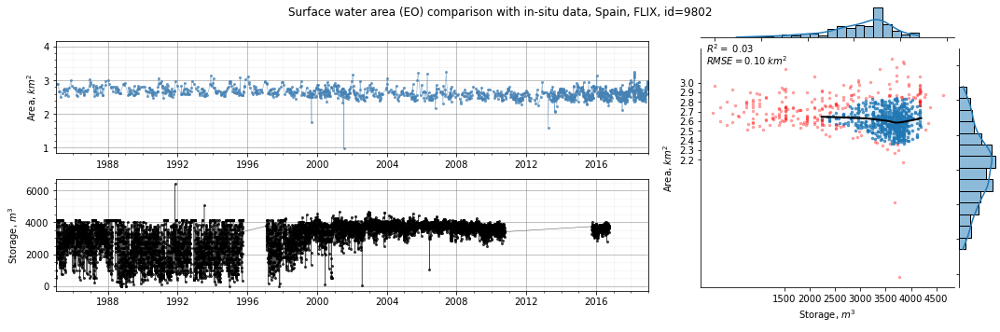

 66%|████████████████████████████████████████████████████▋                           | 206/313 [10:11<05:07,  2.87s/it]

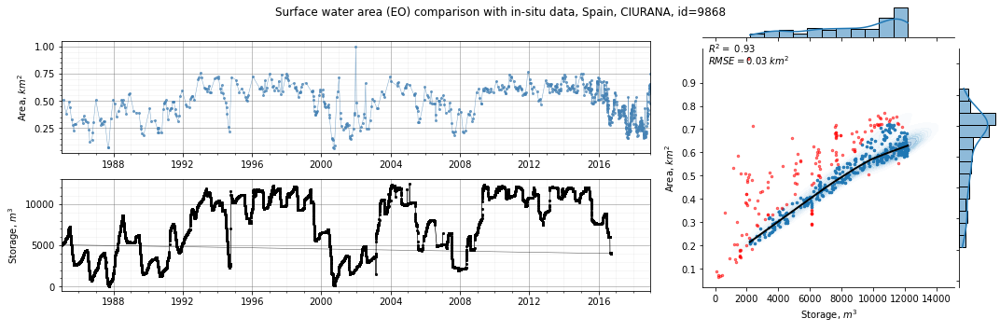

 66%|████████████████████████████████████████████████████▉                           | 207/313 [10:14<04:59,  2.82s/it]

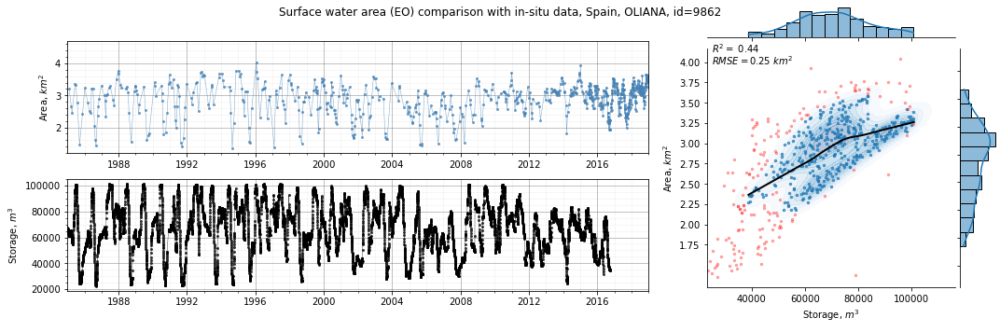

 66%|█████████████████████████████████████████████████████▏                          | 208/313 [10:16<04:38,  2.65s/it]

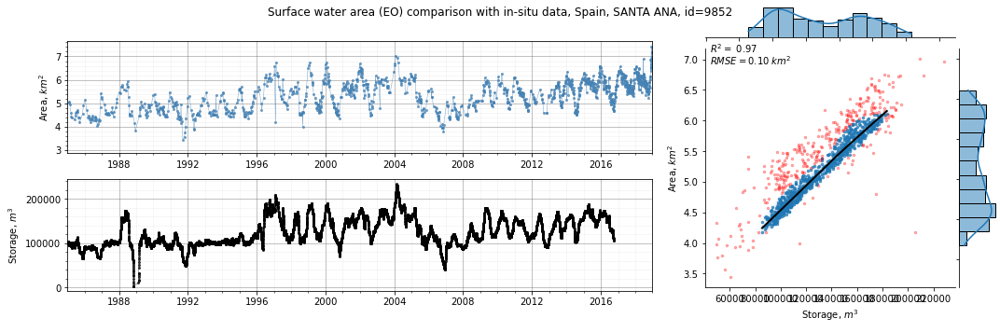

 67%|█████████████████████████████████████████████████████▍                          | 209/313 [10:19<04:45,  2.75s/it]

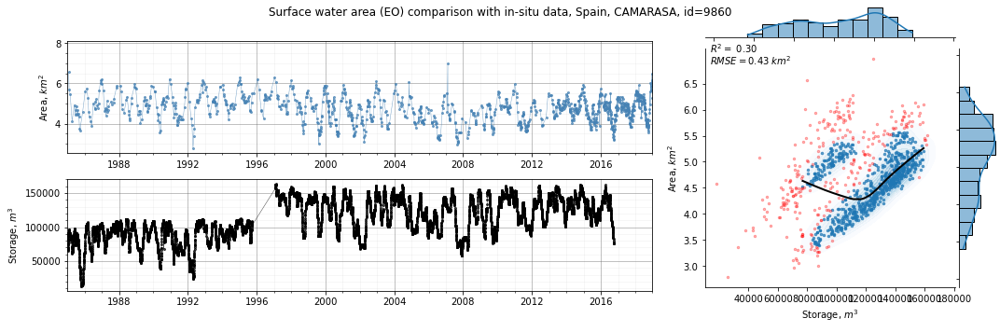

 67%|█████████████████████████████████████████████████████▋                          | 210/313 [10:22<04:42,  2.74s/it]

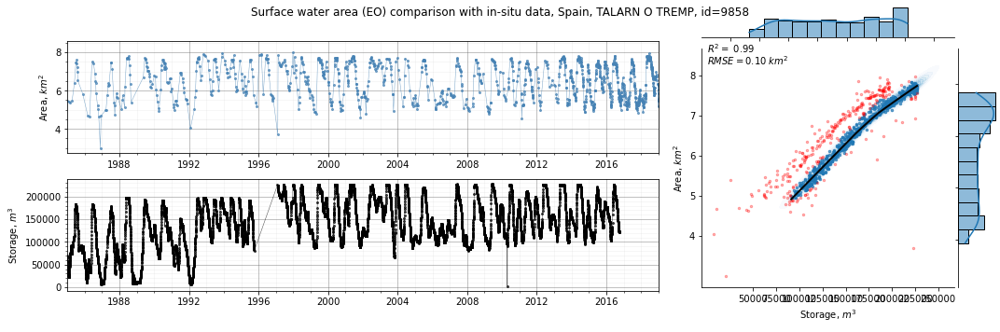

 67%|█████████████████████████████████████████████████████▉                          | 211/313 [10:24<04:41,  2.76s/it]

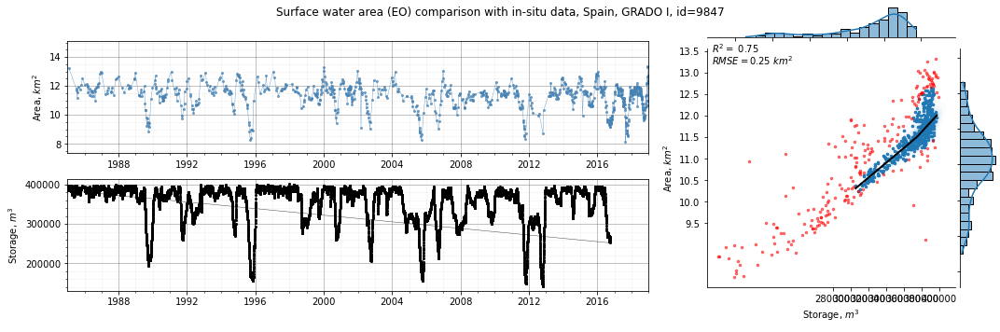

 68%|██████████████████████████████████████████████████████▏                         | 212/313 [10:28<04:48,  2.86s/it]

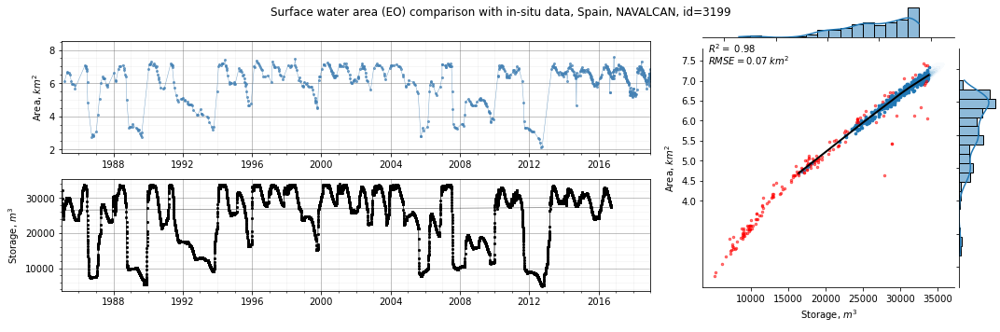

 68%|██████████████████████████████████████████████████████▍                         | 213/313 [10:31<05:10,  3.10s/it]

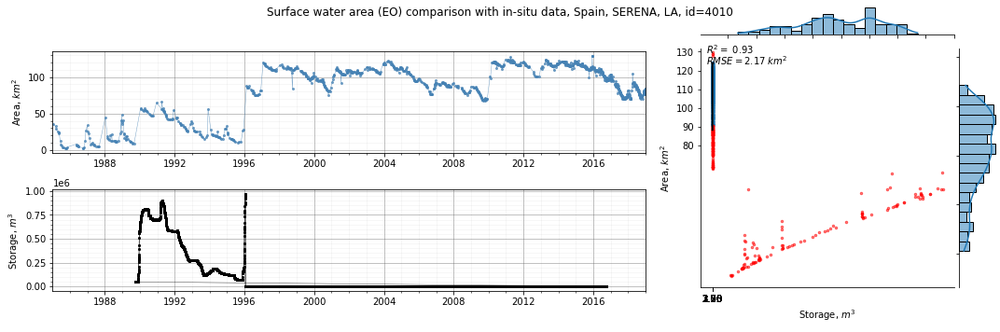

 68%|██████████████████████████████████████████████████████▋                         | 214/313 [10:35<05:33,  3.37s/it]

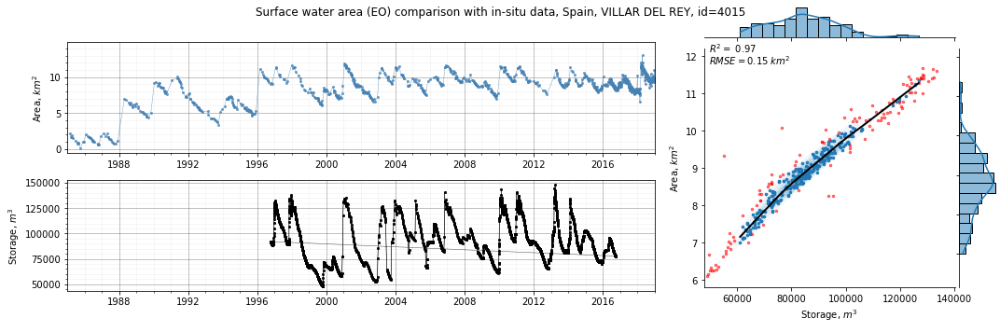

 69%|██████████████████████████████████████████████████████▉                         | 215/313 [10:38<05:16,  3.23s/it]

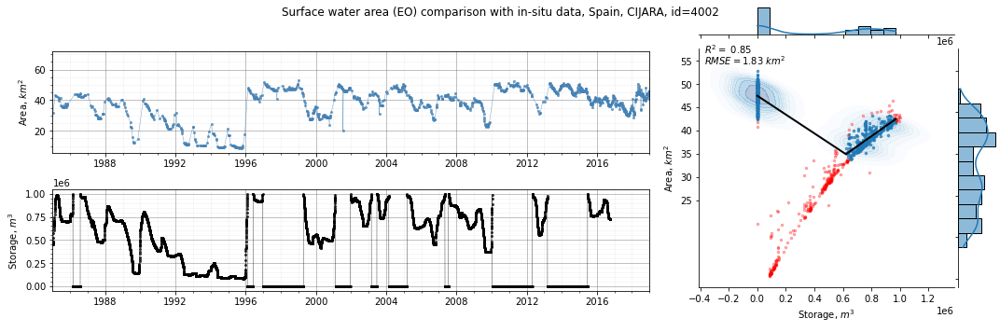

 69%|███████████████████████████████████████████████████████▏                        | 216/313 [10:41<04:53,  3.03s/it]

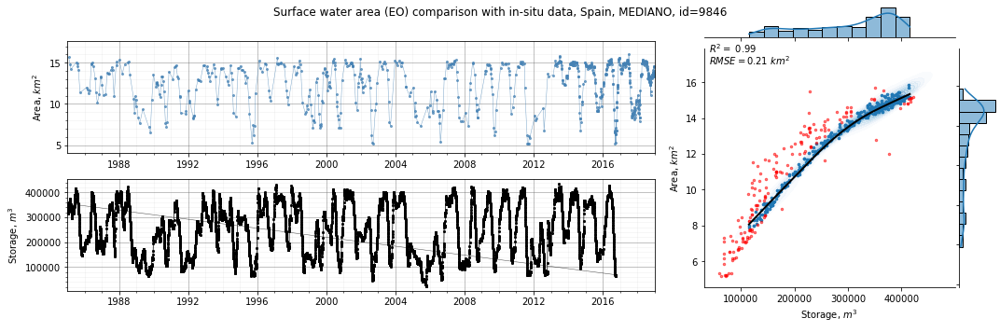

 69%|███████████████████████████████████████████████████████▍                        | 217/313 [10:44<04:52,  3.05s/it]

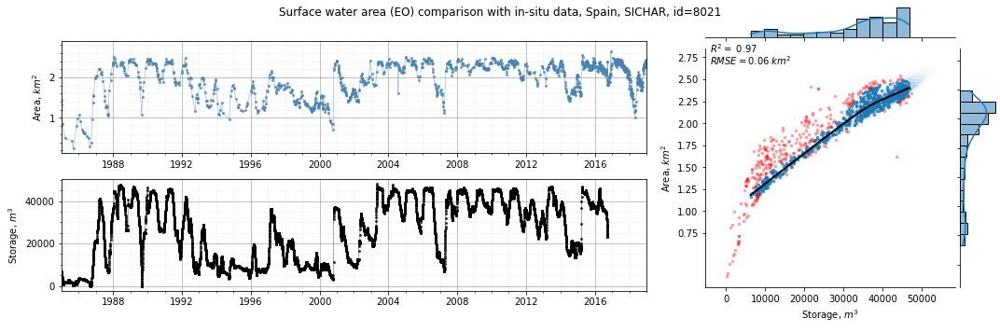

 70%|███████████████████████████████████████████████████████▋                        | 218/313 [10:47<04:43,  2.99s/it]

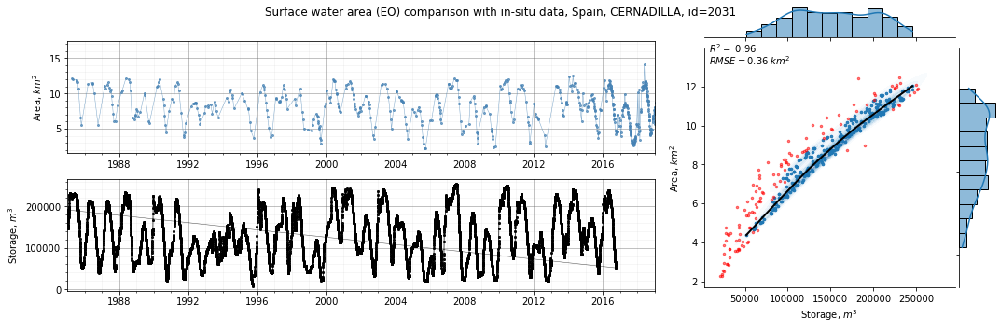

 70%|████████████████████████████████████████████████████████▏                       | 220/313 [10:50<03:33,  2.30s/it]

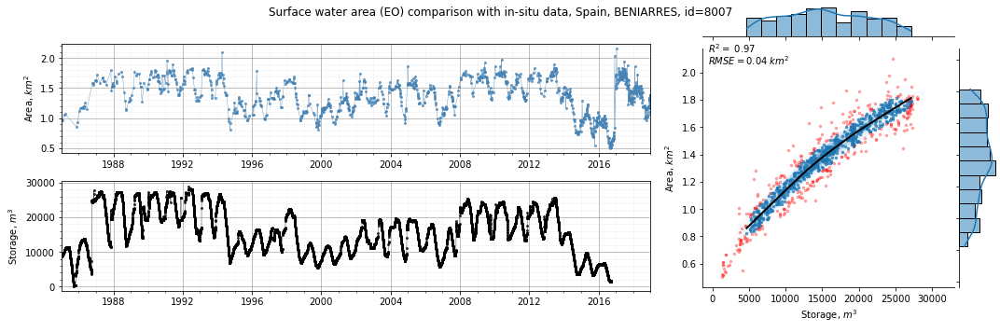

 71%|████████████████████████████████████████████████████████▍                       | 221/313 [10:53<03:49,  2.49s/it]

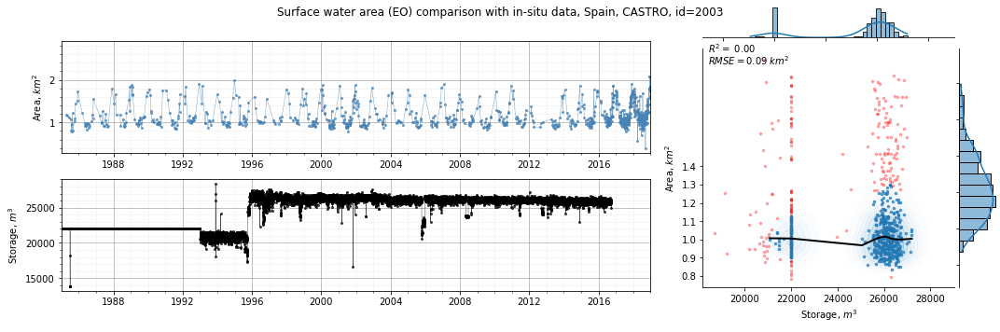

 71%|████████████████████████████████████████████████████████▉                       | 223/313 [10:55<02:58,  1.99s/it]

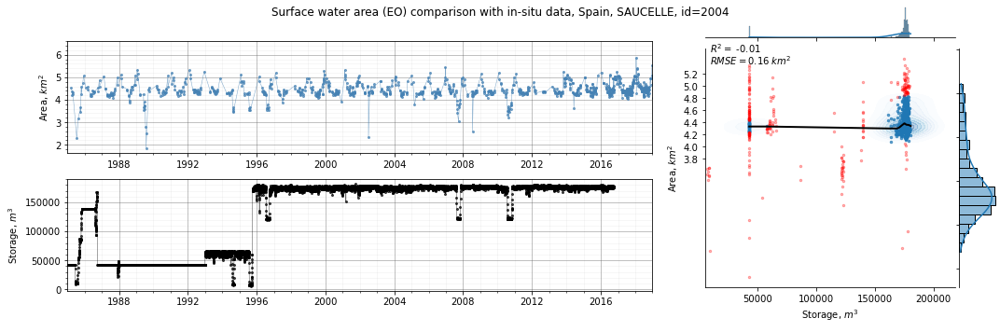

 72%|█████████████████████████████████████████████████████████▎                      | 224/313 [10:58<03:16,  2.21s/it]

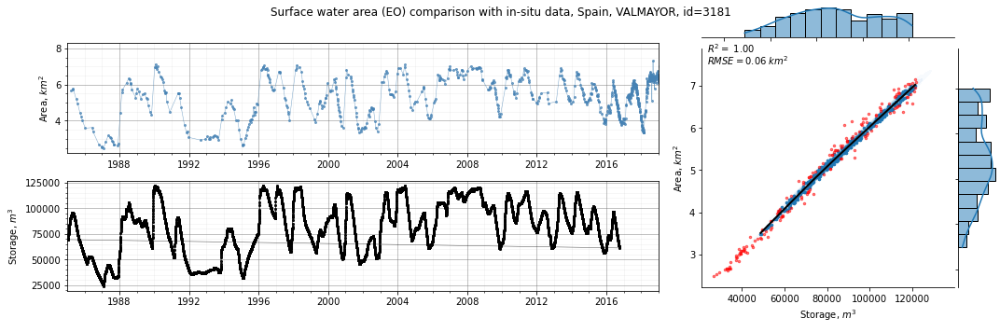

 72%|█████████████████████████████████████████████████████████▌                      | 225/313 [11:02<03:44,  2.55s/it]

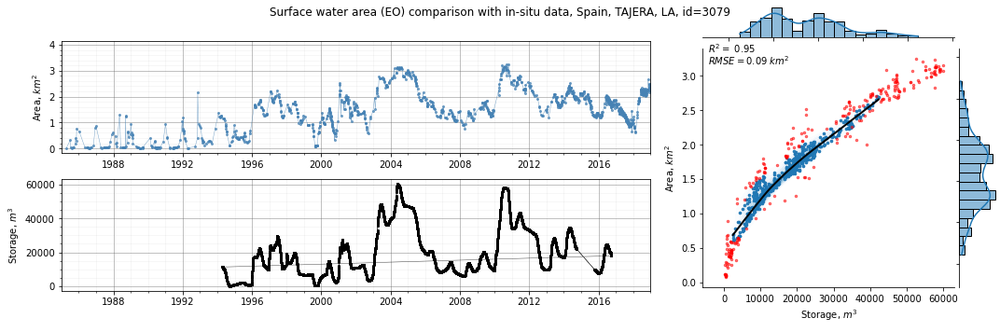

 72%|█████████████████████████████████████████████████████████▊                      | 226/313 [11:06<04:09,  2.87s/it]

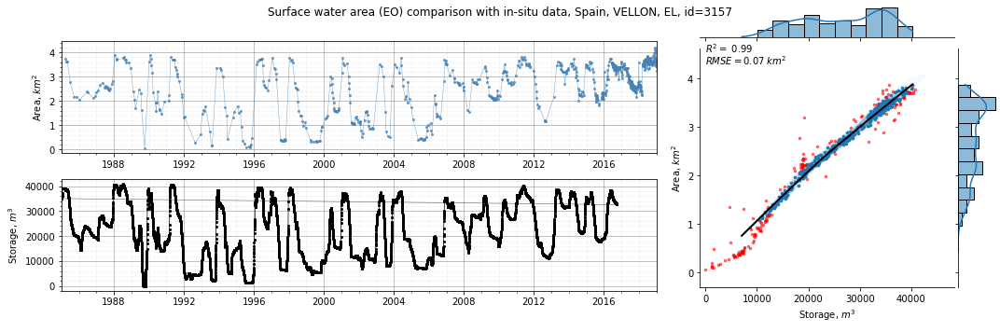

 73%|██████████████████████████████████████████████████████████                      | 227/313 [11:09<04:22,  3.05s/it]

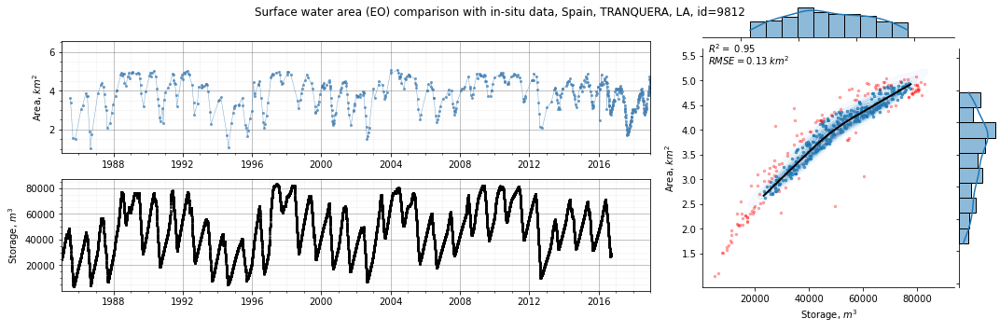

 73%|██████████████████████████████████████████████████████████▎                     | 228/313 [11:12<04:05,  2.89s/it]

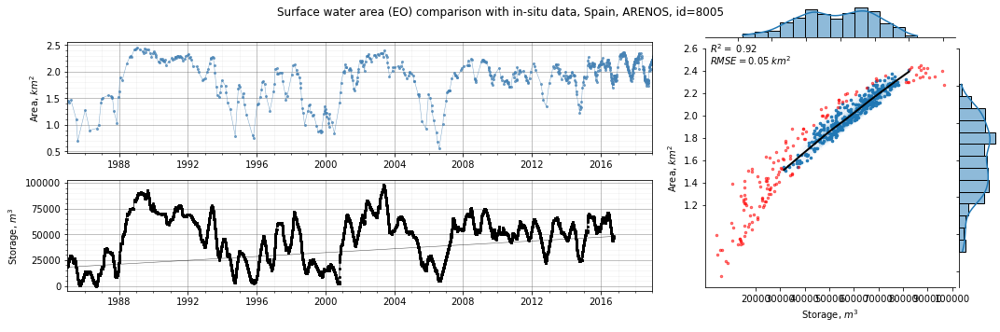

 73%|██████████████████████████████████████████████████████████▌                     | 229/313 [11:15<04:11,  2.99s/it]

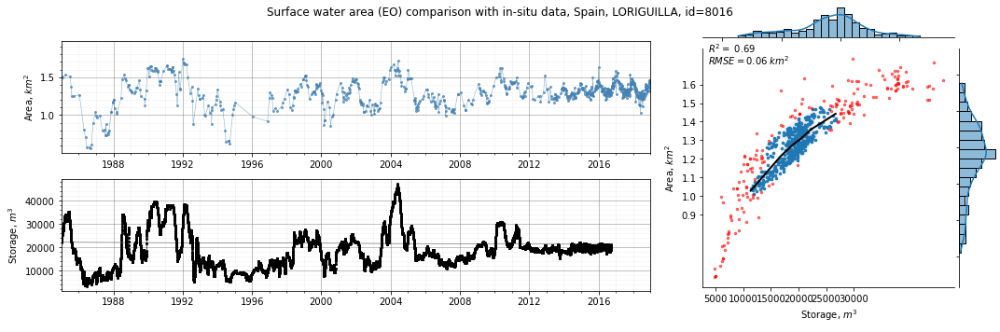

 73%|██████████████████████████████████████████████████████████▊                     | 230/313 [11:18<04:10,  3.01s/it]

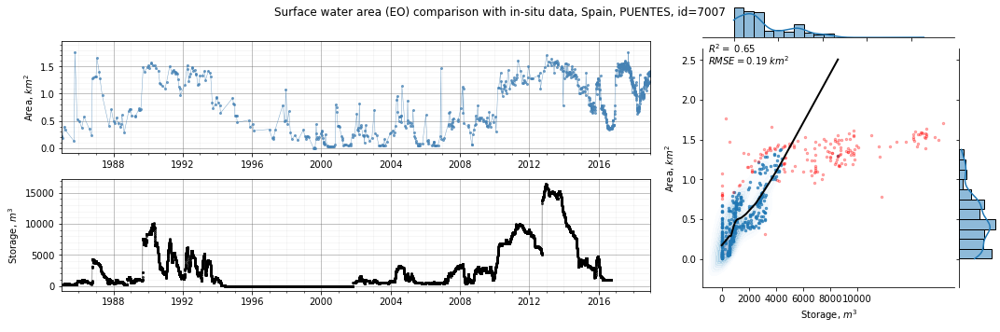

 74%|███████████████████████████████████████████████████████████                     | 231/313 [11:20<03:51,  2.82s/it]

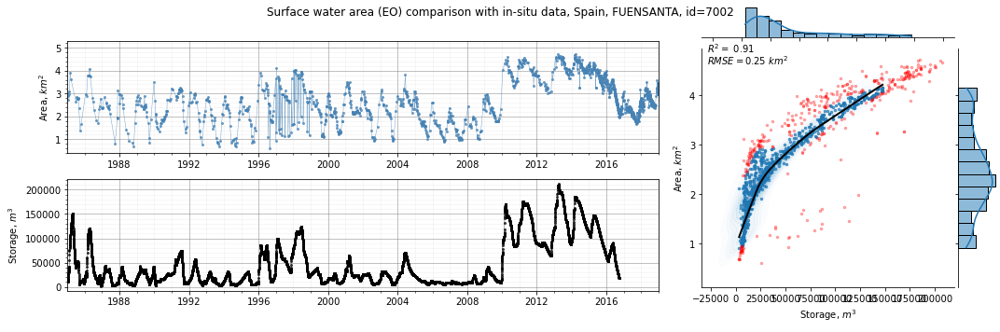

 74%|███████████████████████████████████████████████████████████▎                    | 232/313 [11:23<03:55,  2.91s/it]

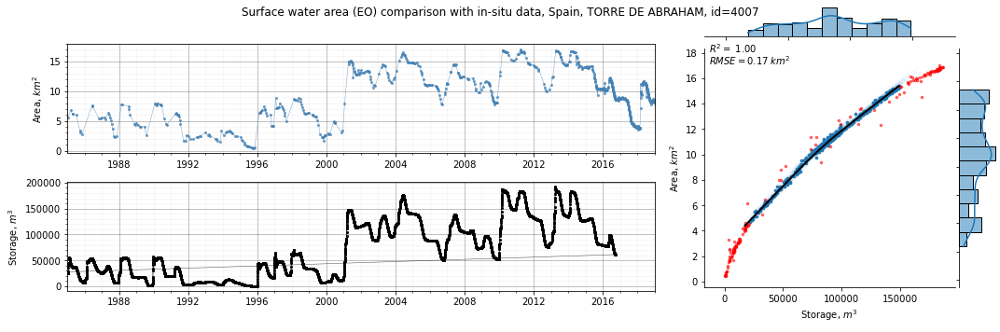

 74%|███████████████████████████████████████████████████████████▌                    | 233/313 [11:27<04:14,  3.18s/it]

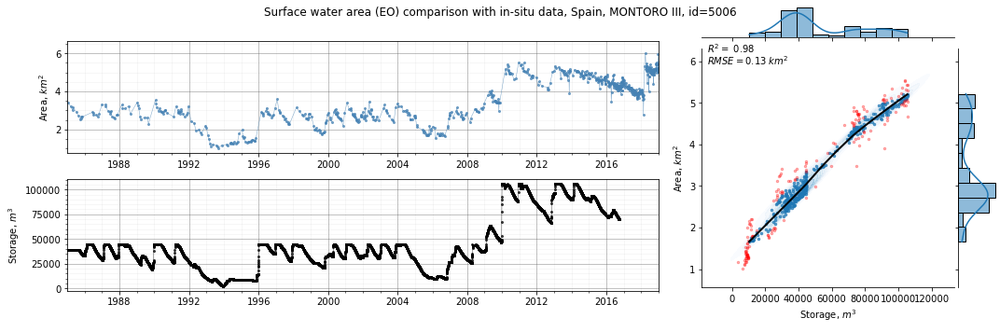

 75%|███████████████████████████████████████████████████████████▊                    | 234/313 [11:30<03:59,  3.03s/it]

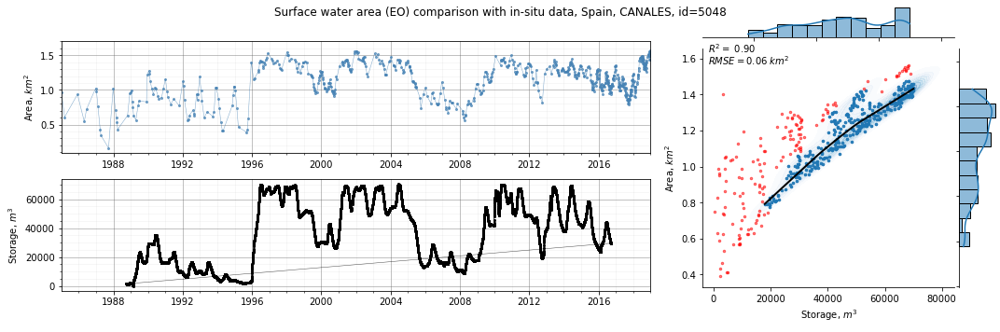

 75%|████████████████████████████████████████████████████████████                    | 235/313 [11:33<03:52,  2.98s/it]

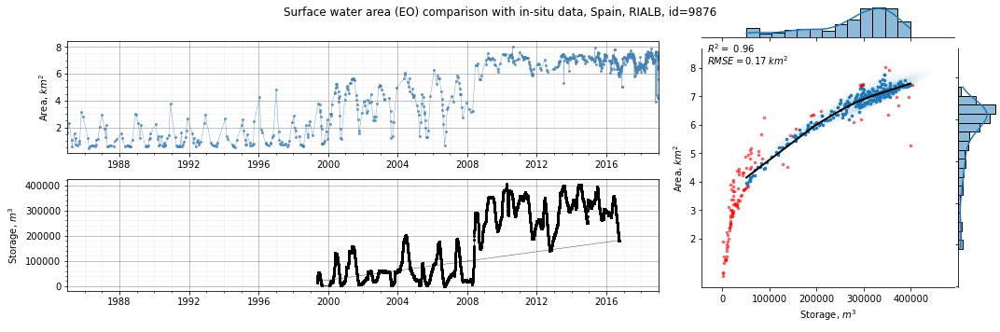

 75%|████████████████████████████████████████████████████████████▎                   | 236/313 [11:36<03:44,  2.92s/it]

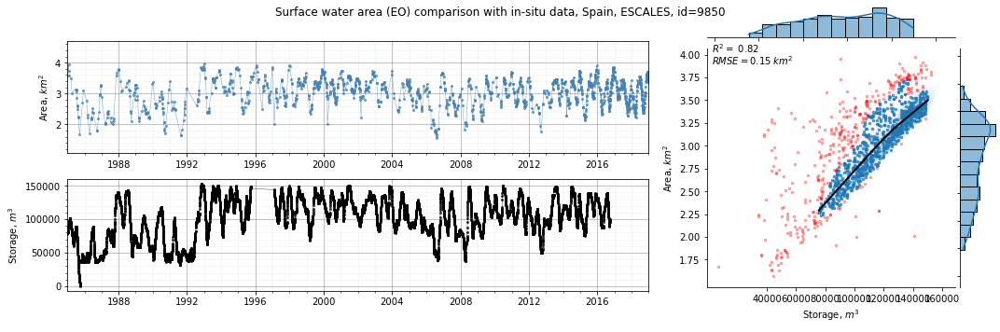

 76%|████████████████████████████████████████████████████████████▌                   | 237/313 [11:38<03:41,  2.92s/it]

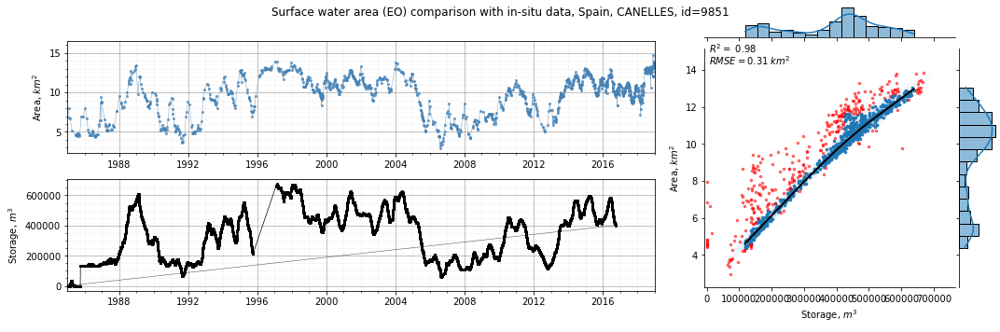

 76%|████████████████████████████████████████████████████████████▊                   | 238/313 [11:43<04:15,  3.40s/it]

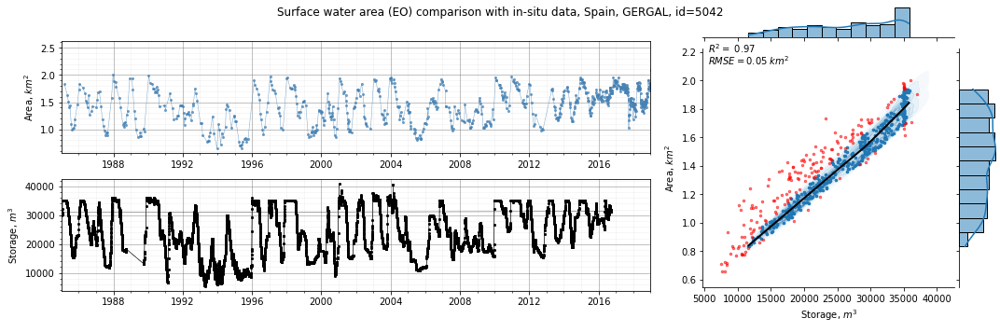

 76%|█████████████████████████████████████████████████████████████                   | 239/313 [11:46<04:11,  3.40s/it]

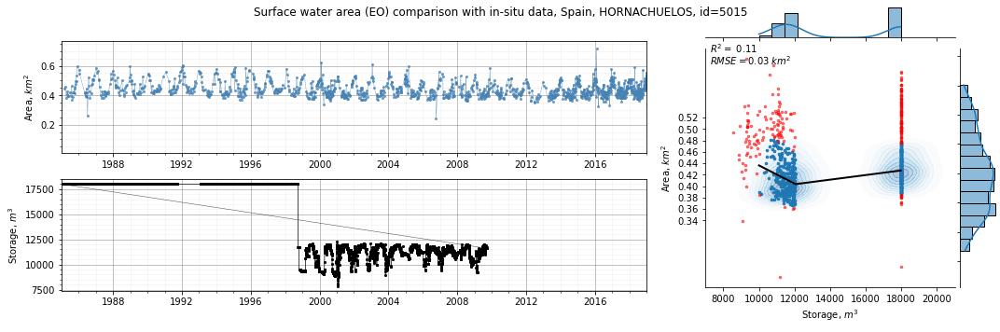

 77%|█████████████████████████████████████████████████████████████▎                  | 240/313 [11:49<04:00,  3.30s/it]

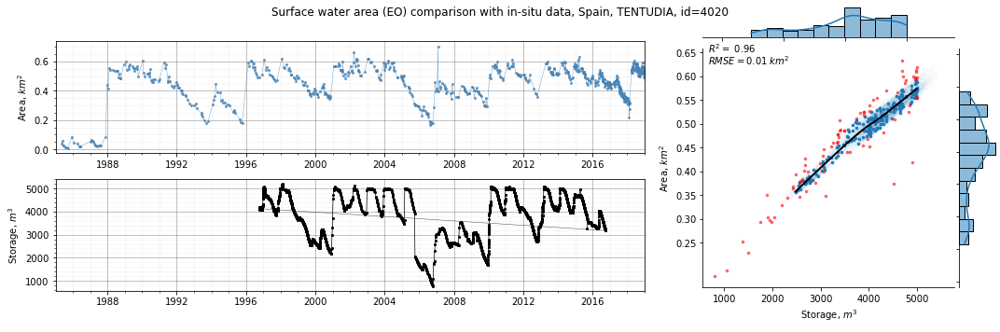

 77%|█████████████████████████████████████████████████████████████▌                  | 241/313 [11:52<03:37,  3.02s/it]

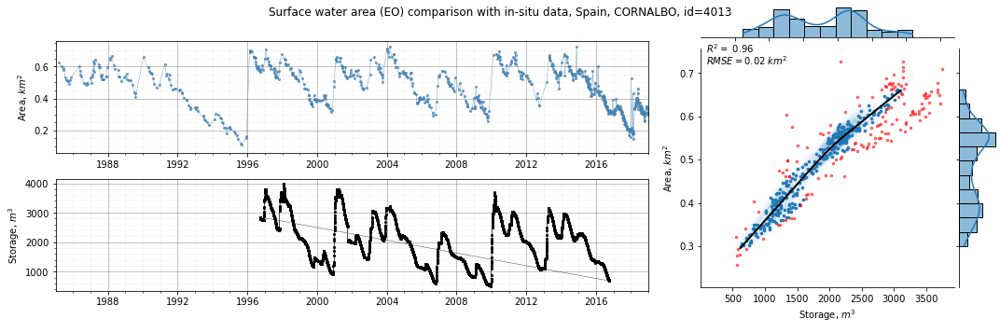

 77%|█████████████████████████████████████████████████████████████▊                  | 242/313 [11:55<03:33,  3.01s/it]

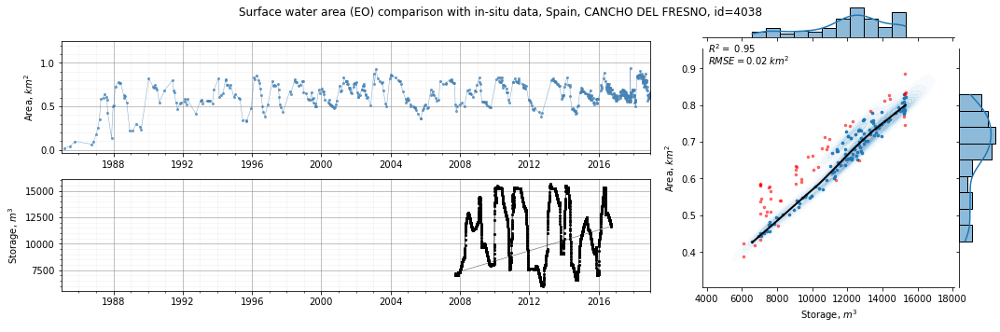

 78%|██████████████████████████████████████████████████████████████                  | 243/313 [11:57<03:12,  2.75s/it]

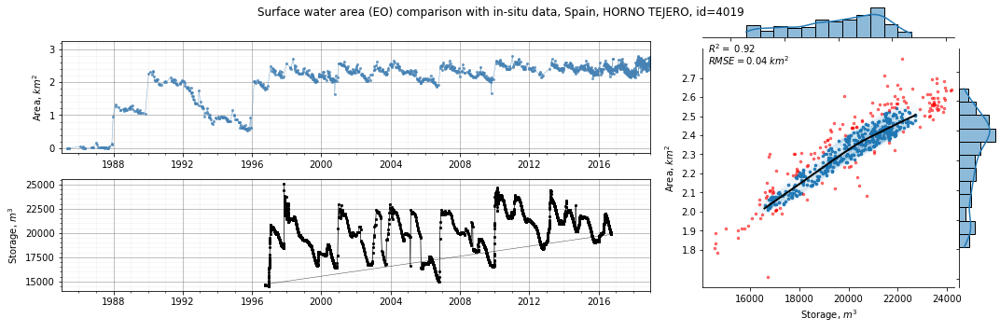

 78%|██████████████████████████████████████████████████████████████▎                 | 244/313 [12:00<03:12,  2.79s/it]

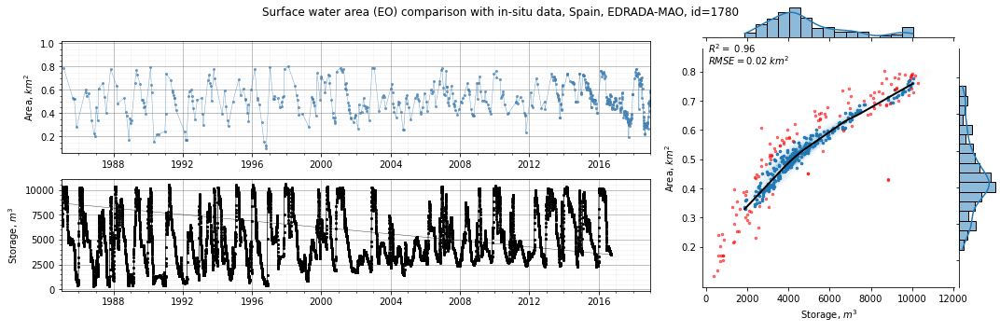

 78%|██████████████████████████████████████████████████████████████▌                 | 245/313 [12:03<03:13,  2.85s/it]

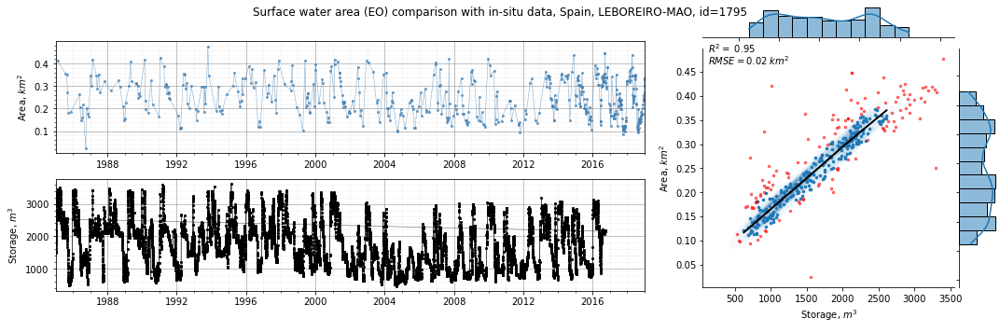

 79%|██████████████████████████████████████████████████████████████▉                 | 246/313 [12:06<03:14,  2.91s/it]

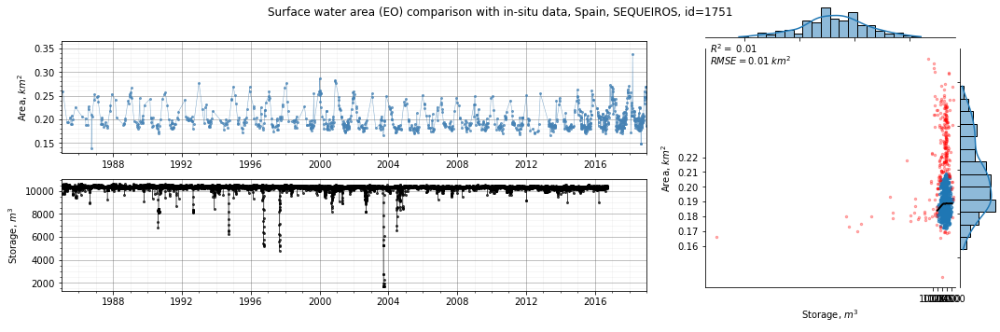

 79%|███████████████████████████████████████████████████████████████▏                | 247/313 [12:08<03:02,  2.76s/it]

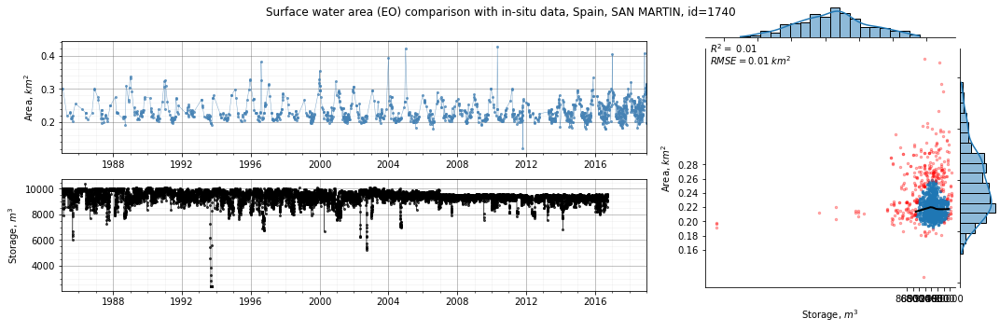

 79%|███████████████████████████████████████████████████████████████▍                | 248/313 [12:11<03:00,  2.77s/it]

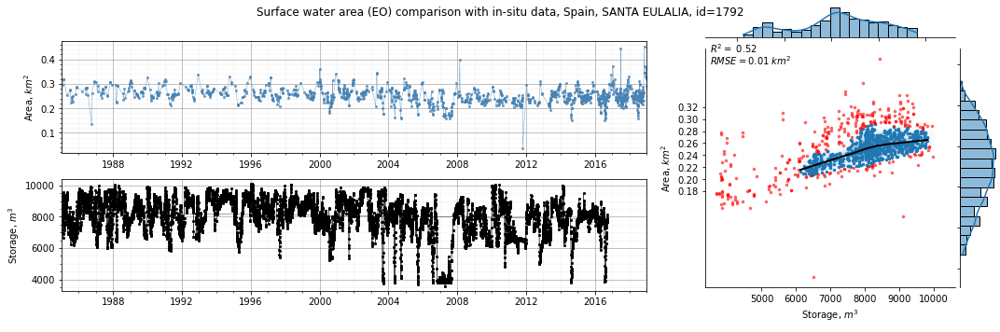

 80%|███████████████████████████████████████████████████████████████▋                | 249/313 [12:15<03:10,  2.98s/it]

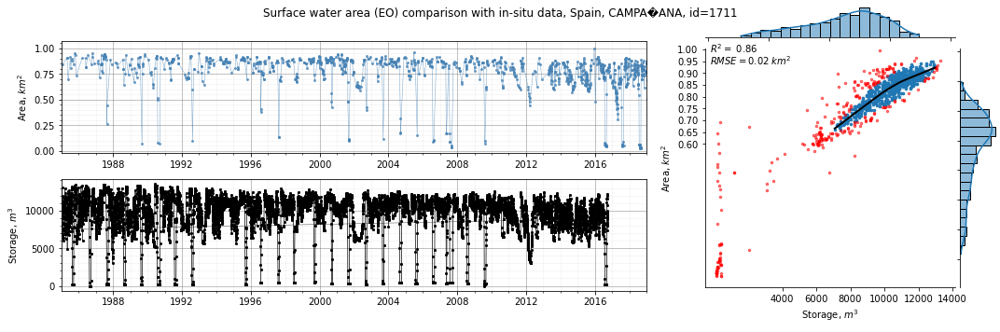

 80%|███████████████████████████████████████████████████████████████▉                | 250/313 [12:18<03:19,  3.16s/it]

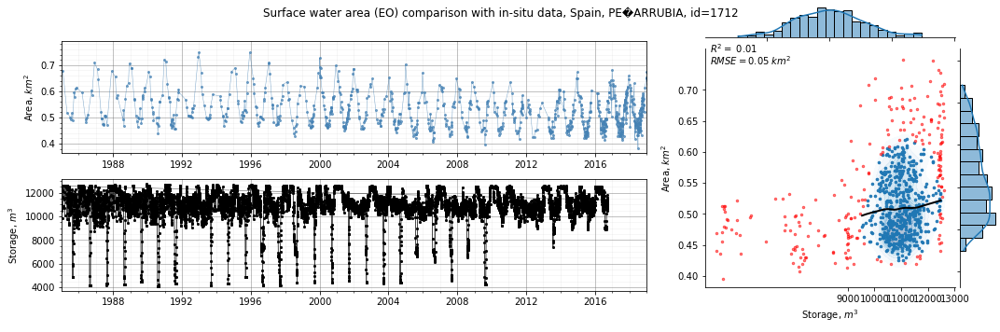

 80%|████████████████████████████████████████████████████████████████▏               | 251/313 [12:21<03:13,  3.12s/it]

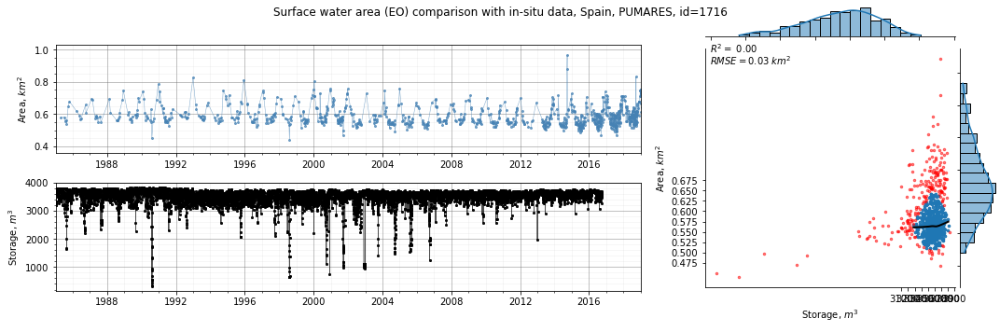

 81%|████████████████████████████████████████████████████████████████▍               | 252/313 [12:24<03:10,  3.12s/it]

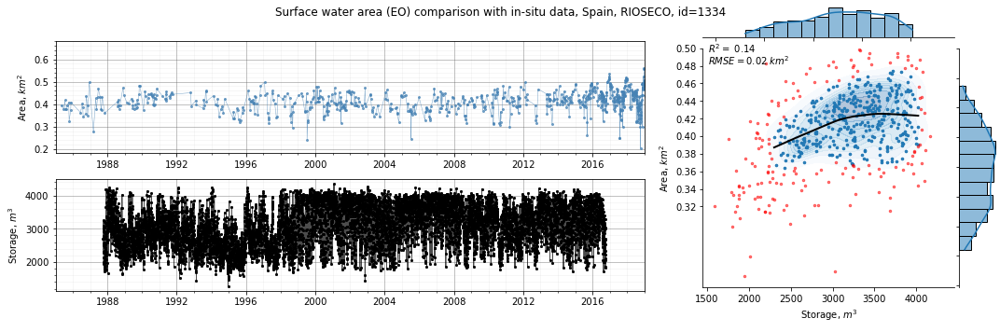

 81%|████████████████████████████████████████████████████████████████▋               | 253/313 [12:27<03:02,  3.04s/it]

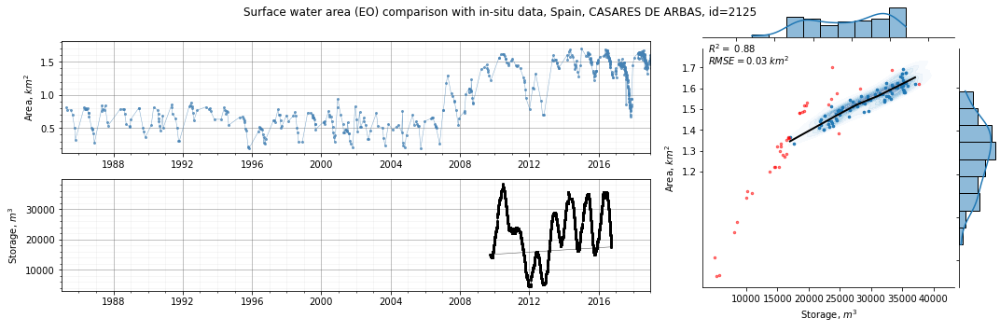

 81%|████████████████████████████████████████████████████████████████▉               | 254/313 [12:29<02:41,  2.73s/it]

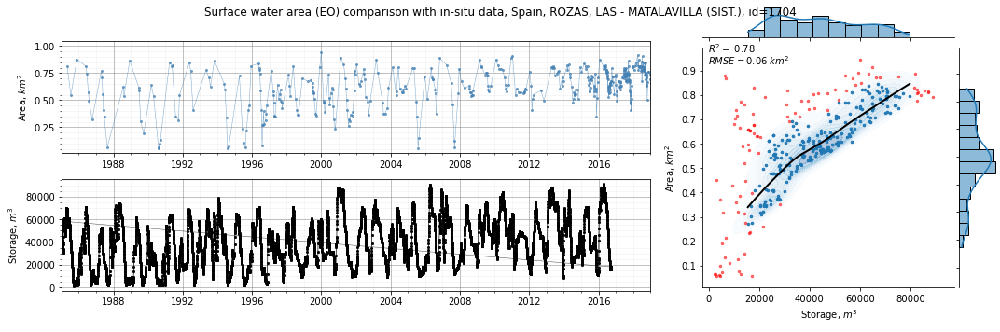

 81%|█████████████████████████████████████████████████████████████████▏              | 255/313 [12:32<02:36,  2.69s/it]

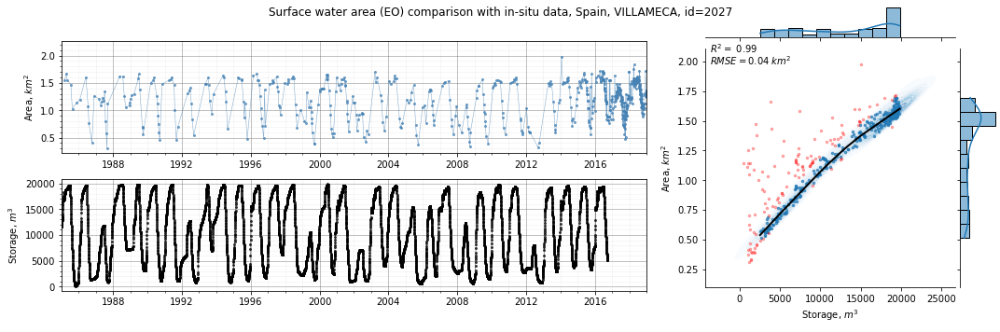

 82%|█████████████████████████████████████████████████████████████████▍              | 256/313 [12:34<02:30,  2.64s/it]

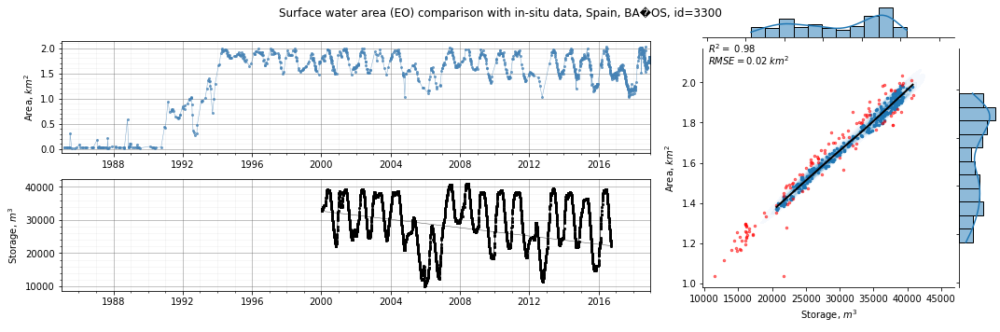

 82%|█████████████████████████████████████████████████████████████████▋              | 257/313 [12:37<02:30,  2.68s/it]

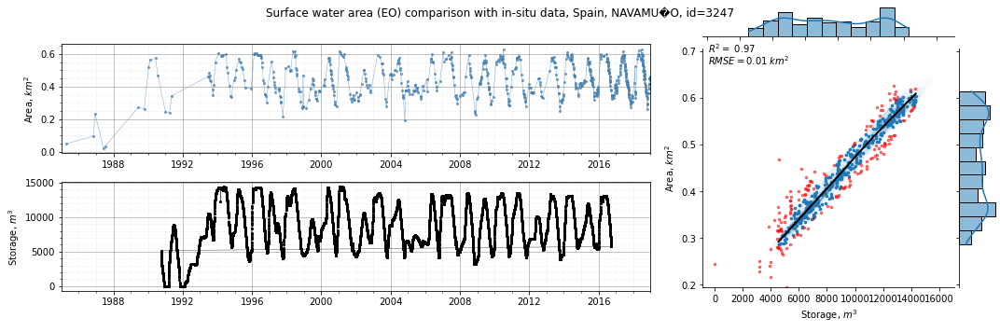

 82%|█████████████████████████████████████████████████████████████████▉              | 258/313 [12:40<02:35,  2.84s/it]

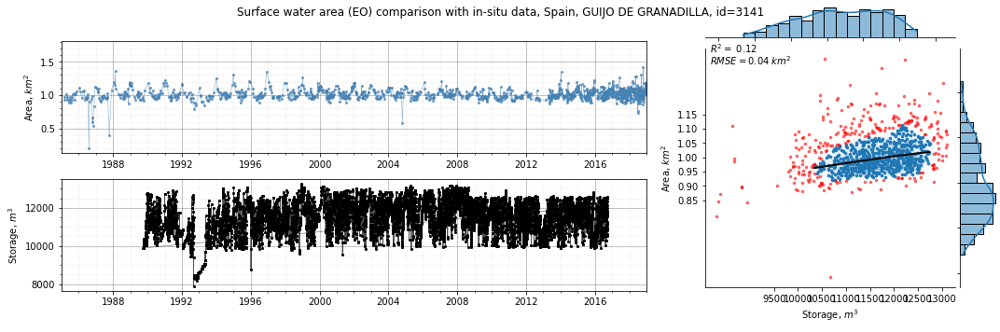

 83%|██████████████████████████████████████████████████████████████████▏             | 259/313 [12:43<02:35,  2.89s/it]

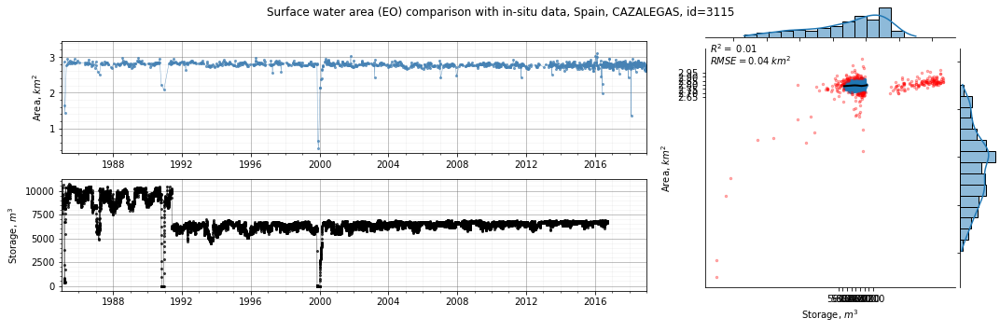

 83%|██████████████████████████████████████████████████████████████████▍             | 260/313 [12:46<02:24,  2.73s/it]

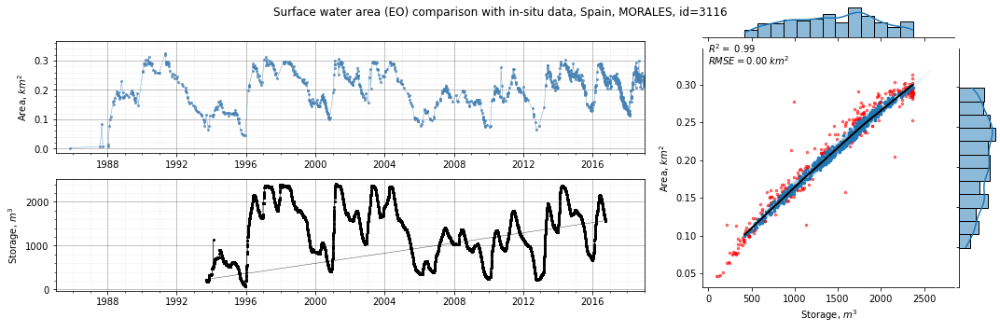

 83%|██████████████████████████████████████████████████████████████████▋             | 261/313 [12:49<02:33,  2.96s/it]

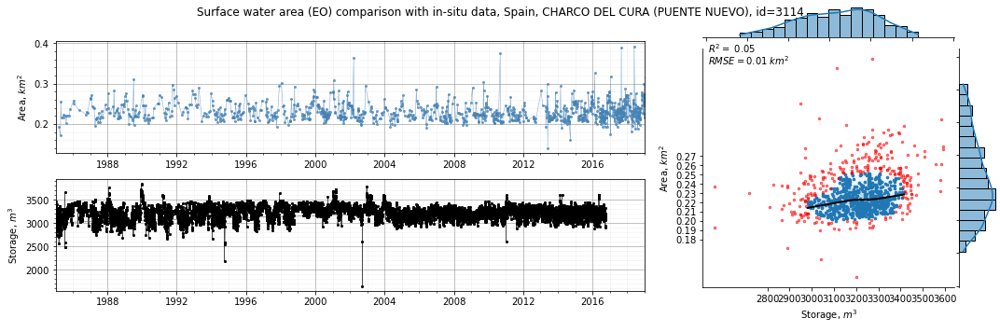

 84%|██████████████████████████████████████████████████████████████████▉             | 262/313 [12:52<02:31,  2.98s/it]

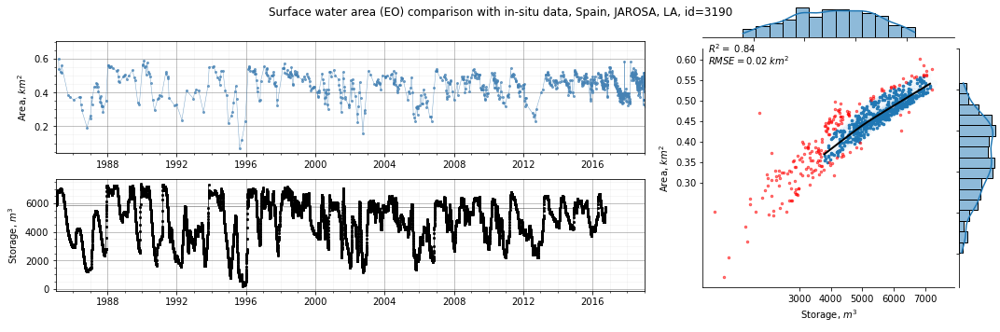

 84%|███████████████████████████████████████████████████████████████████▏            | 263/313 [12:55<02:26,  2.92s/it]

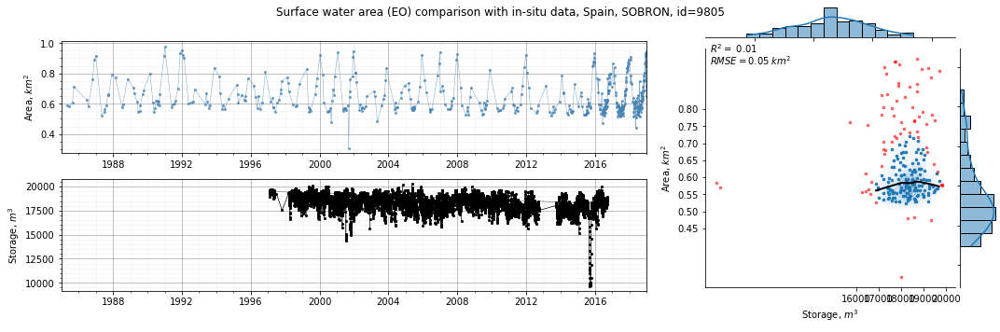

 84%|███████████████████████████████████████████████████████████████████▍            | 264/313 [12:57<02:11,  2.69s/it]

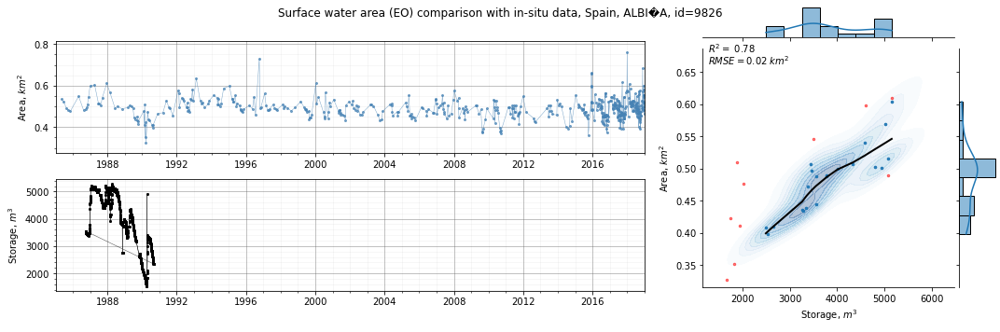

 85%|███████████████████████████████████████████████████████████████████▋            | 265/313 [12:59<01:53,  2.36s/it]

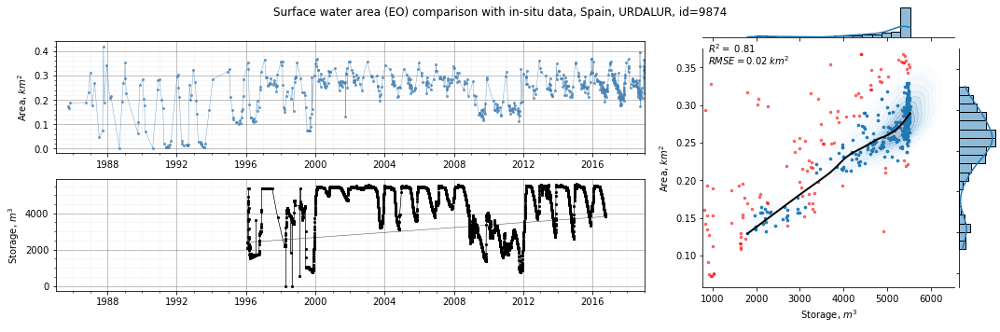

 85%|███████████████████████████████████████████████████████████████████▉            | 266/313 [13:01<01:53,  2.41s/it]

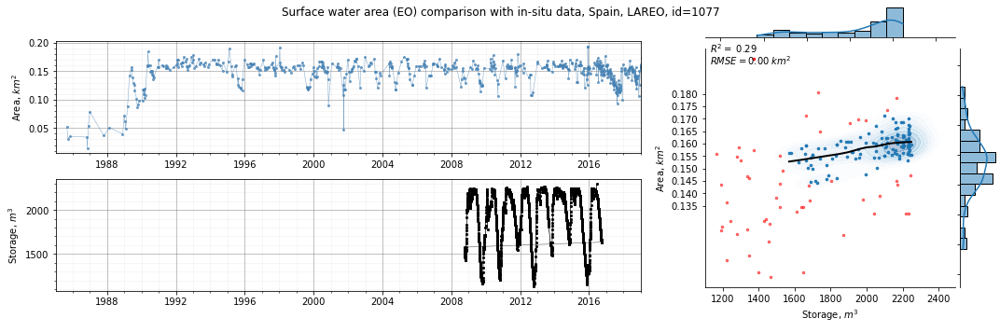

 85%|████████████████████████████████████████████████████████████████████▏           | 267/313 [13:03<01:43,  2.25s/it]

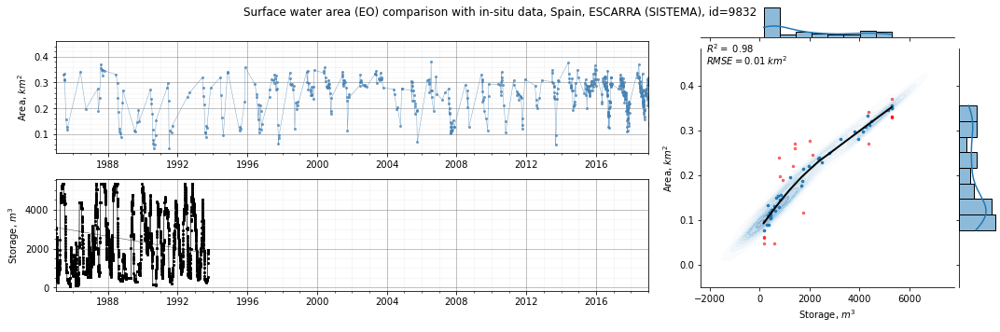

 86%|████████████████████████████████████████████████████████████████████▍           | 268/313 [13:05<01:35,  2.12s/it]

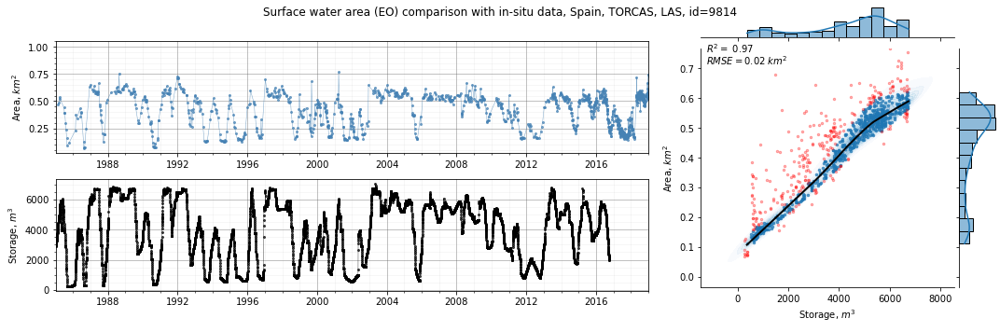

 86%|████████████████████████████████████████████████████████████████████▊           | 269/313 [13:08<01:41,  2.30s/it]

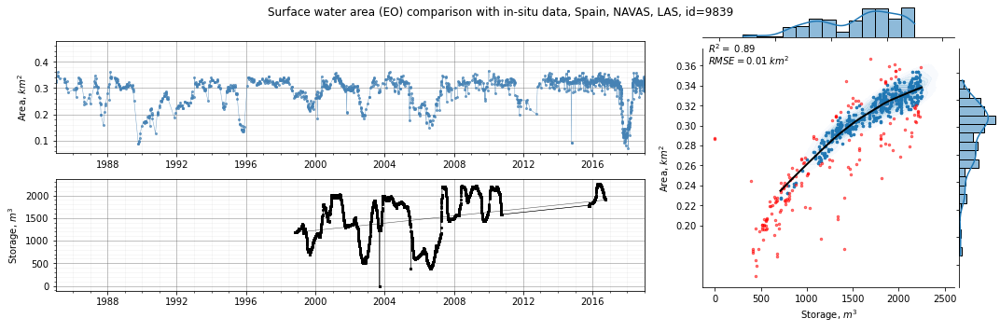

 86%|█████████████████████████████████████████████████████████████████████           | 270/313 [13:10<01:42,  2.39s/it]

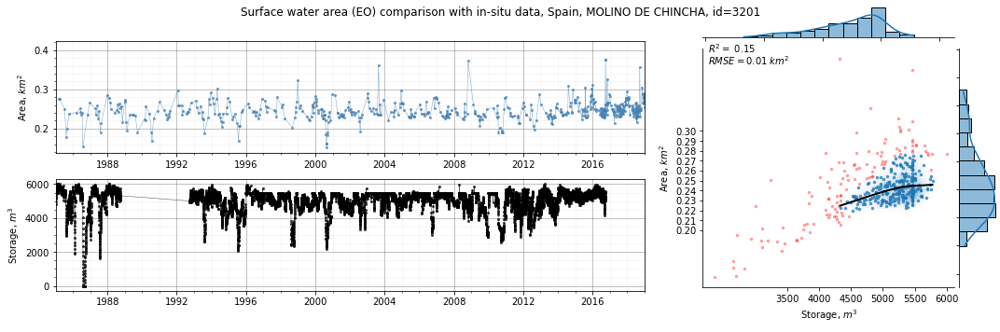

 87%|█████████████████████████████████████████████████████████████████████▎          | 271/313 [13:12<01:34,  2.26s/it]

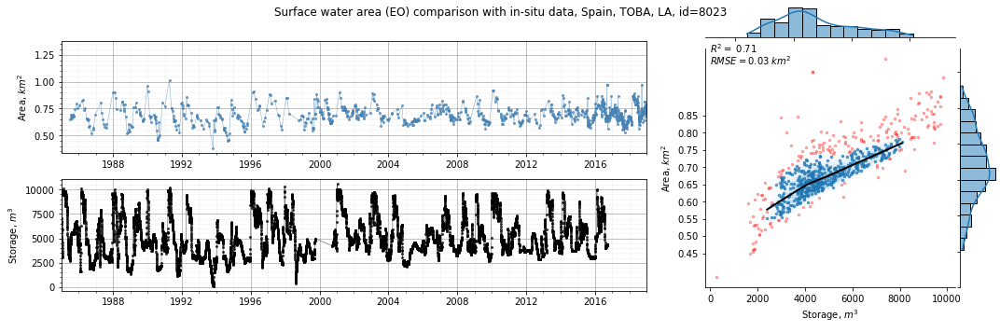

 87%|█████████████████████████████████████████████████████████████████████▌          | 272/313 [13:14<01:33,  2.27s/it]

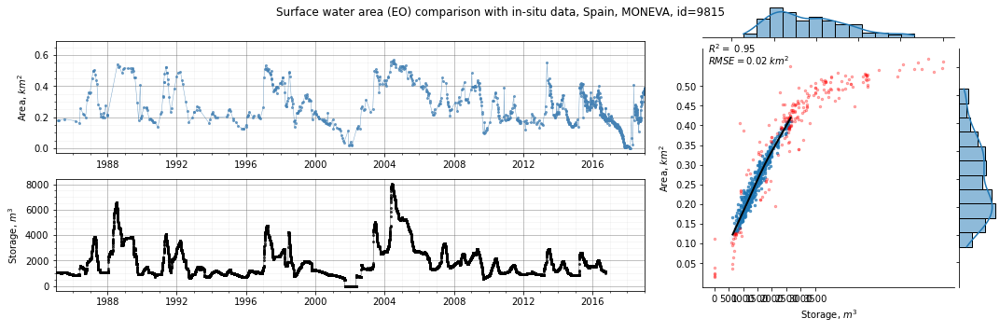

 87%|█████████████████████████████████████████████████████████████████████▊          | 273/313 [13:17<01:32,  2.31s/it]

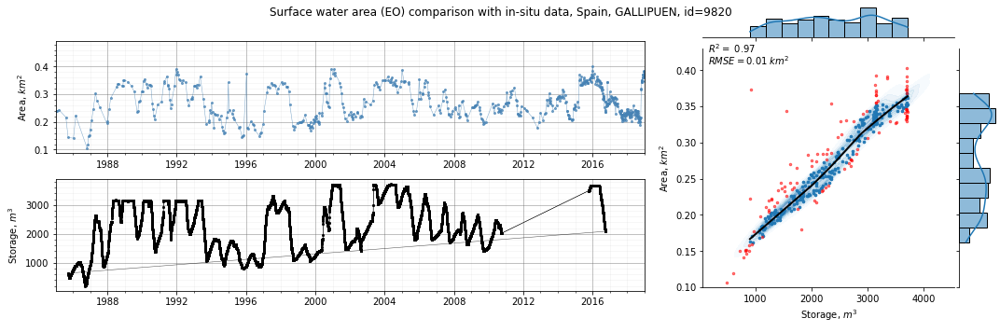

 88%|██████████████████████████████████████████████████████████████████████          | 274/313 [13:19<01:32,  2.38s/it]

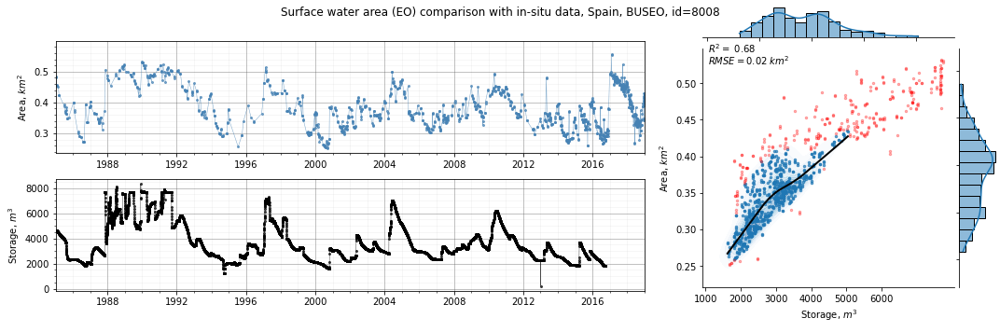

 88%|██████████████████████████████████████████████████████████████████████▎         | 275/313 [13:22<01:31,  2.41s/it]

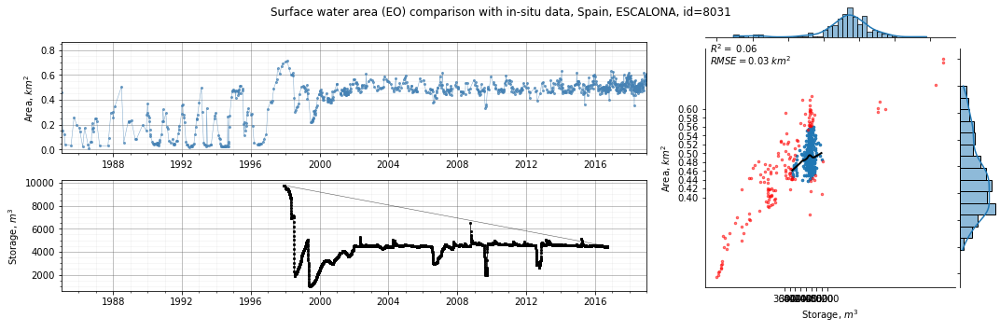

 88%|██████████████████████████████████████████████████████████████████████▌         | 276/313 [13:24<01:28,  2.40s/it]

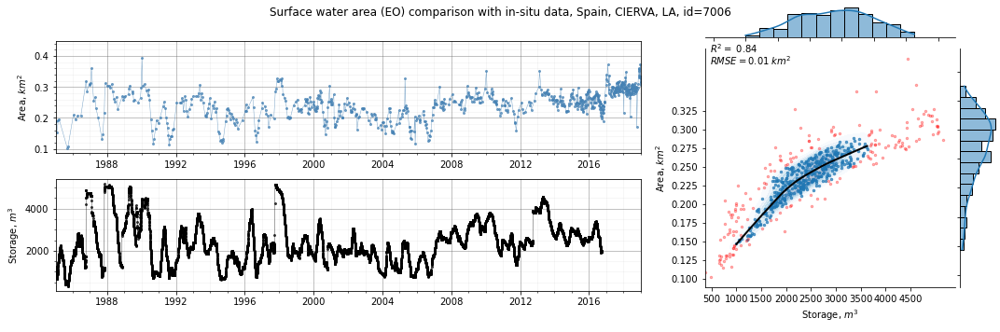

 88%|██████████████████████████████████████████████████████████████████████▊         | 277/313 [13:26<01:24,  2.36s/it]

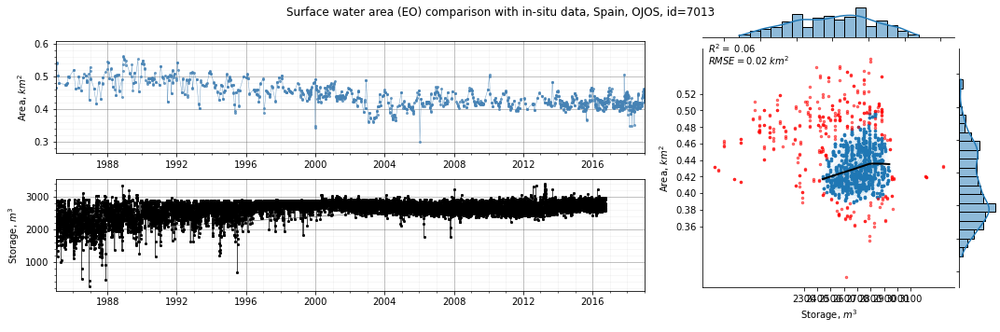

 89%|███████████████████████████████████████████████████████████████████████         | 278/313 [13:30<01:32,  2.63s/it]

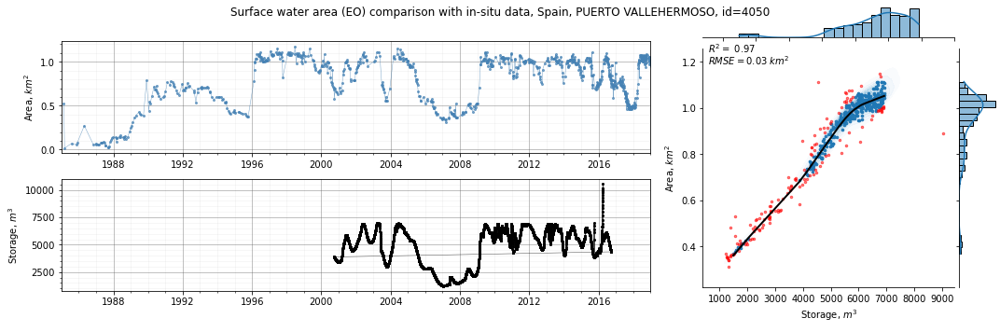

 89%|███████████████████████████████████████████████████████████████████████▎        | 279/313 [13:32<01:29,  2.62s/it]

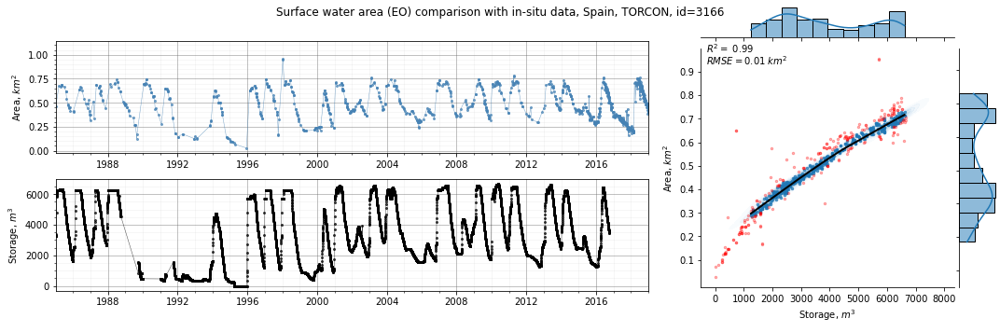

 89%|███████████████████████████████████████████████████████████████████████▌        | 280/313 [13:35<01:26,  2.63s/it]

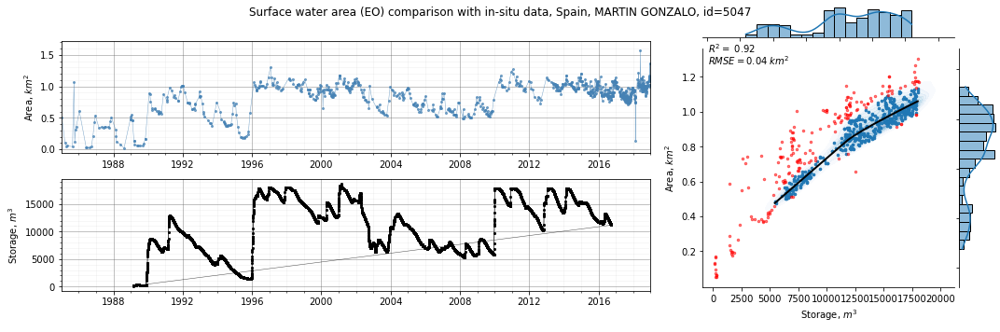

 90%|███████████████████████████████████████████████████████████████████████▊        | 281/313 [13:38<01:26,  2.71s/it]

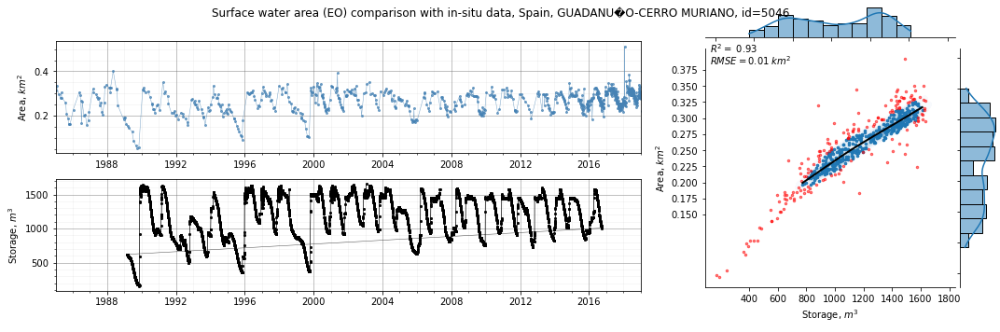

 90%|████████████████████████████████████████████████████████████████████████        | 282/313 [13:41<01:23,  2.70s/it]

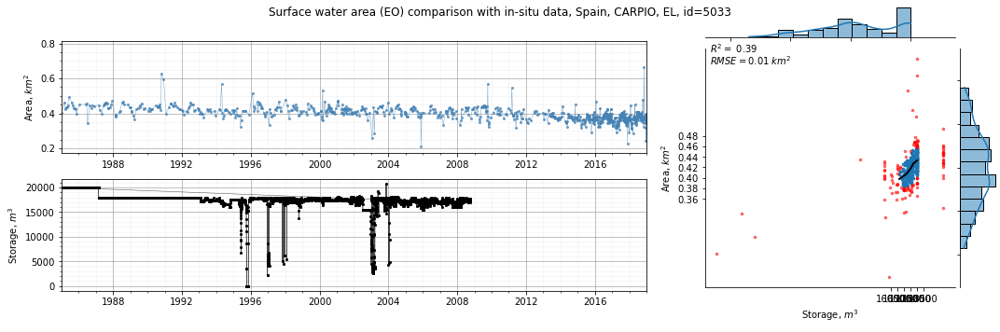

 90%|████████████████████████████████████████████████████████████████████████▎       | 283/313 [13:43<01:17,  2.59s/it]

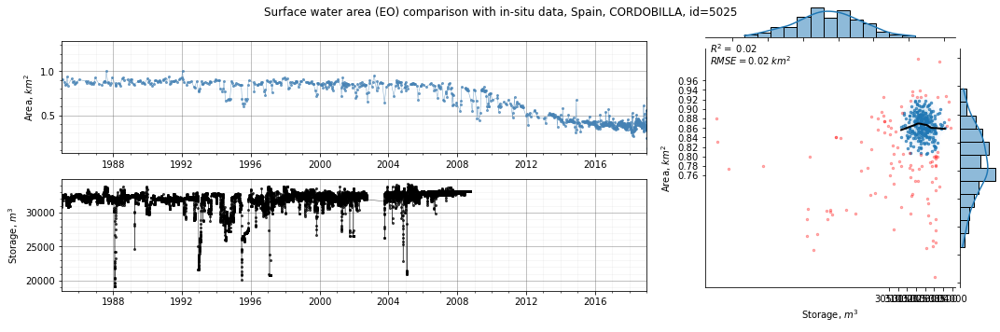

 91%|████████████████████████████████████████████████████████████████████████▌       | 284/313 [13:45<01:10,  2.42s/it]

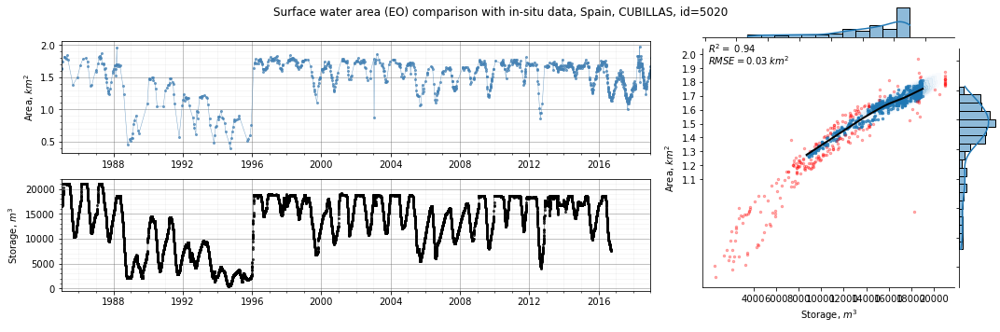

 91%|████████████████████████████████████████████████████████████████████████▊       | 285/313 [13:47<01:08,  2.45s/it]

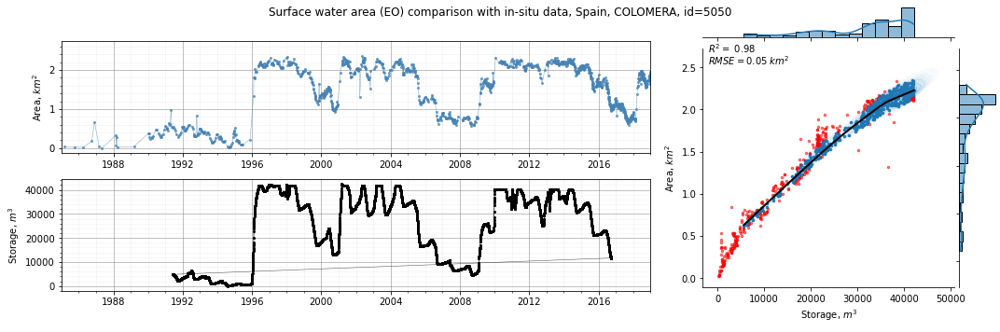

 91%|█████████████████████████████████████████████████████████████████████████       | 286/313 [13:51<01:17,  2.88s/it]

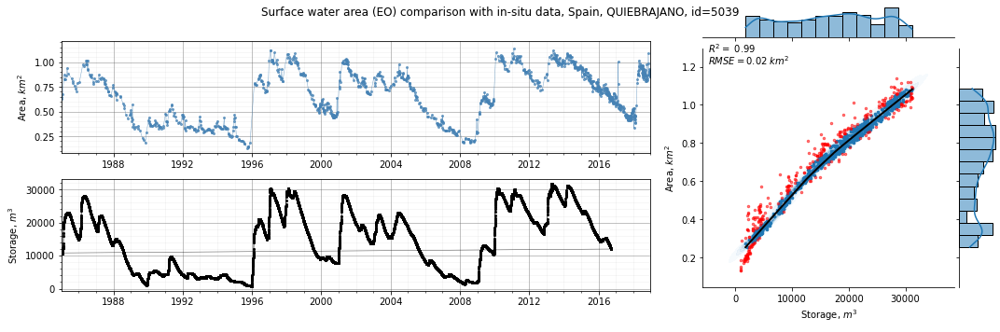

 92%|█████████████████████████████████████████████████████████████████████████▎      | 287/313 [13:55<01:24,  3.26s/it]

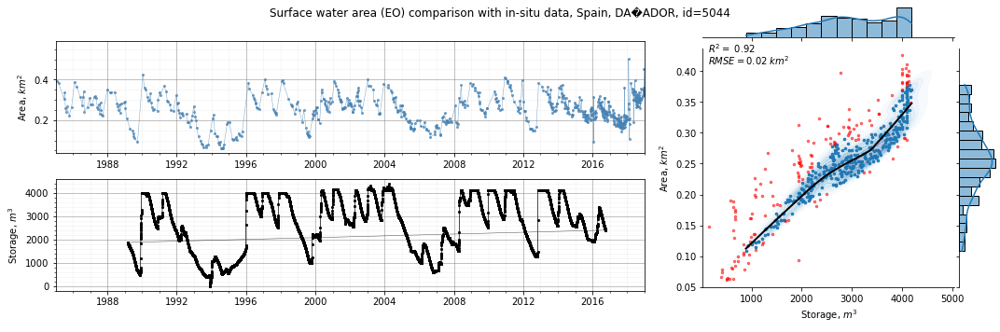

 92%|█████████████████████████████████████████████████████████████████████████▌      | 288/313 [13:58<01:18,  3.13s/it]

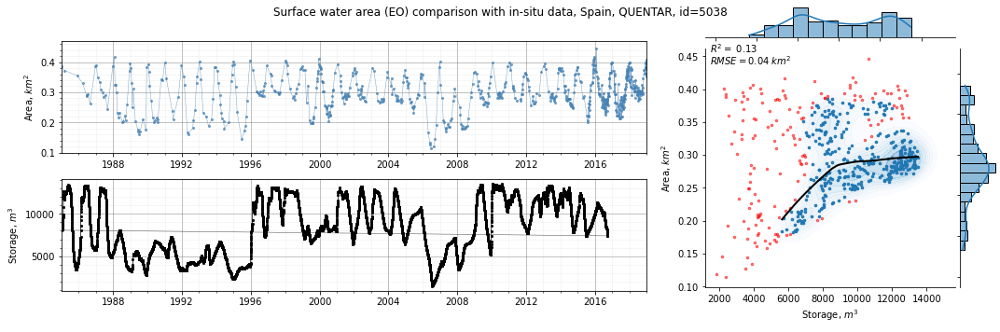

 92%|█████████████████████████████████████████████████████████████████████████▊      | 289/313 [14:01<01:13,  3.06s/it]

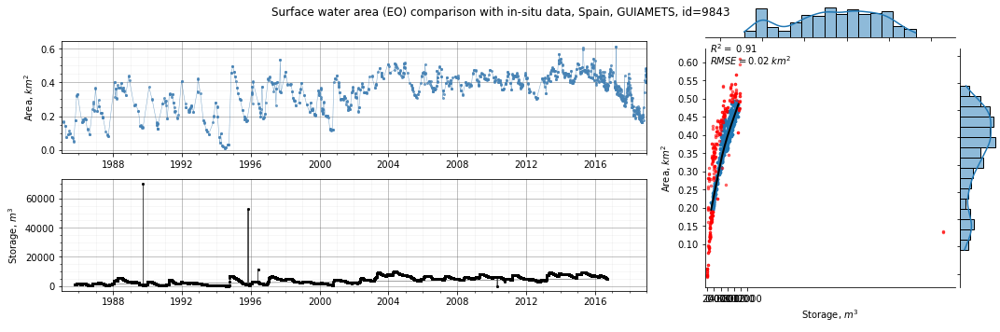

 93%|██████████████████████████████████████████████████████████████████████████      | 290/313 [14:05<01:13,  3.20s/it]

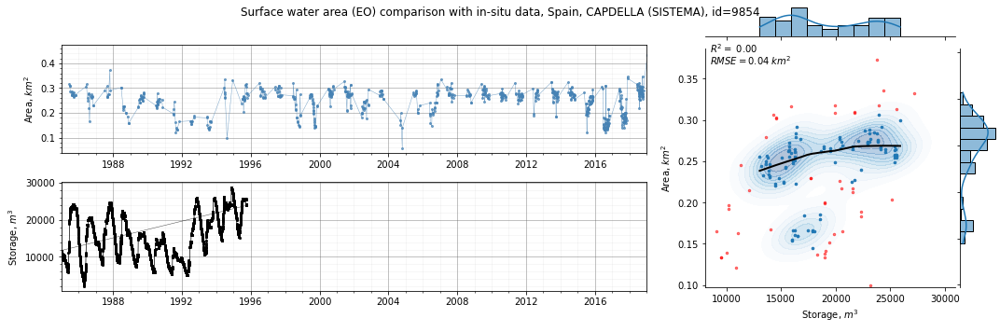

 93%|██████████████████████████████████████████████████████████████████████████▍     | 291/313 [14:07<01:03,  2.87s/it]

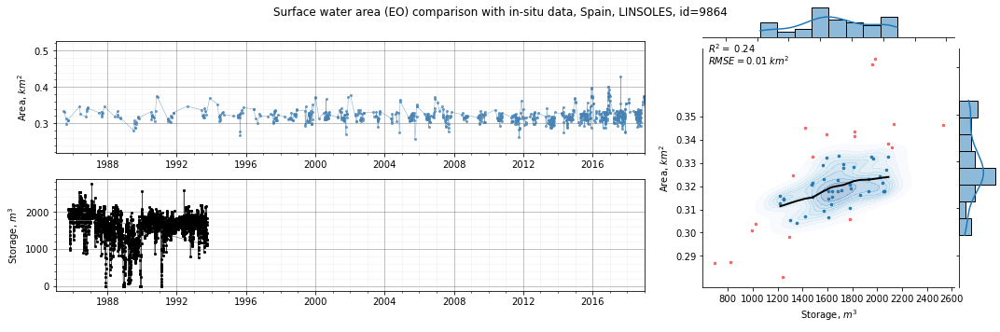

 93%|██████████████████████████████████████████████████████████████████████████▋     | 292/313 [14:09<00:54,  2.58s/it]

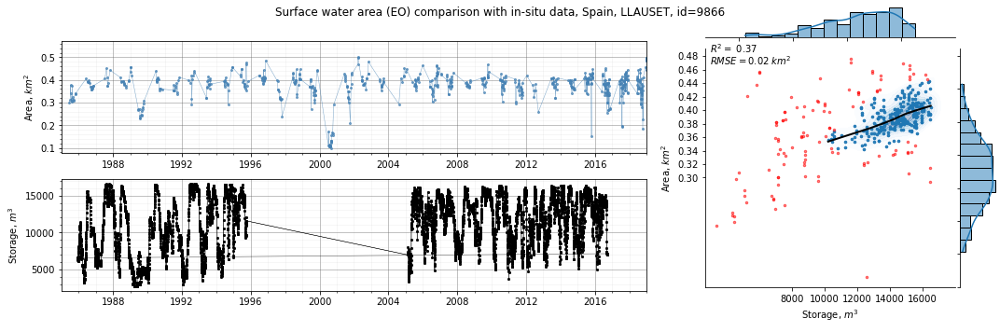

 94%|██████████████████████████████████████████████████████████████████████████▉     | 293/313 [14:11<00:51,  2.57s/it]

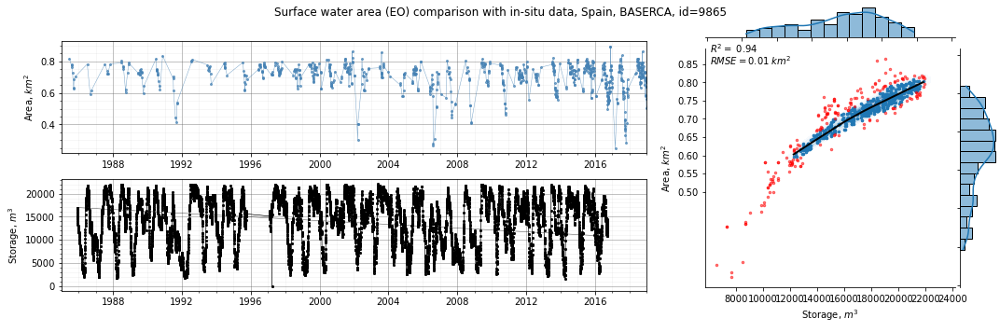

 94%|███████████████████████████████████████████████████████████████████████████▏    | 294/313 [14:14<00:52,  2.75s/it]

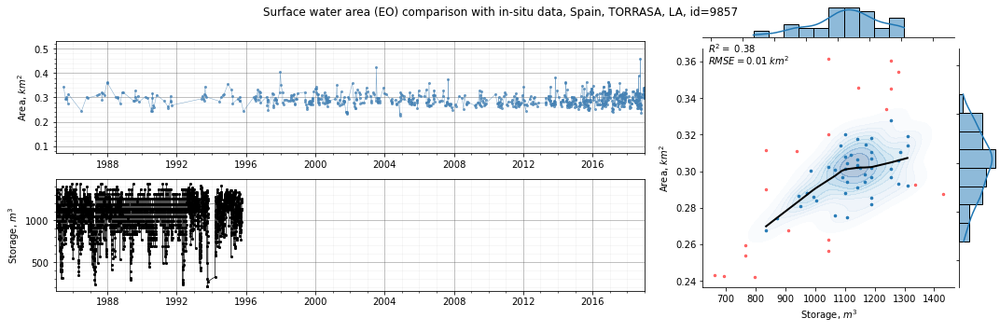

 94%|███████████████████████████████████████████████████████████████████████████▍    | 295/313 [14:17<00:45,  2.55s/it]c:\opt\miniconda3\envs\work\lib\site-packages\statsmodels\nonparametric\smoothers_lowess.py:165: RuntimeWarning: invalid value encountered in true_divide
  res = _lowess(y, x, frac=frac, it=it, delta=delta)
 95%|███████████████████████████████████████████████████████████████████████████▋    | 296/313 [14:17<00:31,  1.87s/it]

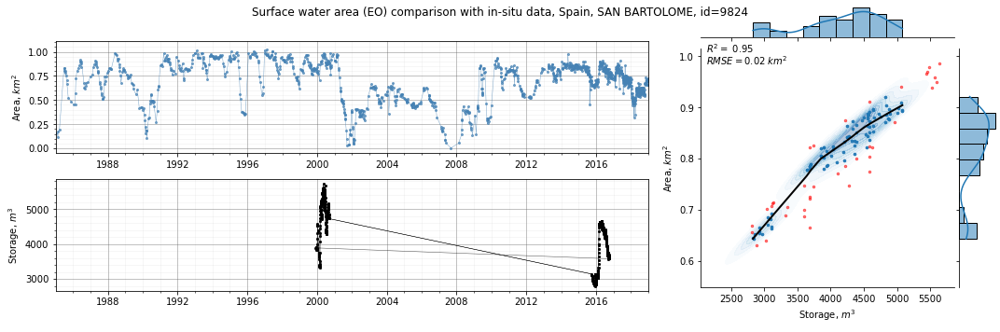

 95%|███████████████████████████████████████████████████████████████████████████▉    | 297/313 [14:19<00:30,  1.91s/it]

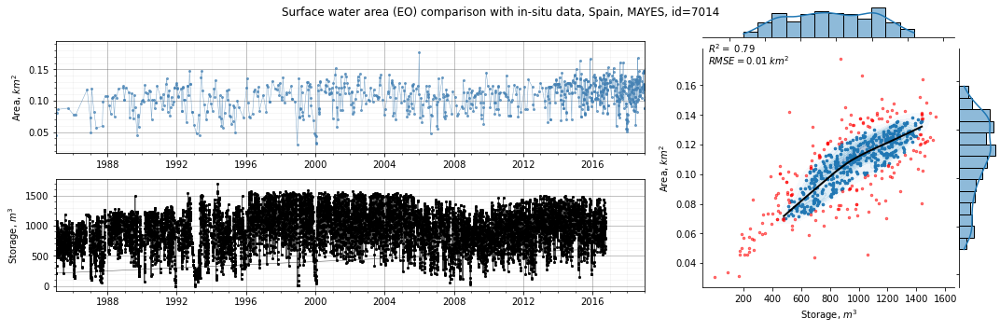

 95%|████████████████████████████████████████████████████████████████████████████▏   | 298/313 [14:22<00:34,  2.28s/it]

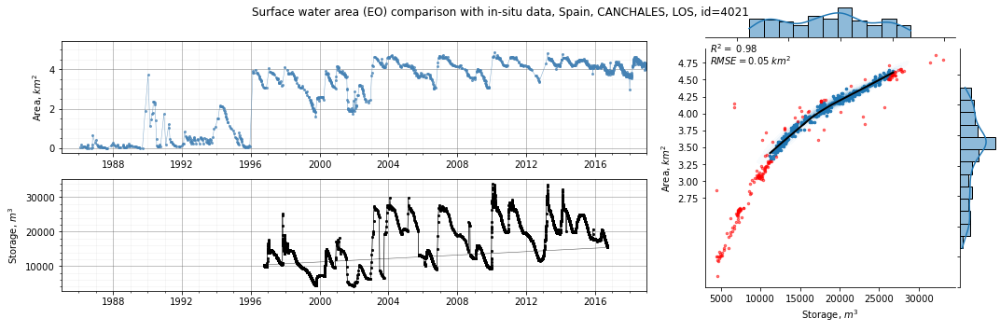

 96%|████████████████████████████████████████████████████████████████████████████▍   | 299/313 [14:25<00:34,  2.47s/it]

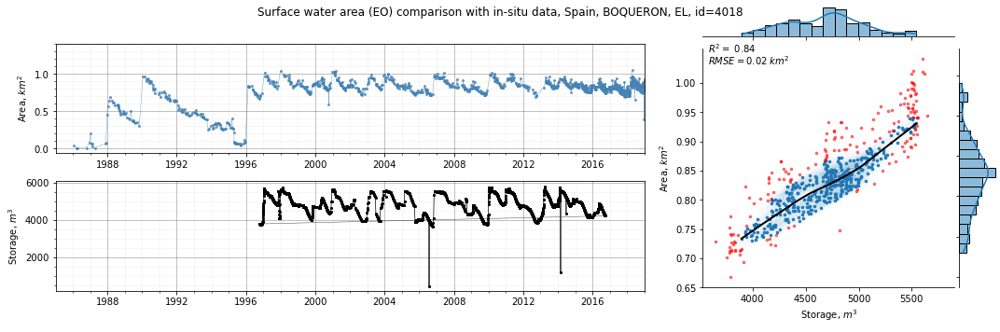

 96%|████████████████████████████████████████████████████████████████████████████▋   | 300/313 [14:28<00:32,  2.53s/it]

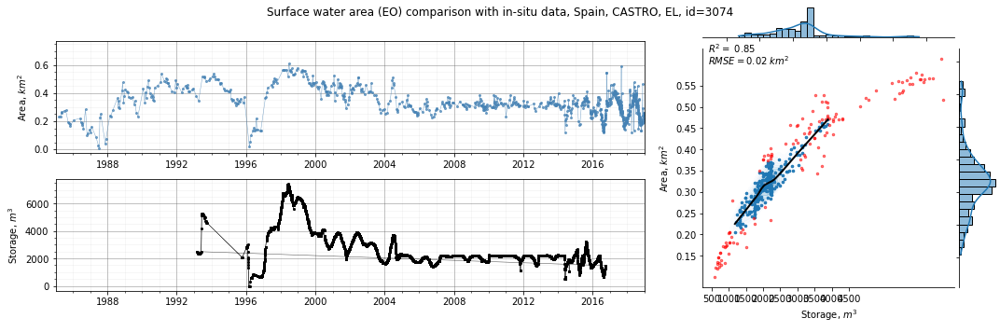

 96%|████████████████████████████████████████████████████████████████████████████▉   | 301/313 [14:30<00:30,  2.53s/it]

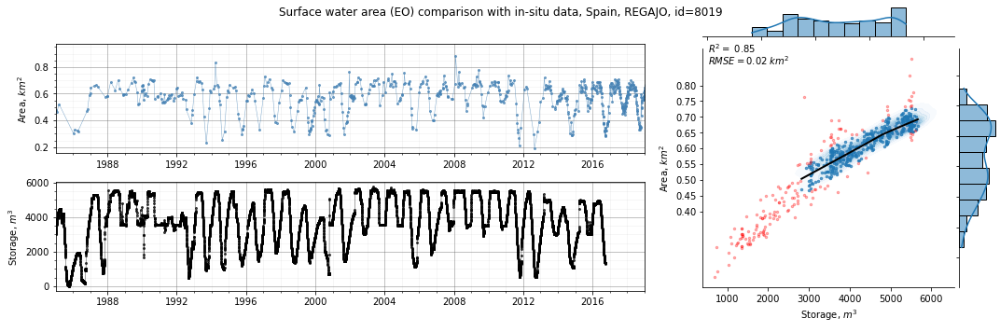

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 302/313 [14:32<00:27,  2.48s/it]

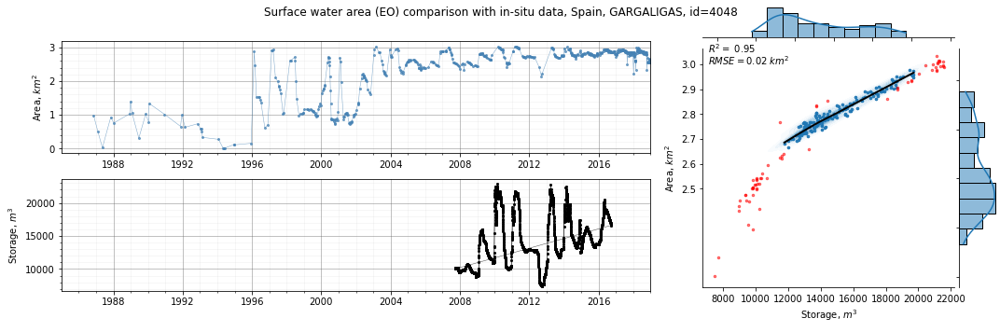

 97%|█████████████████████████████████████████████████████████████████████████████▍  | 303/313 [14:35<00:24,  2.40s/it]

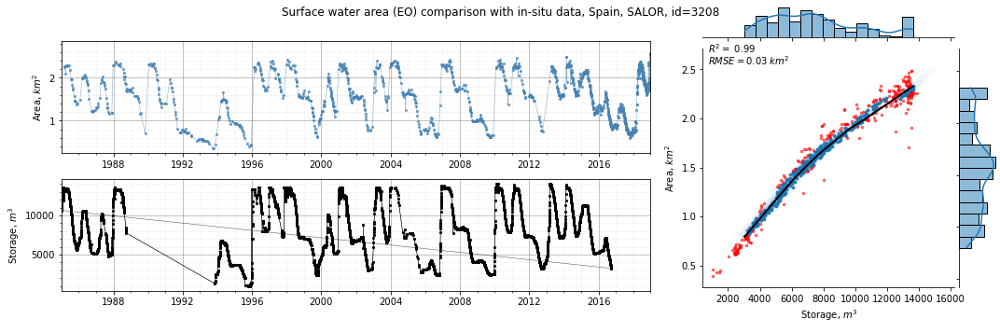

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 304/313 [14:39<00:25,  2.84s/it]

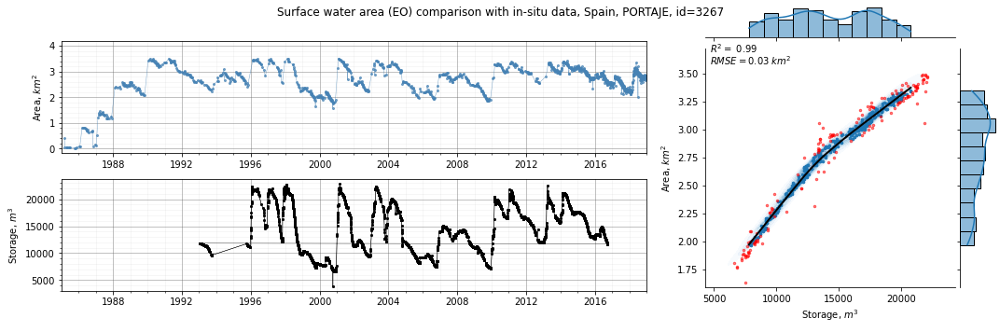

 97%|█████████████████████████████████████████████████████████████████████████████▉  | 305/313 [14:41<00:22,  2.85s/it]

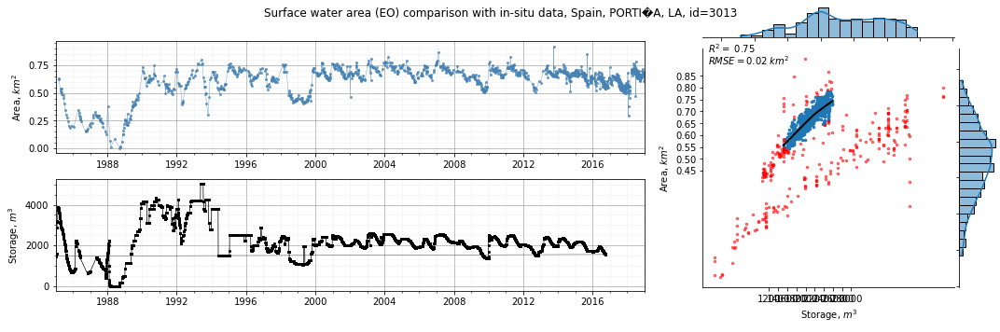

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 306/313 [14:45<00:21,  3.05s/it]

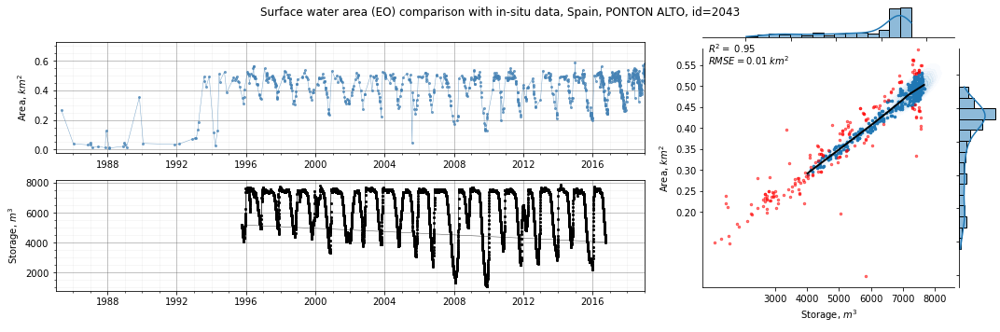

 98%|██████████████████████████████████████████████████████████████████████████████▍ | 307/313 [14:48<00:18,  3.03s/it]

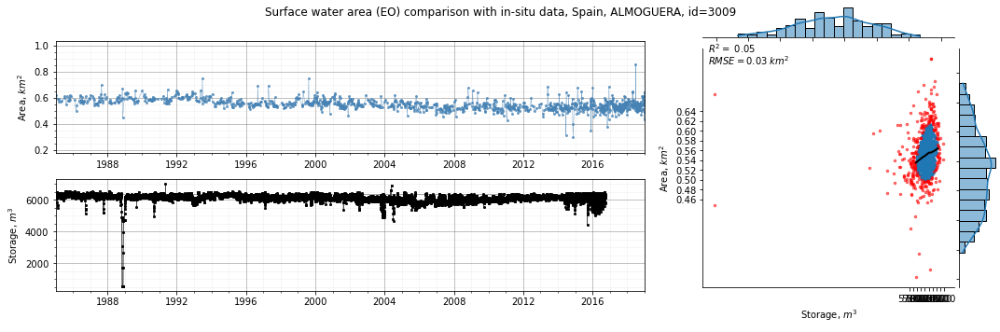

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 308/313 [14:51<00:15,  3.09s/it]

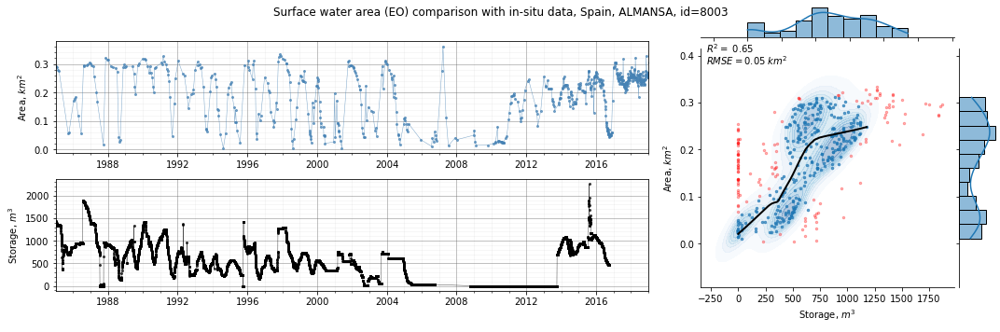

 99%|██████████████████████████████████████████████████████████████████████████████▉ | 309/313 [14:53<00:11,  2.83s/it]

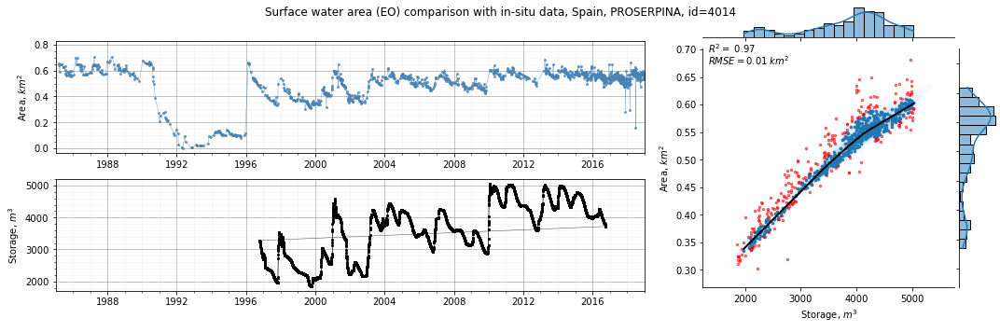

 99%|███████████████████████████████████████████████████████████████████████████████▏| 310/313 [14:57<00:09,  3.01s/it]

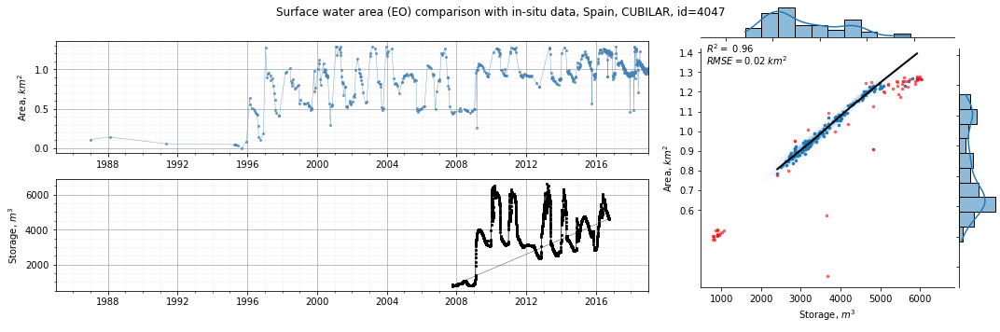

 99%|███████████████████████████████████████████████████████████████████████████████▍| 311/313 [14:59<00:05,  2.75s/it]

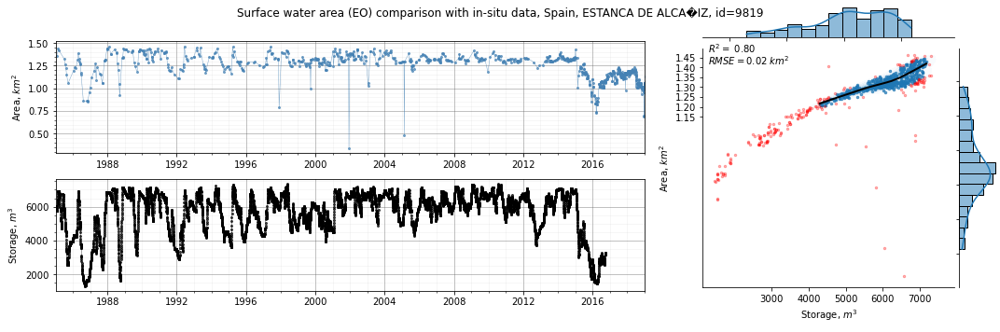

100%|███████████████████████████████████████████████████████████████████████████████▋| 312/313 [15:01<00:02,  2.67s/it]

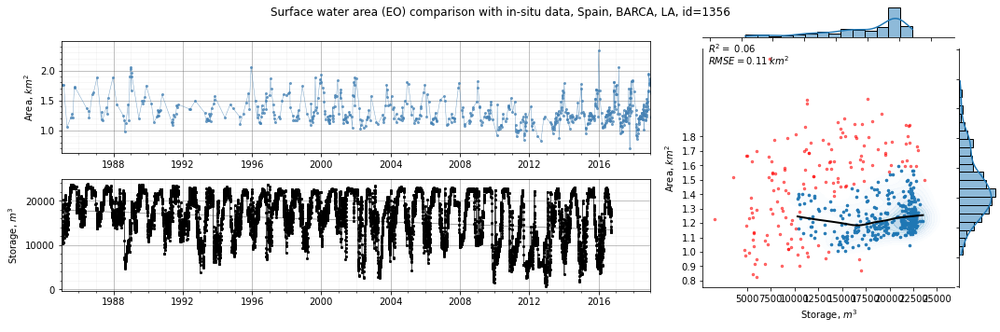

100%|████████████████████████████████████████████████████████████████████████████████| 313/313 [15:04<00:00,  2.89s/it]


In [66]:
# export all
for reservoir_name in tqdm(settings['reservoir_names']):
    try:
        reservoir_index = settings['reservoir_names'].index(reservoir_name)
        plot(reservoir_index, settings['features'][reservoir_index], True, True)
    except:
        continue

In [139]:
reservoir_locations = list(fiona.open('../data/shp/reservoirs-locations-v1.0.shp'))

reservoir_location_by_fid = {}

for f in reservoir_locations:
    reservoir_location_by_fid[f['properties']['fid']] = f['geometry']

In [140]:
# merge GeoJSON files exported for different countries

files = [
    r'..\data\insitu-data\shp\Spain\reservoir_centers_with_stats.geojson',
    r'..\data\insitu-data\shp\SouthAfrica\reservoir_centers_with_stats.geojson',
    r'..\data\insitu-data\shp\India\reservoir_centers_with_stats.geojson',
    r'..\data\insitu-data\shp\USA\reservoir_centers_with_stats.geojson'
]

feature_collection = {
    "type": "FeatureCollection",
    "name": "reservoir_centers",
    "features": []
}

features = []
for f in files:
    for feature in json.load(open(f))['features']:
        f = {
            "type": "Feature",
            'geometry': reservoir_location_by_fid[feature['properties']['fid']],
            'properties': {
                'fid': feature['properties']['fid'],
                'station': feature['properties']['filename'],
                'filename': f"timeseries/timeseries_{feature['properties']['site']}/{feature['properties']['filename']}_validation.png",
                'var': feature['properties']['insitu_var'],
                'var_label': feature['properties']['insitu_var_label'],
                'r2': feature['properties']['r2'],
                'r2_fit': feature['properties']['r2_fit']
            }
        }
        
        features.append(f)
    
print(len(features))
    
feature_collection['features'] = features
json.dump(feature_collection, open(r'..\data\insitu-data\shp\reservoirs-locations-validation-v10.geojson', 'w'))

799


In [128]:
# convert images to b64 (due to EE limitations)
image_files = list(pathlib.Path(r'..\data\insitu-data\timeseries').glob(r'*\*.png'))

for path_in in tqdm(image_files):
    path_out = path_in.parent / (path_in.stem + '.b64')
    
    with open(path_in, 'rb') as image_file:
        encoded_string = base64.b64encode(image_file.read())
        with open(path_out, 'w') as b64_file:
            b64_file.write(encoded_string.decode("ascii"))

  0%|          | 0/797 [00:00<?, ?it/s]